In [ ]:
import pandas as pd
import numpy as np
import ast
from rdkit import Chem
from rdkit.Chem import AllChem, DataStructs
import os
import matplotlib.pyplot as plt
import seaborn as sns
from plinder_analysis_utils import DockingAnalysisBase, PoseBustersAnalysis, PropertyAnalysis


## Load Data

In [2]:
PLINDER_TEST_COLUMNS = [
    "system_id", "ligand_smiles",
    # binary 
    "ligand_is_covalent", "ligand_is_ion", "ligand_is_cofactor", "ligand_is_artifact",
    # discrete
    "system_num_protein_chains",
    "ligand_num_rot_bonds", "ligand_num_hbd", "ligand_num_hba", "ligand_num_rings",
    # continuous
    "entry_resolution", "entry_validation_molprobity", 
    "system_num_pocket_residues", "system_num_interactions",
    "ligand_molecular_weight", "ligand_crippen_clogp", 
    "ligand_num_interacting_residues", "ligand_num_neighboring_residues", "ligand_num_interactions",
]
# Create category mapping for visualization
CATEGORY_MAPPING = {
    "ligand_is_covalent": "binary",
    "ligand_is_ion": "binary",
    "ligand_is_cofactor": "binary",
    "ligand_is_artifact": "binary",
    "system_num_protein_chains": "discrete",
    "ligand_num_rot_bonds": "continuous",    
    "ligand_num_hbd": "continuous",
    "ligand_num_hba": "continuous",
    "ligand_num_rings": "discrete",
    "entry_resolution": "continuous",
    "entry_validation_molprobity": "continuous",
    "system_num_pocket_residues": "continuous",
    "system_num_interactions": "continuous",
    "ligand_molecular_weight": "continuous",
    "ligand_crippen_clogp": "continuous",
    "ligand_num_interacting_residues": "continuous",
    "ligand_num_neighboring_residues": "continuous",
    "ligand_num_interactions": "continuous",
    "ligand_is_artifact": "binary"         
}

In [3]:
from Approach import DiffDockApproach, DiffDockPocketApproach, GninaApproach, SurfDockApproach, ICMApproach, ChaiApproach
exp_name = "plinder_set_0"
approaches = [
    DiffDockApproach(),
    DiffDockPocketApproach(),
    GninaApproach(),
    SurfDockApproach(),
    ICMApproach(),
    ChaiApproach(),
]
df_all = []
for approach in approaches:
    method_name = approach.get_name()
    print(method_name)
    df_method  = pd.read_csv(f"{method_name}_{exp_name}_results.csv")
    print(df_method.shape)
    df_all.append(df_method)

df_combined = pd.concat(df_all, ignore_index=True)
print(df_combined.shape)

diffdock
(3575, 129)
diffdock_pocket_only
(4660, 130)
gnina
(5160, 130)
surfdock
(4216, 130)
icm
(5050, 129)
chai-1
(4580, 130)
(27241, 130)


/var/folders/bb/dyy85zps4_lg79d6g6g48ms00000gn/T/ipykernel_13737/1426488577.py:15: DtypeWarning: Columns (76) have mixed types. Specify dtype option on import or set low_memory=False.
  df_method  = pd.read_csv(f"{method_name}_{exp_name}_results.csv")
/var/folders/bb/dyy85zps4_lg79d6g6g48ms00000gn/T/ipykernel_13737/1426488577.py:15: DtypeWarning: Columns (6,7,8,9,32,33,34,35,36,37,38,39,40,76) have mixed types. Specify dtype option on import or set low_memory=False.
  df_method  = pd.read_csv(f"{method_name}_{exp_name}_results.csv")


In [ ]:
# get top 10 surfdock poses ranked by rmsd
df_combined[df_combined['method'] == 'surfdock'] \
    .sort_values(by='rmsd', ascending=False) \
    .head(10)[['protein', 'rmsd']]

,protein,rmsd
16805,7khx__1__1.B__1.E,673498.208906
15342,5fbc__1__1.A__1.E,19577.544870
15341,5fbc__1__1.A__1.E,7694.033984
15343,5fbc__1__1.A__1.E,5871.618307
15344,5fbc__1__1.A__1.E,1383.435231
15340,5fbc__1__1.A__1.E,709.635244
17098,8hq3__1__1.C__1.JA,13.701280
17132,6mcj__1__1.A__1.C,13.157408
17135,6mcj__1__1.A__1.C,13.061897
17131,6mcj__1__1.A__1.C,12.943928


In [ ]:
inputs_csv = pd.read_csv('./plidner_test_input.csv')
# Convert strings to lists using ast.literal_eval
inputs_csv['ion_paths'] = inputs_csv['ion_paths'].apply(
    lambda x: ast.literal_eval(x) if isinstance(x, str) else x
)
inputs_csv['has_ion'] = inputs_csv['ion_paths'].apply(lambda x: len(x) > 0 if isinstance(x, list) else False)
print(inputs_csv.shape)
inputs_csv.head()
test_annot_df = pd.read_csv('plinder_test.csv')
print(test_annot_df['system_id'].nunique())
print(test_annot_df.shape)
test_annot_df = test_annot_df[PLINDER_TEST_COLUMNS]

(1036, 18)
1036
(1436, 743)


/var/folders/bb/dyy85zps4_lg79d6g6g48ms00000gn/T/ipykernel_61641/674089288.py:9: DtypeWarning: Columns (205,211,214,304) have mixed types. Specify dtype option on import or set low_memory=False.
  test_annot_df = pd.read_csv('plinder_test.csv')


In [ ]:
test_annot_df.drop_duplicates(subset=['system_id', 'ligand_smiles'], inplace=True)
print(test_annot_df.shape)

# Filter rows where ligand_is_ion is True
ion_df = test_annot_df[test_annot_df['ligand_is_ion']]
# Inspect the result
print(f"Found {len(ion_df)} ion ligands:")
test_annot_df = test_annot_df[~test_annot_df['ligand_is_ion']]
print(test_annot_df['system_id'].shape)
print(test_annot_df['system_id'].nunique())

# test_annot_df = test_annot_df[~test_annot_df['ligand_is_cofactor']]
# print(test_annot_df['system_id'].shape)
# print(test_annot_df['system_id'].nunique())

# test_annot_df = test_annot_df[~test_annot_df['ligand_is_covalent']]
# print(test_annot_df['system_id'].shape)
# print(test_annot_df['system_id'].nunique())

test_annot_df = test_annot_df[~test_annot_df['ligand_is_artifact']]
print(test_annot_df['system_id'].shape)
print(test_annot_df['system_id'].nunique())


In [ ]:
# 0. ensure df_combined carries ligand_smile
df_combined['ligand_smile'] = df_combined['protein'].map(
    inputs_csv.set_index('system_id')['ligand_description']
)

# 1. find system_ids with >1 annotation row
dupe_ids = (
    test_annot_df['system_id']
    .loc[test_annot_df['system_id'].duplicated(keep=False)]
    .unique()
)

# 2. split df_combined
simple = df_combined.loc[~df_combined['protein'].isin(dupe_ids)]
dup    = df_combined.loc[ df_combined['protein'].isin(dupe_ids)]

# 3. merge simple cases on system_id only
merged_simple = simple.merge(
    test_annot_df.drop_duplicates('system_id'),
    left_on='protein',
    right_on='system_id',
    how='left',
    suffixes=('','_annot')
)

# 4. merge dup cases on (system_id,ligand_smile)
merged_dup = dup.merge(
    test_annot_df,
    left_on=['protein','ligand_smile'],
    right_on=['system_id','ligand_smiles'],
    how='left',
    suffixes=('','_annot')
)

# 5. recombine
df_merged = pd.concat([merged_simple, merged_dup], ignore_index=True)

print(df_merged.shape)
df_merged.head()
df_merged[PLINDER_TEST_COLUMNS].isnull().sum()

In [ ]:
# build a lookup of fingerprints for each (system_id, annotation_smiles)
test_annot_df['mol'] = test_annot_df['ligand_smiles'].map(Chem.MolFromSmiles)
test_annot_df['fp']  = test_annot_df['mol'].map(lambda m: AllChem.GetMorganFingerprintAsBitVect(m, 2, nBits=2048))

# function to find best‐match SMILES for a given row
def fuzzy_merge_row(row, candidates, threshold=0.85):
    mol = Chem.MolFromSmiles(row['ligand_smile'])
    if mol is None: return None
    fp = AllChem.GetMorganFingerprintAsBitVect(mol, 2, nBits=2048)
    best = None; best_score = threshold
    for idx, cand in candidates.iterrows():
        sim = DataStructs.TanimotoSimilarity(fp, cand['fp'])
        if sim > best_score:
            best_score, best = sim, idx
    return best

# identify rows in df_merged with null annotation
mask = df_merged['ligand_is_covalent'].isnull()  # pick any _annot column
rows = df_merged.loc[mask, ['protein','ligand_smile']].copy()

# for each, look up test‐annotations for that system_id and pick the best‐fingerprint match
for i, r in rows.iterrows():
    candidates = test_annot_df[test_annot_df['system_id']==r['protein']]
    match_idx = fuzzy_merge_row(r, candidates)
    if match_idx is not None:
        # copy in the missing _annot columns from that test_annot_df row
        for c in PLINDER_TEST_COLUMNS[2:]:
            df_merged.at[i, c+'_annot'] = test_annot_df.at[match_idx, c]

# clean up helper cols
test_annot_df.drop(columns=['mol','fp'], inplace=True)
df_merged[PLINDER_TEST_COLUMNS].isnull().sum()

In [ ]:
# Drop any row where *all* of the PLINDER_TEST_COLUMNS are null
df_merged = df_merged.dropna(
    subset=PLINDER_TEST_COLUMNS,
    how='all'
)

print(df_merged.shape)
df_merged.head()
df_merged[PLINDER_TEST_COLUMNS].isnull().sum()

In [ ]:
df_merged.to_csv('plinder_test_merged.csv', index=False)

In [ ]:
# 0. add ligand_smile from inputs_csv into df_combined
df_combined['ligand_smile'] = df_combined['protein'].map(
    inputs_csv.set_index('system_id')['ligand_description']
)
allowed = (
    df_combined[['protein','ligand_smile']]
    .drop_duplicates()
    .rename(columns={'protein':'system_id','ligand_smile':'ligand_smiles'})
)

df_merged = pd.merge(
    df_combined,
    test_annot_df.drop_duplicates(subset=['system_id']),
    left_on=['protein'],
    right_on=['system_id'],
    how='left',
)

print(df_merged.shape)
df_merged[PLINDER_TEST_COLUMNS].isnull().sum()

In [ ]:
from rdkit import Chem

def canonical_smiles(smi):
    try:
        mol = Chem.MolFromSmiles(smi)
        return Chem.MolToSmiles(mol, isomericSmiles=True) if mol else None
    except:
        return None

# 0. add ligand_smile from inputs_csv into df_combined
df_combined['ligand_smile'] = df_combined['protein'].map(
    inputs_csv.set_index('system_id')['ligand_description']
)

# 1. Add a canonical‐SMILES column to both dataframes
test_annot_df['canonical_smiles'] = test_annot_df['ligand_smiles'].map(canonical_smiles)
df_combined['canonical_smiles'] = df_combined['ligand_smile'].map(canonical_smiles)

# 2. Deduplicate the annotations by (system_id, canonical_smiles)
test_annot_unique = test_annot_df.drop_duplicates(['system_id', 'canonical_smiles'])

# 3. Pick the annotation columns to merge in, EXCLUDING the join keys
cols_to_merge = [
    c for c in test_annot_unique.columns
    if c not in ('system_id', 'ligand_smiles', 'canonical_smiles')
]

# 4. Merge on protein↔system_id and canonical_smiles
df_combined = df_combined.merge(
    test_annot_unique[['system_id', 'canonical_smiles'] + cols_to_merge],
    left_on=['protein', 'canonical_smiles'],
    right_on=['system_id', 'canonical_smiles'],
    how='left',
    suffixes=('', '_annot')
)

# 5. Clean up helper columns
df_combined.drop(columns=['canonical_smiles'], inplace=True)


In [ ]:
df_combined[cols_to_merge].isnull().sum()

In [ ]:
df_combined[df_combined['ligand_smile'] == 'NC(=O)C1=CN([C@@H]2O[C@H](CO[P@](=O)(O)O[P@@](=O)(O)OC[C@H]3O[C@@H](n4cnc5c(N)ncnc54)[C@H](O)[C@@H]3O)[C@@H](O)[C@H]2O)C=CC1']

In [ ]:
test_annot_df['canonical_smiles'] = test_annot_df['ligand_smiles'].map(canonical_smiles)
inputs_csv['canonical_smiles'] = inputs_csv['ligand_description'].map(canonical_smiles)

In [ ]:
print(test_annot_df['ligand_smiles'].nunique(), inputs_csv['ligand_description'].nunique())
print(len(set(test_annot_df['ligand_smiles']).intersection(set(inputs_csv['ligand_description']))))
print(list((set(test_annot_df['canonical_smiles']).difference(set(inputs_csv['canonical_smiles']))))[:1])

In [ ]:
# create a boolean mask for SMILES shorter than 10 characters
short_smiles_mask = test_annot_df['ligand_smiles'].str.len() < 7

# count them
short_smiles_count = short_smiles_mask.sum()
print(f"Number of rows with ligand_smiles length < 7: {short_smiles_count}")
# print the rows with short SMILES
print(test_annot_df[short_smiles_mask]['ligand_smiles'])

In [ ]:
# Identify columns with "smile" in their name
smile_cols = [col for col in test_annot_df.columns if 'smile' in col.lower()]
print("Columns containing 'smile':", smile_cols)

# Subset the dataframe to only those columns
test_annot_df[smile_cols].head()
# Find rows where the SMILES columns are not all identical
smile_cols = ['ligand_smiles', 'ligand_resolved_smiles', '']
mask = test_annot_df[smile_cols].nunique(axis=1) > 1
diff_smiles_df = test_annot_df.loc[mask, smile_cols + ['system_id']]
print(f"Found {len(diff_smiles_df)} rows with differing SMILES:")
diff_smiles_df

In [7]:
# Load the Processed DataFrame
df_combined = pd.read_csv('plinder_test_combined.csv')
"has_ion" in df_combined.columns

/var/folders/bb/dyy85zps4_lg79d6g6g48ms00000gn/T/ipykernel_13737/3334273249.py:2: DtypeWarning: Columns (75,129) have mixed types. Specify dtype option on import or set low_memory=False.
  df_combined = pd.read_csv('plinder_test_combined.csv')


## PB Analysis

Method: diffdock_pocket_only
Total proteins: 919
Success rate (RMSD ≤ 2.0Å): 47.23%


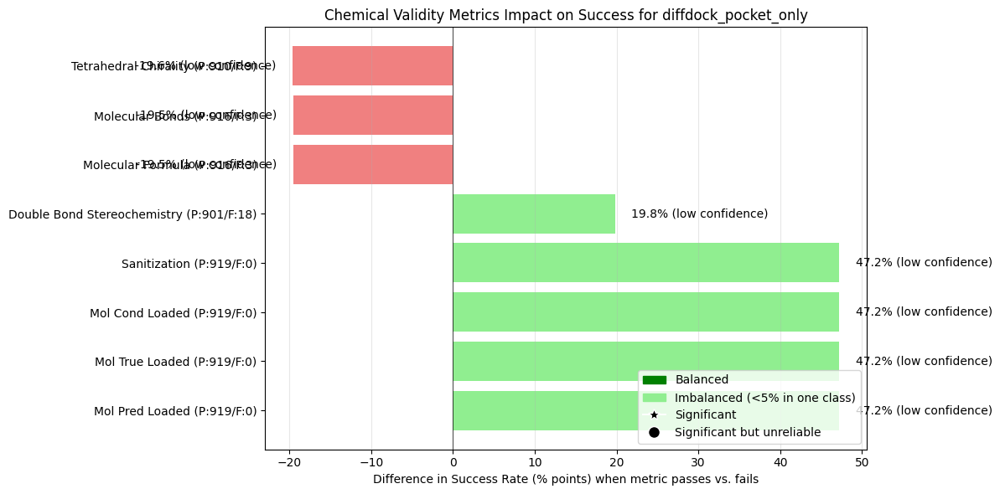

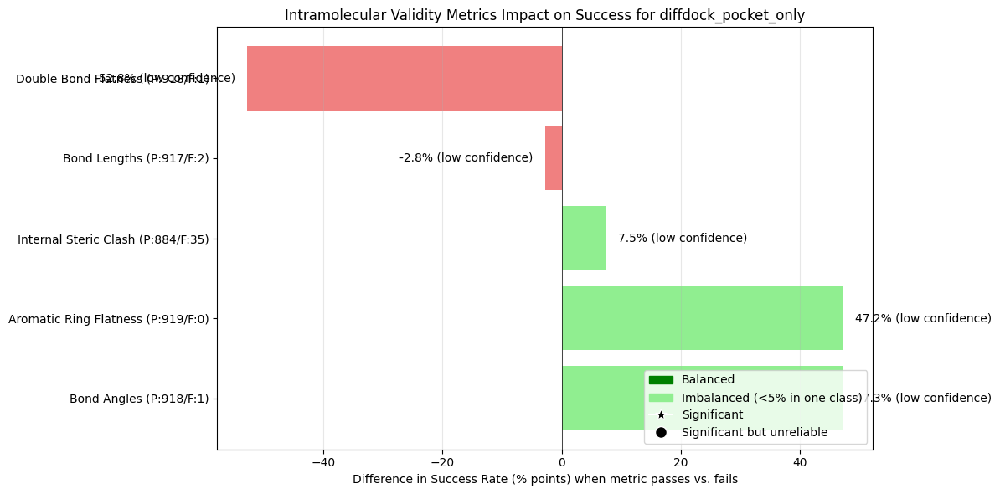

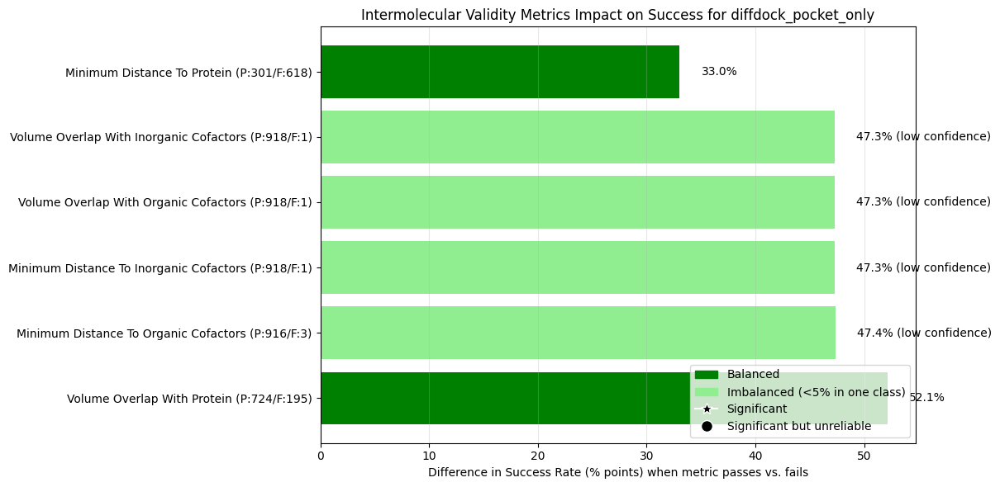


Metrics with significant impact on success rate:

Chemical Validity: No significant metrics found

Intramolecular Validity: No significant metrics found

Intermolecular Validity: No significant metrics found

Note: The following metrics have severe class imbalance (one class < 5% of data):
- mol_pred_loaded: Only 0 samples (0.00%) fail this metric
- mol_true_loaded: Only 0 samples (0.00%) fail this metric
- mol_cond_loaded: Only 0 samples (0.00%) fail this metric
- sanitization: Only 0 samples (0.00%) fail this metric
- molecular_formula: Only 3 samples (0.33%) fail this metric
- molecular_bonds: Only 3 samples (0.33%) fail this metric
- tetrahedral_chirality: Only 9 samples (0.98%) fail this metric
- double_bond_stereochemistry: Only 18 samples (1.96%) fail this metric
- bond_lengths: Only 2 samples (0.22%) fail this metric
- bond_angles: Only 1 samples (0.11%) fail this metric
- internal_steric_clash: Only 35 samples (3.81%) fail this metric
- aromatic_ring_flatness: Only 0 samples 

In [3]:
# Initialize the analysis object
analysis = PoseBustersAnalysis(df_combined)

# Analyze a single method with default RMSD threshold of 2.0Å
single_method_results = analysis.analyze_single_method(
    method="diffdock_pocket_only",
    rmsd_threshold=2.0,
    imbalance_threshold=0.05,
    plot=True  # Generate visualization plots
)

# Access the results
success_rate = single_method_results['overall_success_rate']
significant_metrics = single_method_results['significant_metrics']

Analyzing PoseBusters metrics for 130 cases where all methods succeed
and 66 cases where all methods fail


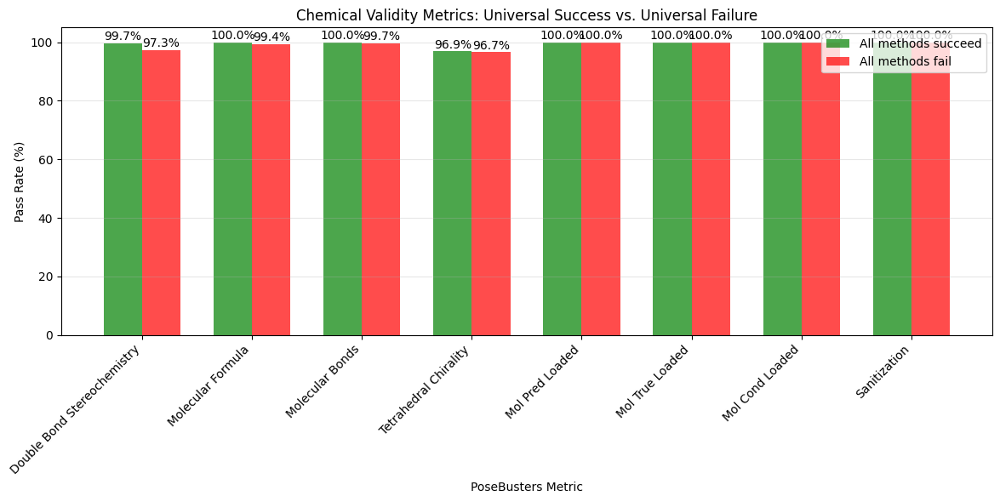

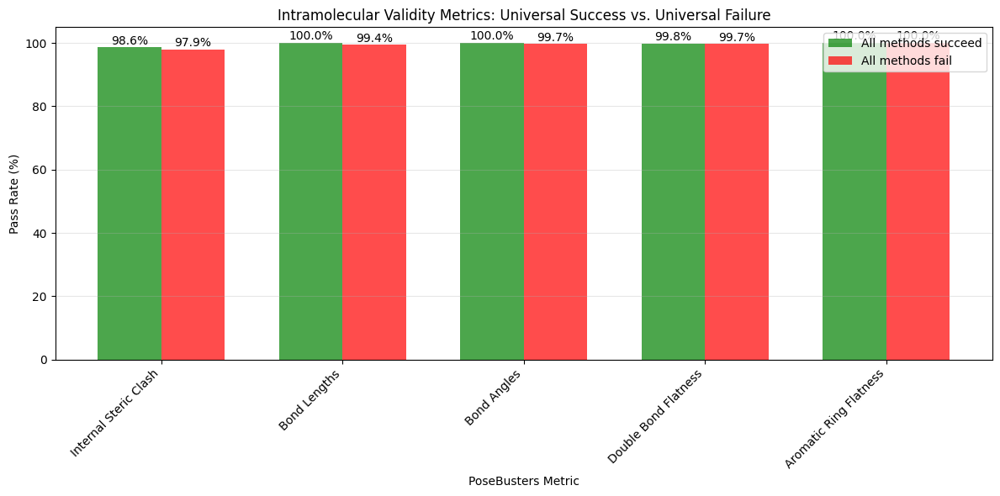

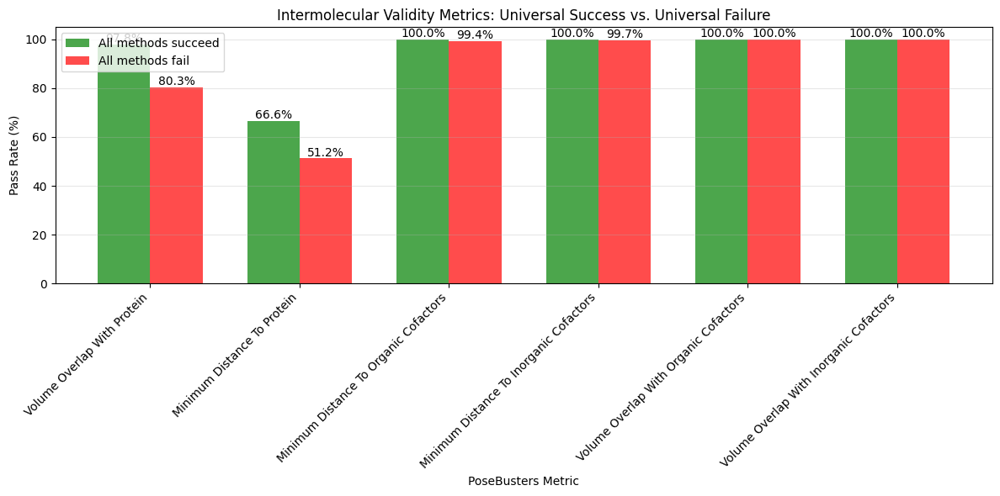

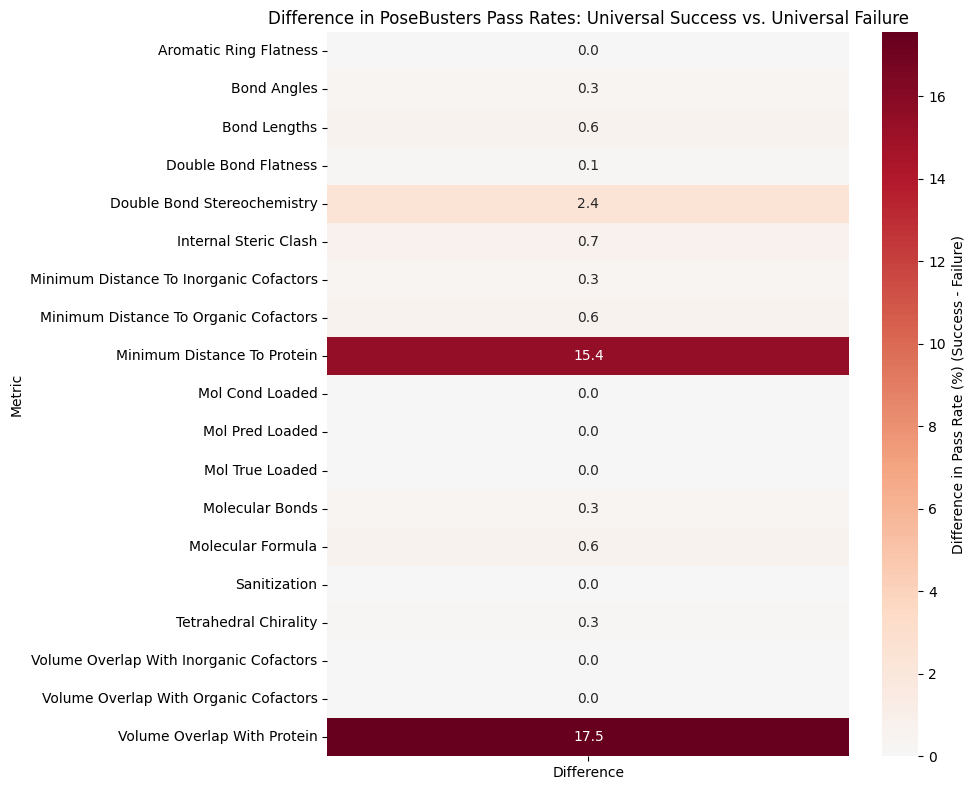


No statistically significant differences found in PoseBusters metrics.


In [4]:
# List of methods to include in analysis
methods = ['diffdock_pocket_only', 'chai-1', 'icm', 'gnina', 'surfdock',]

# Run the universal analysis
universal_results = analysis.analyze_universal(
    methods=methods,
    rmsd_threshold=2.0,
    plot=True
)

# Access key results
success_proteins = universal_results['all_success_proteins']
failure_proteins = universal_results['all_failure_proteins']
significant_metrics = universal_results['significant_metrics']

Analyzing PoseBusters metrics for 70 cases where diffdock succeeds but icm fails
and 161 cases where icm succeeds but diffdock fails


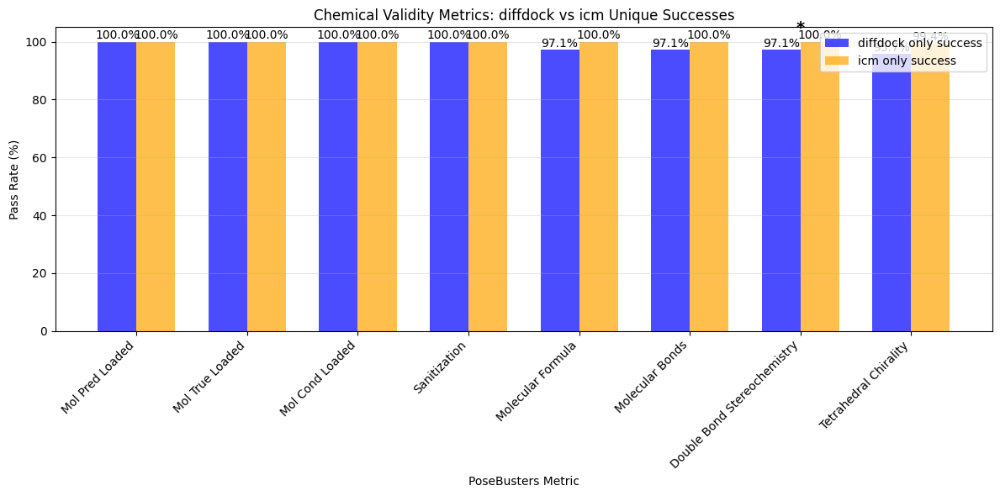

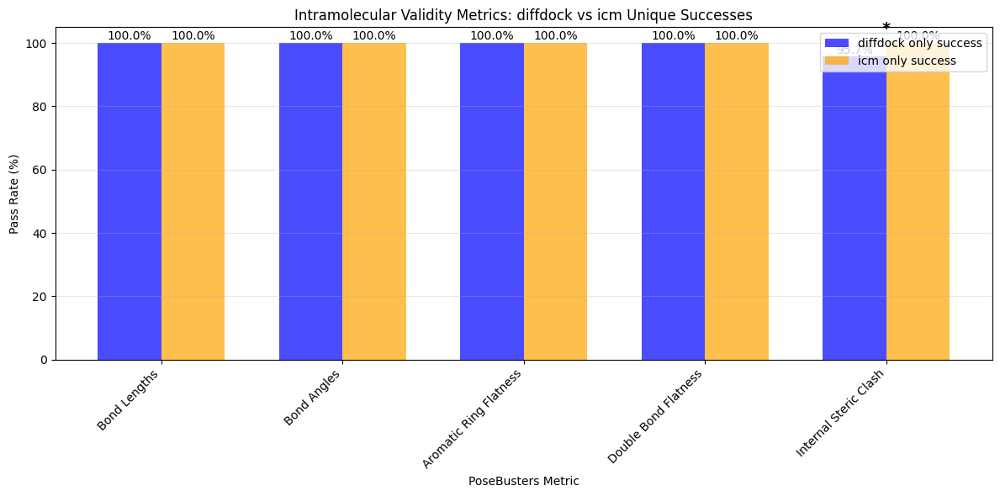

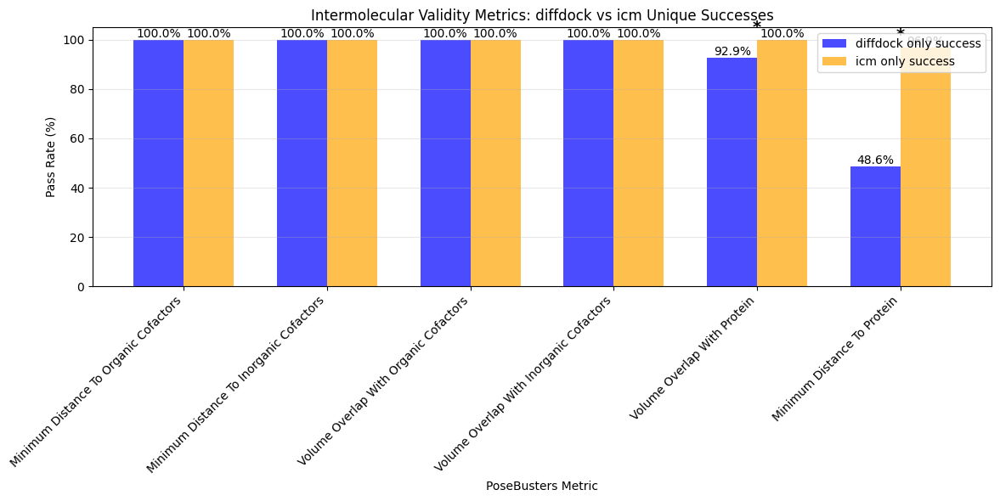

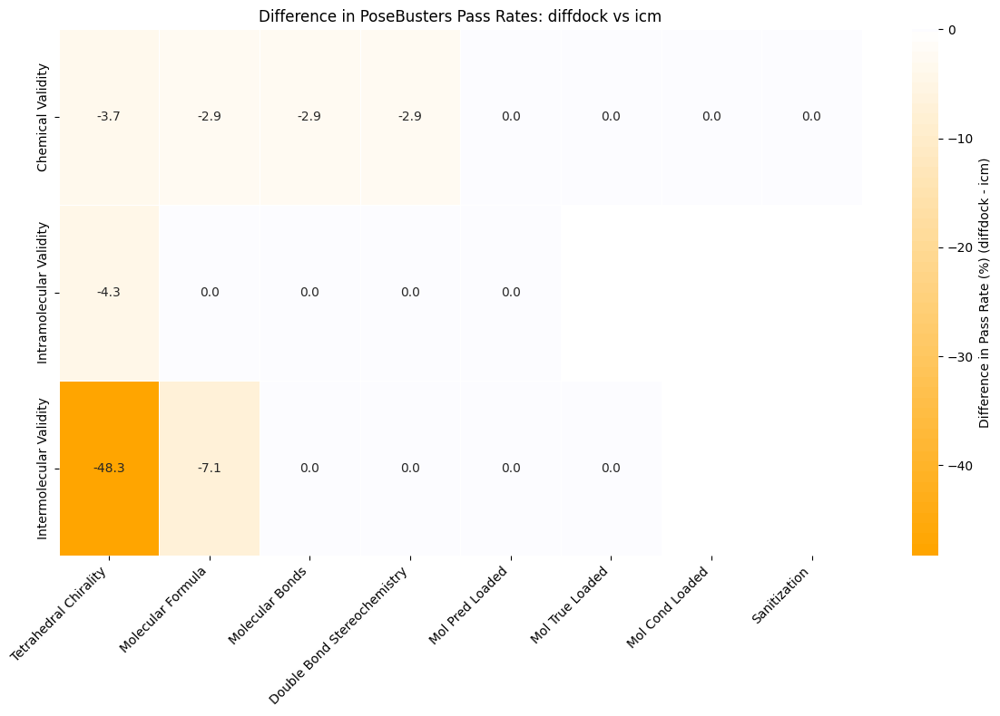


Significant differences in PoseBusters metrics (McNemar's test):
double_bond_stereochemistry: diffdock = 97.1%, icm = 100.0%, difference = -2.9%, p-value = 0.0391, odds ratio = 0.12
  Contingency: Both pass: 681, diffdock only: 1, icm only: 8, Both fail: 5
internal_steric_clash: diffdock = 95.7%, icm = 100.0%, difference = -4.3%, p-value = 0.0010, odds ratio = 0.07
  Contingency: Both pass: 680, diffdock only: 1, icm only: 14, Both fail: 0
minimum_distance_to_protein: diffdock = 48.6%, icm = 96.9%, difference = -48.3%, p-value = 0.0000, odds ratio = 0.01
  Contingency: Both pass: 292, diffdock only: 4, icm only: 388, Both fail: 11
volume_overlap_with_protein: diffdock = 92.9%, icm = 100.0%, difference = -7.1%, p-value = 0.0000, odds ratio = 0.01
  Contingency: Both pass: 614, diffdock only: 0, icm only: 81, Both fail: 0

Insights:

Chemical Validity:
- icm performs better on double_bond_stereochemistry validation (100.0% vs 97.1%)

Intramolecular Validity:
- icm performs better on int

In [5]:
comparative_results = analysis.analyze_comparative(
    method1="diffdock",
    method2="icm",
    rmsd_threshold=2.0,
    plot=True
)

# Access results
method1_only = comparative_results['method1_only_proteins']
method2_only = comparative_results['method2_only_proteins']
significant_metrics = comparative_results['significant_metrics']

Comparing 3 ML-based methods vs. 2 Physics-based methods
ML-based methods: diffdock_pocket_only, surfdock, chai-1
Physics-based methods: gnina, icm


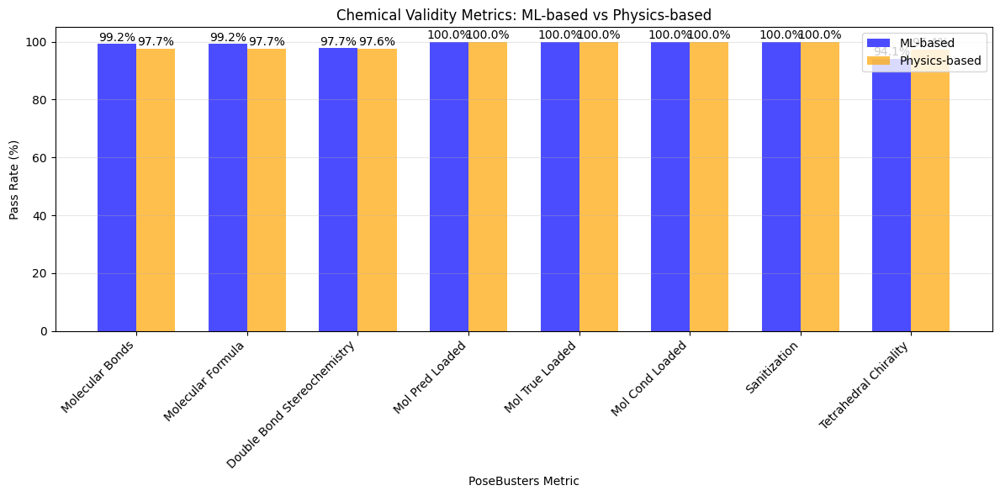

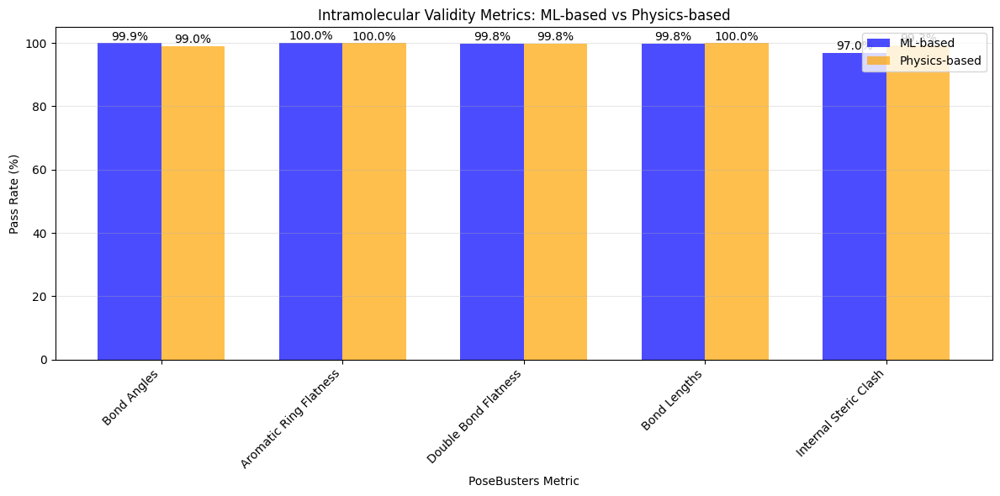

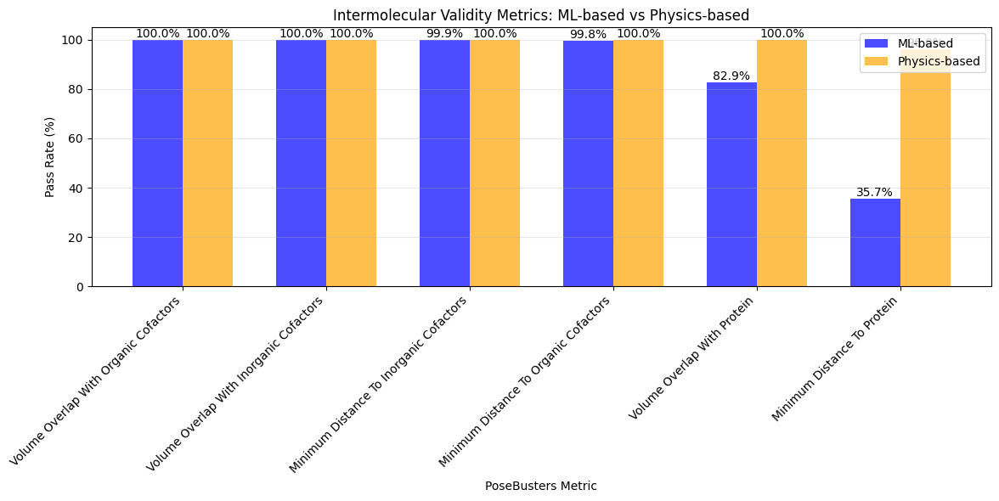

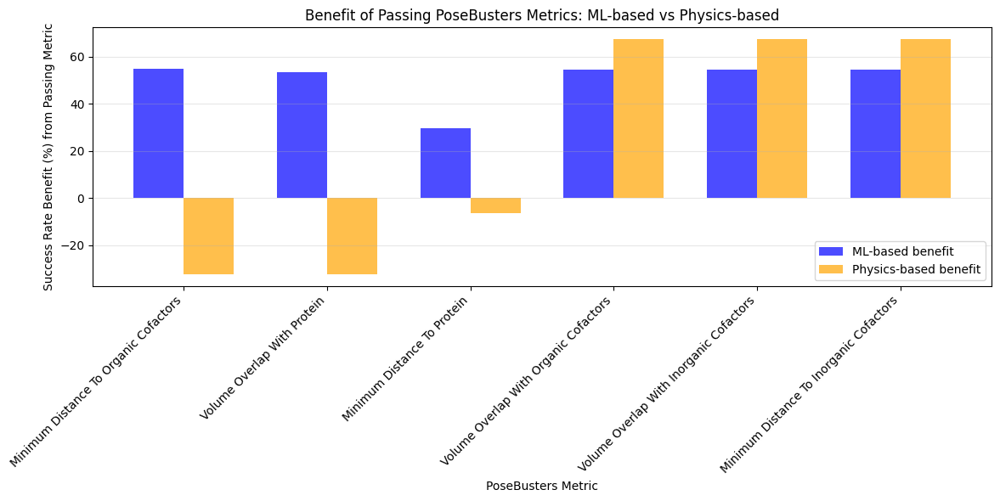

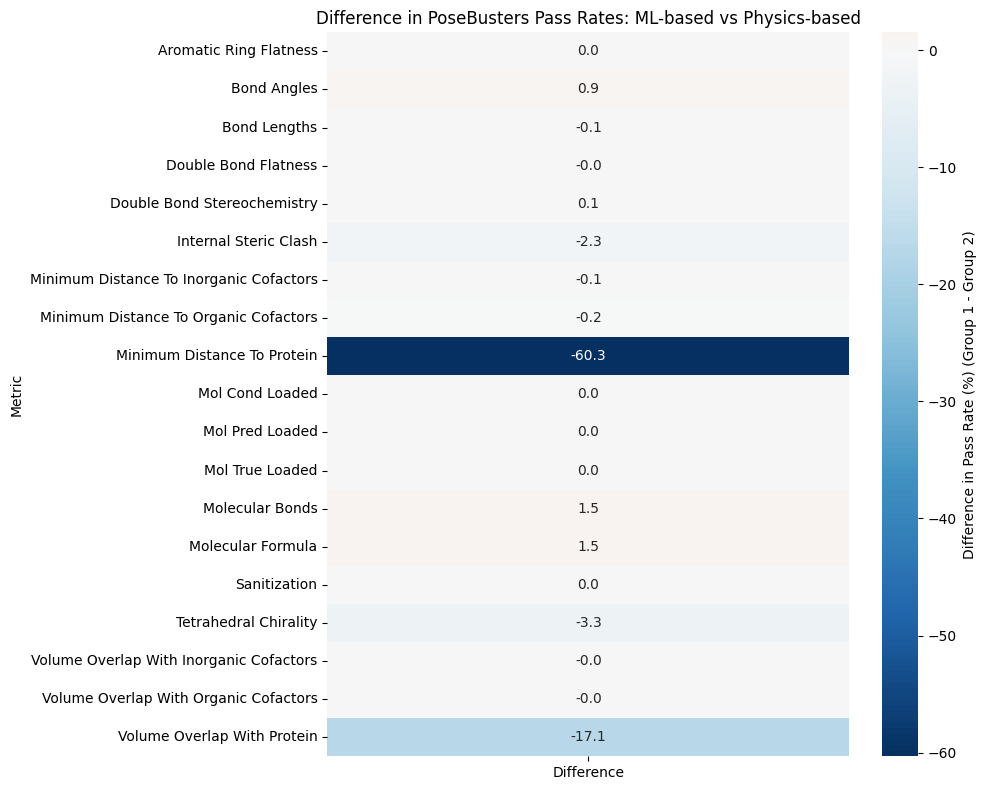


No statistically significant differences found in PoseBusters metrics between method groups.

How PoseBusters metrics affect success rates within groups:

Chemical Validity:
- molecular_bonds:
  ML-based: Success rate 54.5% when pass vs. 75.0% when fail (benefit: -20.5%)
  Physics-based: Success rate 67.9% when pass vs. 51.1% when fail (benefit: 16.8%)
  Note: Physics-based benefits more from passing this metric (difference: 37.3%)
- molecular_formula:
  ML-based: Success rate 54.5% when pass vs. 71.4% when fail (benefit: -16.9%)
  Physics-based: Success rate 67.9% when pass vs. 51.1% when fail (benefit: 16.8%)
  Note: Physics-based benefits more from passing this metric (difference: 33.7%)
- double_bond_stereochemistry:
  ML-based: Success rate 54.8% when pass vs. 49.1% when fail (benefit: 5.7%)
  Physics-based: Success rate 67.9% when pass vs. 51.0% when fail (benefit: 16.9%)
  Note: Physics-based benefits more from passing this metric (difference: 11.2%)
- mol_pred_loaded:
  ML-bas

In [6]:
ml_methods = ['diffdock_pocket_only', 'surfdock', 'chai-1']
physics_methods = ['gnina', 'icm']

group_results = analysis.analyze_method_group_comparative(
    group1_methods=ml_methods,
    group2_methods=physics_methods,
    group1_label="ML-based",
    group2_label="Physics-based",
    rmsd_threshold=2.0,
    plot=True
)

## Base Property Analysis

### Individual Property Analysis

In [5]:
# 1. Initialize
property_analysis = PropertyAnalysis(df_combined)

#### gnina


Impact of ligand_is_covalent on Docking RMSD for gnina
Mann-Whitney U test p-value: 0.000000
Fisher's exact test p-value: 0.000000
Effect size (Cohen's d): 1.743

True group: 198 samples, mean RMSD = 3.81, success rate = 20.7%
False group: 818 samples, mean RMSD = 1.24, success rate = 85.3%


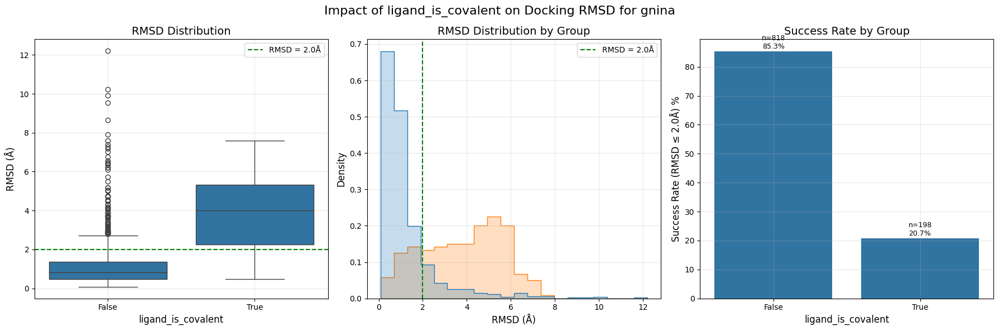


Impact of ligand_is_cofactor on Docking RMSD for gnina
Mann-Whitney U test p-value: 0.000001
Fisher's exact test p-value: 0.000000
Effect size (Cohen's d): 0.527

True group: 137 samples, mean RMSD = 0.94, success rate = 94.2%
False group: 879 samples, mean RMSD = 1.87, success rate = 69.4%


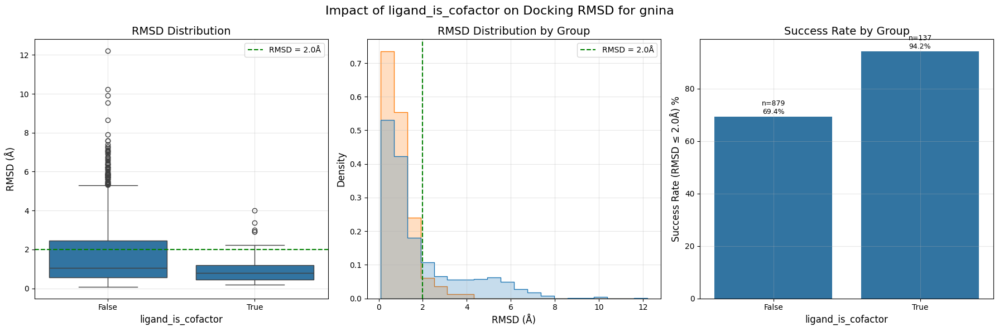


Impact of system_num_protein_chains on Docking RMSD for gnina
Spearman correlation: -0.1167, p-value: 0.000194


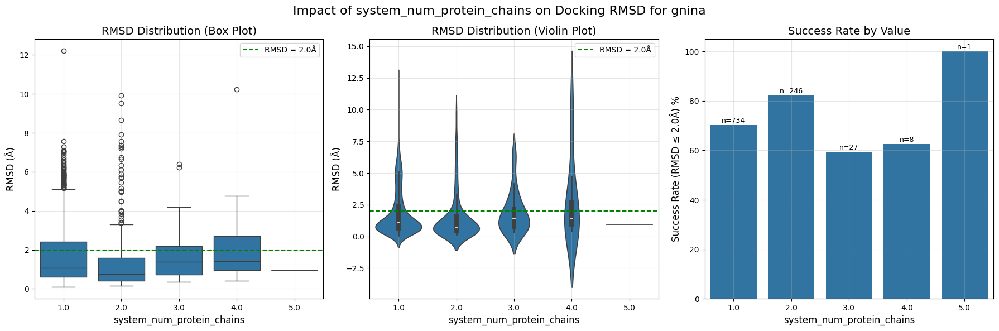


Success rates by discrete value:
  system_num_protein_chains  total_count  success_rate  mean_rmsd
0                       1.0          734     70.163488   1.820495
1                       2.0          246     82.113821   1.467976
2                       3.0           27     59.259259   1.879979
3                       4.0            8     62.500000   2.726553
4                       5.0            1    100.000000   0.963493

ANOVA test: F=2.492, p=0.041644
Significant differences in RMSD across system_num_protein_chains values

Impact of ligand_num_rot_bonds on Docking RMSD for gnina
Spearman correlation: 0.1886, p-value: 0.000000


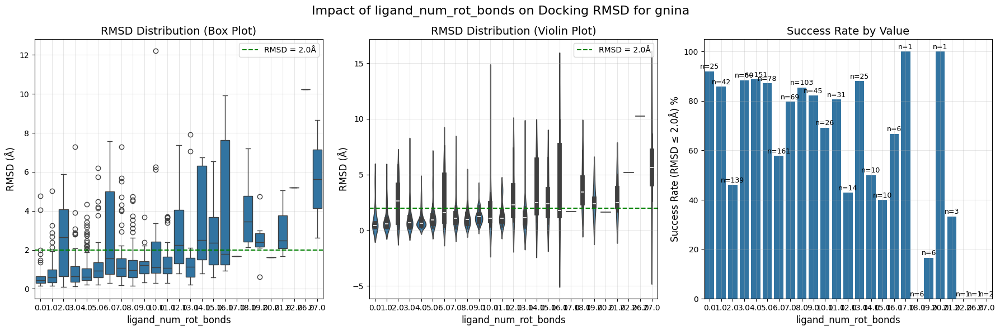


Success rates by discrete value:
   ligand_num_rot_bonds  total_count  success_rate  mean_rmsd
0                   0.0           25     92.000000   0.899889
1                   1.0           42     85.714286   0.936887
2                   2.0          139     46.043165   2.496990
3                   3.0           60     88.333333   1.008090
4                   4.0          151     88.741722   0.912815
5                   5.0           78     87.179487   1.235102
6                   6.0          161     57.763975   2.699428
7                   7.0           69     79.710145   1.486614
8                   8.0          103     85.436893   1.205556
9                   9.0           45     82.222222   1.267160
10                 10.0           26     69.230769   2.168881
11                 11.0           31     80.645161   1.455704
12                 12.0           14     42.857143   3.089680
13                 13.0           25     88.000000   1.532347
14                 14.0           10

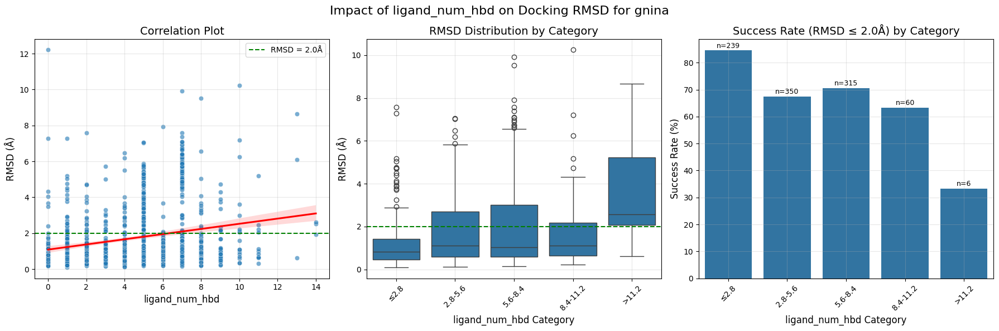


Success rates by category:
  ligand_num_hbd_category  total_count  success_rate  mean_rmsd
0                    ≤2.8          239     84.518828   1.201866
1                 2.8-5.6          350     67.428571   1.787491
2                 5.6-8.4          315     70.476190   2.082434
3                8.4-11.2           60     63.333333   1.834011
4                   >11.2            6     33.333333   3.739054

ANOVA test: F=10.800, p=0.000000
Significant differences in RMSD across ligand_num_hbd categories

Impact of ligand_num_hba on Docking RMSD for gnina
Pearson correlation: 0.0296, p-value: 0.346587
Spearman correlation: 0.0697, p-value: 0.026332


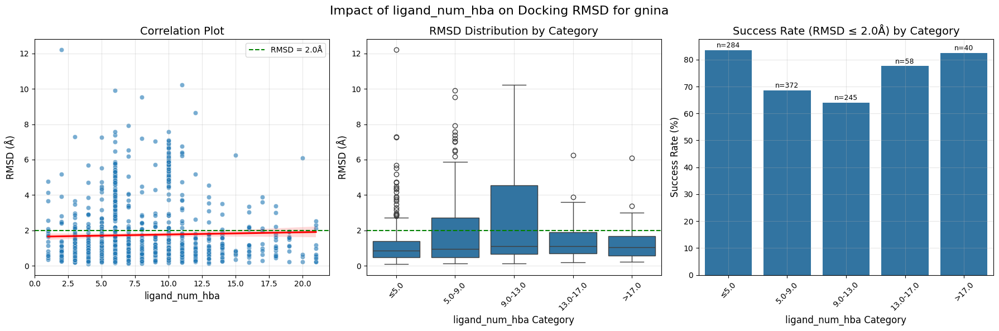


Success rates by category:
  ligand_num_hba_category  total_count  success_rate  mean_rmsd
0                    ≤5.0          284     83.450704   1.252345
1                 5.0-9.0          372     68.548387   1.819127
2                9.0-13.0          245     64.081633   2.342647
3               13.0-17.0           58     77.586207   1.406388
4                   >17.0           40     82.500000   1.318796

ANOVA test: F=13.984, p=0.000000
Significant differences in RMSD across ligand_num_hba categories

Impact of ligand_num_rings on Docking RMSD for gnina
Spearman correlation: -0.3090, p-value: 0.000000


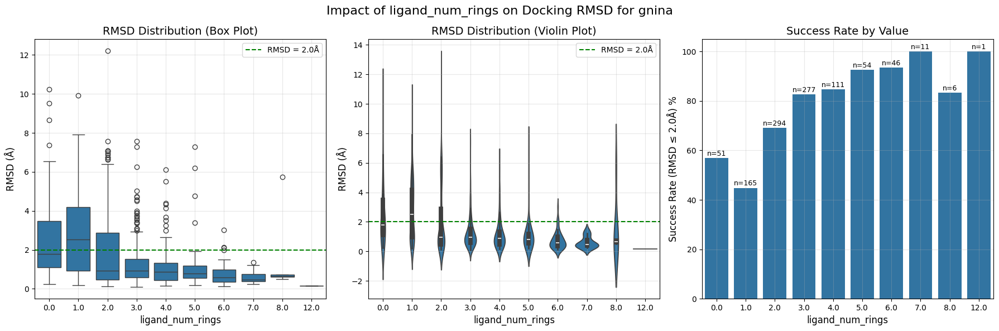


Success rates by discrete value:
  ligand_num_rings  total_count  success_rate  mean_rmsd
0              0.0           51     56.862745   2.613725
1              1.0          165     44.848485   2.705851
2              2.0          294     69.047619   2.016780
3              3.0          277     82.671480   1.268314
4              4.0          111     84.684685   1.191668
5              5.0           54     92.592593   1.182653
6              6.0           46     93.478261   0.761002
7              7.0           11    100.000000   0.613440
8              8.0            6     83.333333   1.470128
9             12.0            1    100.000000   0.165846

ANOVA test: F=15.084, p=0.000000
Significant differences in RMSD across ligand_num_rings values

Impact of entry_resolution on Docking RMSD for gnina
Pearson correlation: 0.1489, p-value: 0.000002
Spearman correlation: 0.2061, p-value: 0.000000


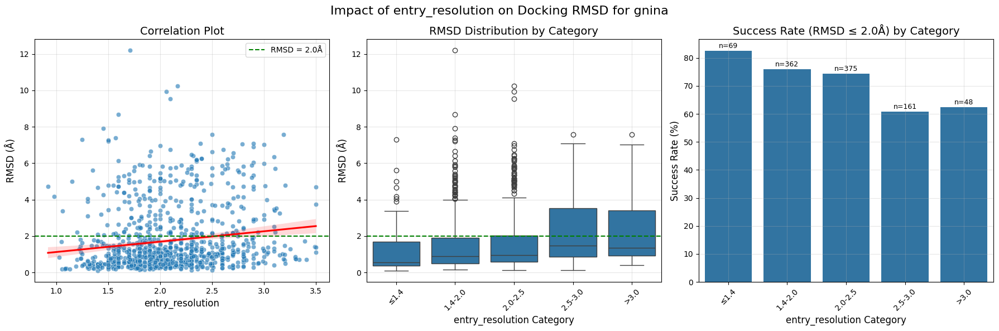


Success rates by category:
  entry_resolution_category  total_count  success_rate  mean_rmsd
0                      ≤1.4           69     82.608696   1.265091
1                   1.4-2.0          362     75.966851   1.583302
2                   2.0-2.5          375     74.400000   1.678774
3                   2.5-3.0          161     60.869565   2.275183
4                      >3.0           48     62.500000   2.289106

ANOVA test: F=6.888, p=0.000018
Significant differences in RMSD across entry_resolution categories

Impact of entry_validation_molprobity on Docking RMSD for gnina
Pearson correlation: 0.0599, p-value: 0.056318
Spearman correlation: 0.0900, p-value: 0.004109


/Users/aoxu/projects/DrugDiscovery/PoseBench/notebooks/plinder_analysis_utils.py:1380: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[property_category] = pd.cut(df[property_name], bins=bins, labels=bin_labels)


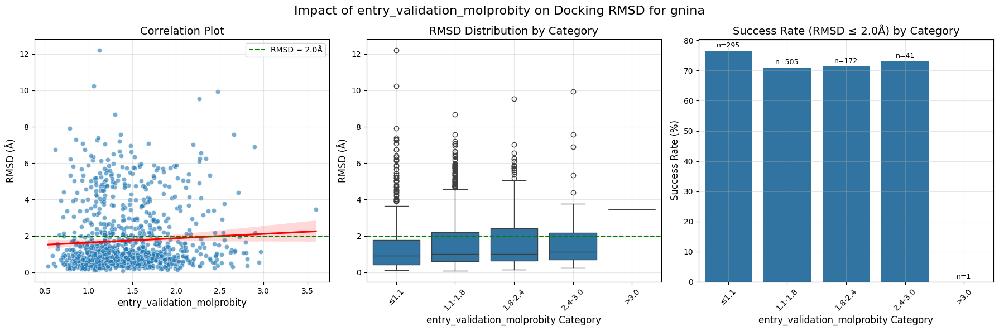


Success rates by category:
  entry_validation_molprobity_category  total_count  success_rate  mean_rmsd
0                                 ≤1.1          295     76.610169   1.658014
1                              1.1-1.8          505     71.089109   1.733172
2                              1.8-2.4          172     71.511628   1.846451
3                              2.4-3.0           41     73.170732   1.928953
4                                 >3.0            1      0.000000   3.470572

ANOVA test: F=0.656, p=0.622683

Impact of system_num_pocket_residues on Docking RMSD for gnina
Pearson correlation: -0.3780, p-value: 0.000000
Spearman correlation: -0.4166, p-value: 0.000000


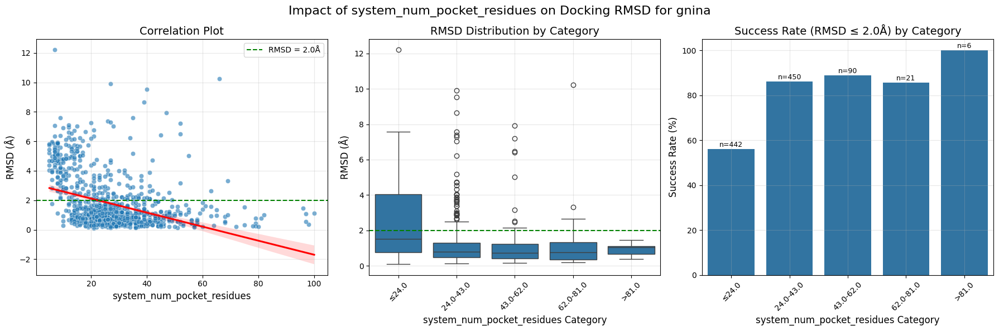


Success rates by category:
  system_num_pocket_residues_category  total_count  success_rate  mean_rmsd
0                               ≤24.0          442     56.108597   2.417943
1                           24.0-43.0          450     86.000000   1.168650
2                           43.0-62.0           90     88.888889   1.182151
3                           62.0-81.0           21     85.714286   1.379966
4                               >81.0            6    100.000000   0.930906

ANOVA test: F=34.448, p=0.000000
Significant differences in RMSD across system_num_pocket_residues categories

Impact of system_num_interactions on Docking RMSD for gnina
Pearson correlation: -0.3860, p-value: 0.000000
Spearman correlation: -0.4681, p-value: 0.000000


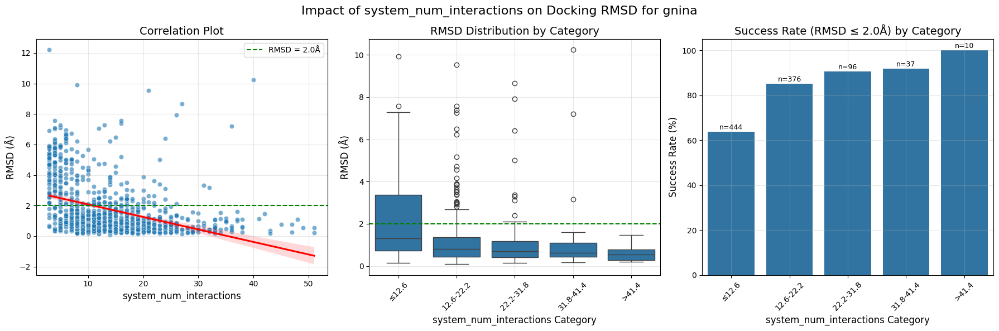


Success rates by category:
  system_num_interactions_category  total_count  success_rate  mean_rmsd
0                            ≤12.6          444     63.738739   2.147015
1                        12.6-22.2          376     85.106383   1.156313
2                        22.2-31.8           96     90.625000   1.098343
3                        31.8-41.4           37     91.891892   1.215231
4                            >41.4           10    100.000000   0.620400

ANOVA test: F=23.758, p=0.000000
Significant differences in RMSD across system_num_interactions categories

Impact of ligand_molecular_weight on Docking RMSD for gnina
Pearson correlation: -0.0210, p-value: 0.502728
Spearman correlation: 0.0003, p-value: 0.991616


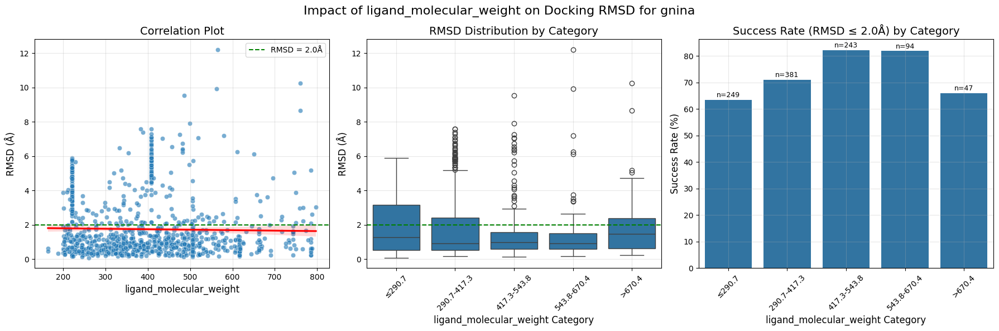


Success rates by category:
  ligand_molecular_weight_category  total_count  success_rate  mean_rmsd
0                           ≤290.7          249     63.453815   1.927786
1                      290.7-417.3          381     71.128609   1.860027
2                      417.3-543.8          243     82.304527   1.430803
3                      543.8-670.4           94     81.914894   1.485125
4                           >670.4           47     65.957447   1.996104

ANOVA test: F=3.661, p=0.005720
Significant differences in RMSD across ligand_molecular_weight categories

Impact of ligand_crippen_clogp on Docking RMSD for gnina
Pearson correlation: -0.2625, p-value: 0.000000
Spearman correlation: -0.2451, p-value: 0.000000


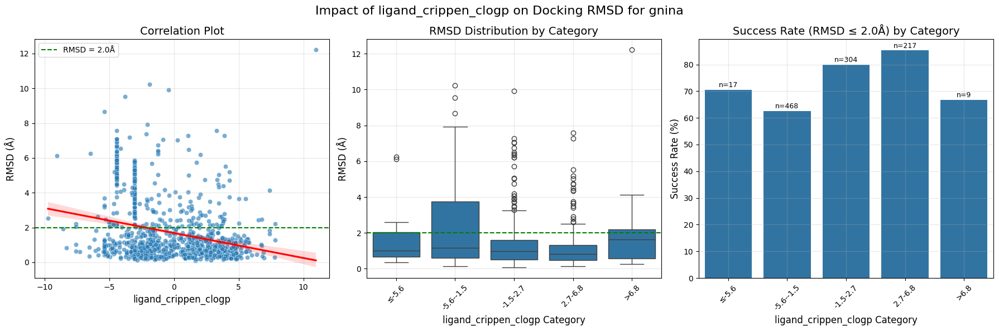


Success rates by category:
  ligand_crippen_clogp_category  total_count  success_rate  mean_rmsd
0                         ≤-5.6           17     70.588235   1.789337
1                     -5.6--1.5          468     62.606838   2.198008
2                      -1.5-2.7          304     79.934211   1.404541
3                       2.7-6.8          217     85.253456   1.188573
4                          >6.8            9     66.666667   2.710453

ANOVA test: F=17.089, p=0.000000
Significant differences in RMSD across ligand_crippen_clogp categories

Impact of ligand_num_interacting_residues on Docking RMSD for gnina
Pearson correlation: -0.4577, p-value: 0.000000
Spearman correlation: -0.4855, p-value: 0.000000


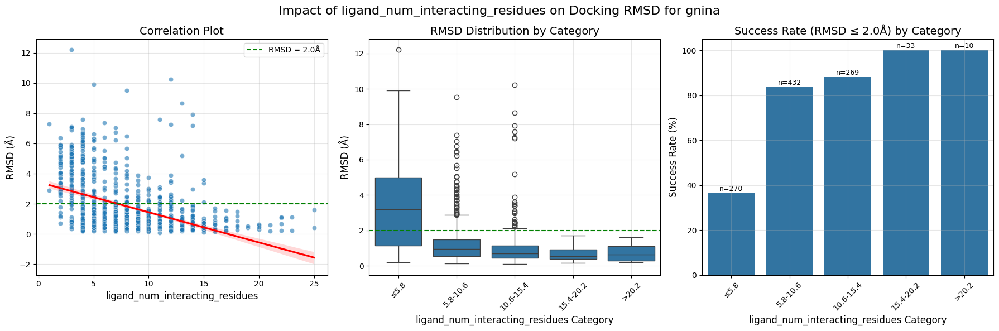


Success rates by category:
  ligand_num_interacting_residues_category  total_count  success_rate  \
0                                     ≤5.8          270     36.296296   
1                                 5.8-10.6          432     83.564815   
2                                10.6-15.4          269     88.104089   
3                                15.4-20.2           33    100.000000   
4                                    >20.2           10    100.000000   

   mean_rmsd  
0   3.250441  
1   1.303304  
2   1.077019  
3   0.701382  
4   0.722625  

ANOVA test: F=91.821, p=0.000000
Significant differences in RMSD across ligand_num_interacting_residues categories

Impact of ligand_num_neighboring_residues on Docking RMSD for gnina
Pearson correlation: -0.5012, p-value: 0.000000
Spearman correlation: -0.4664, p-value: 0.000000


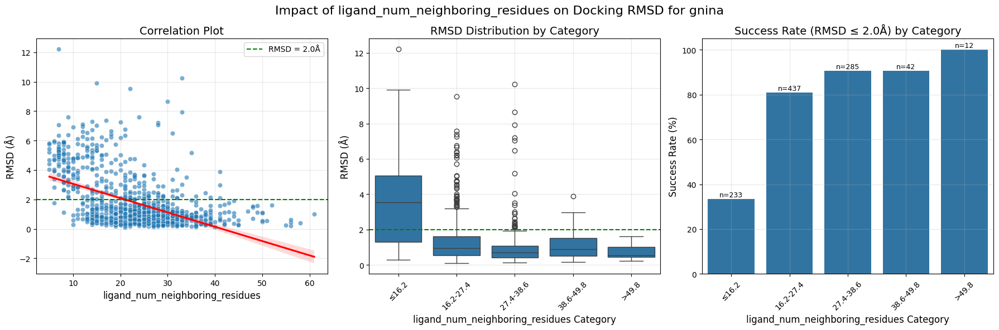


Success rates by category:
  ligand_num_neighboring_residues_category  total_count  success_rate  \
0                                    ≤16.2          233     33.476395   
1                                16.2-27.4          437     80.778032   
2                                27.4-38.6          285     90.526316   
3                                38.6-49.8           42     90.476190   
4                                    >49.8           12    100.000000   

   mean_rmsd  
0   3.402511  
1   1.377342  
2   1.010298  
3   1.063082  
4   0.692797  

ANOVA test: F=96.639, p=0.000000
Significant differences in RMSD across ligand_num_neighboring_residues categories

Impact of ligand_num_interactions on Docking RMSD for gnina
Pearson correlation: -0.4362, p-value: 0.000000
Spearman correlation: -0.4835, p-value: 0.000000


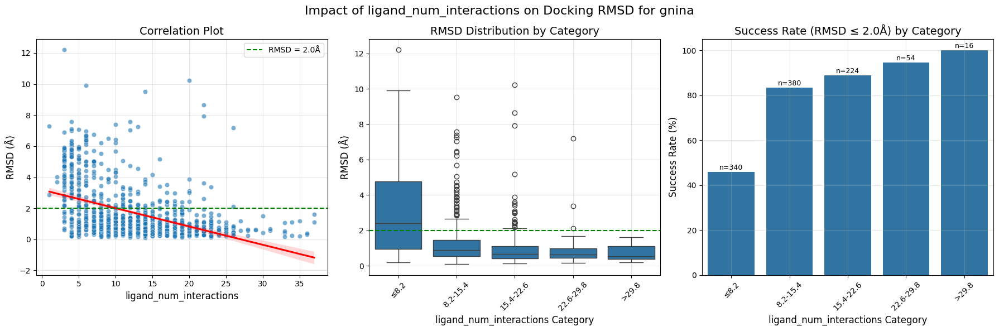


Success rates by category:
  ligand_num_interactions_category  total_count  success_rate  mean_rmsd
0                             ≤8.2          340     45.882353   2.885639
1                         8.2-15.4          380     83.421053   1.284161
2                        15.4-22.6          224     88.839286   1.036853
3                        22.6-29.8           54     94.444444   0.886318
4                            >29.8           16    100.000000   0.720122

ANOVA test: F=68.712, p=0.000000
Significant differences in RMSD across ligand_num_interactions categories


In [ ]:
for prop in PLINDER_TEST_COLUMNS[2:]:
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_single_method(
        "gnina", prop, prop_type,
    )

#### icm


Impact of ligand_is_covalent on Docking RMSD for icm
Mann-Whitney U test p-value: nan
Fisher's exact test p-value: 0.000000
Effect size (Cohen's d): 1.392

True group: 194 samples, mean RMSD = 4.83, success rate = 19.6%
False group: 801 samples, mean RMSD = 1.84, success rate = 72.4%


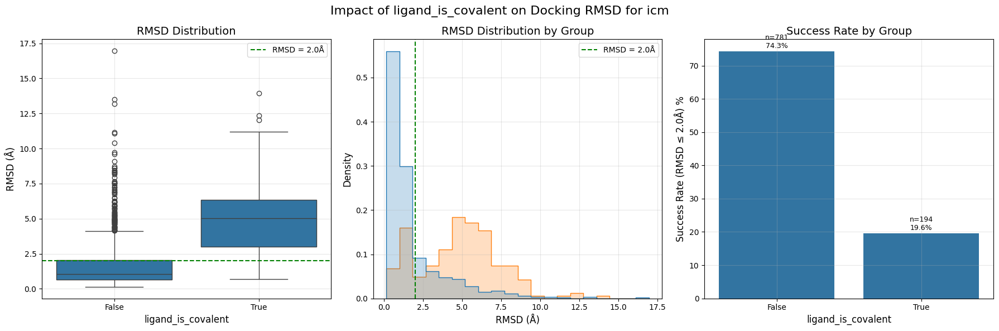


Impact of ligand_is_cofactor on Docking RMSD for icm
Mann-Whitney U test p-value: nan
Fisher's exact test p-value: 0.118079
Effect size (Cohen's d): 0.409

True group: 128 samples, mean RMSD = 1.55, success rate = 68.8%
False group: 867 samples, mean RMSD = 2.55, success rate = 61.1%


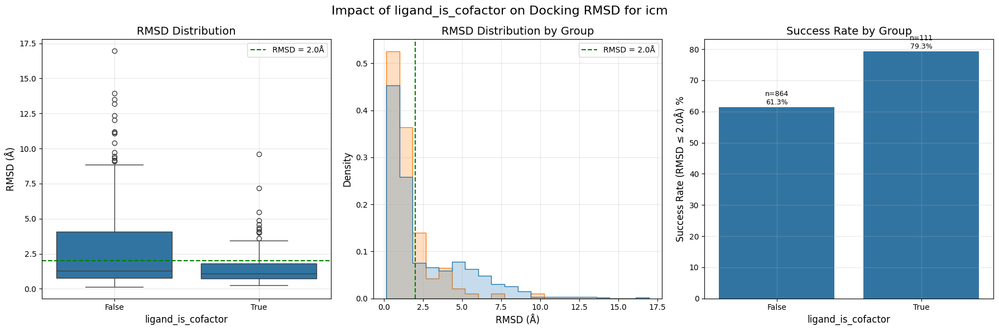


Impact of system_num_protein_chains on Docking RMSD for icm
Spearman correlation: nan, p-value: nan


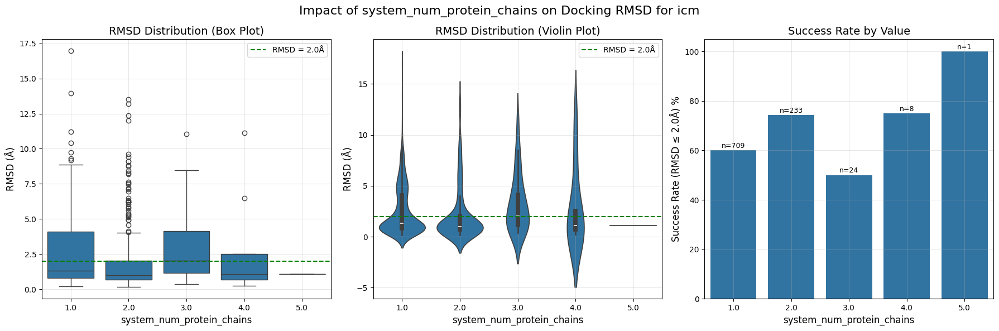


Success rates by discrete value:
  system_num_protein_chains  total_count  success_rate  mean_rmsd
0                       1.0          709     60.084626   2.498110
1                       2.0          233     74.248927   2.133495
2                       3.0           24     50.000000   3.316581
3                       4.0            8     75.000000   2.799078
4                       5.0            1    100.000000   1.078510

ANOVA test: F=nan, p=nan


ValueError: array must not contain infs or NaNs

In [30]:
for prop in PLINDER_TEST_COLUMNS[2:]:
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_single_method(
        "icm", prop, prop_type,
    )

#### surfdock


Impact of ligand_is_covalent on Docking RMSD for surfdock
Mann-Whitney U test p-value: 0.000000
Fisher's exact test p-value: 0.000000
Effect size (Cohen's d): 0.211

True group: 123 samples, mean RMSD = 5484.18, success rate = 48.8%
False group: 546 samples, mean RMSD = 1.49, success rate = 82.1%


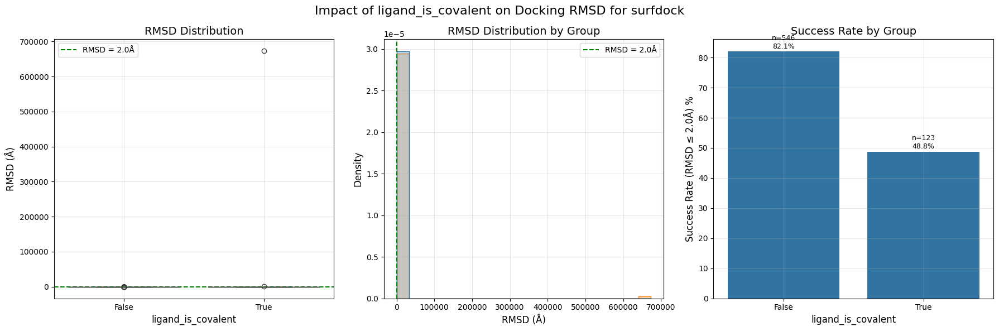


Impact of ligand_is_cofactor on Docking RMSD for surfdock
Mann-Whitney U test p-value: 0.231135
Fisher's exact test p-value: 0.102284
Effect size (Cohen's d): 0.044

True group: 85 samples, mean RMSD = 1.64, success rate = 83.5%
False group: 584 samples, mean RMSD = 1156.21, success rate = 74.8%


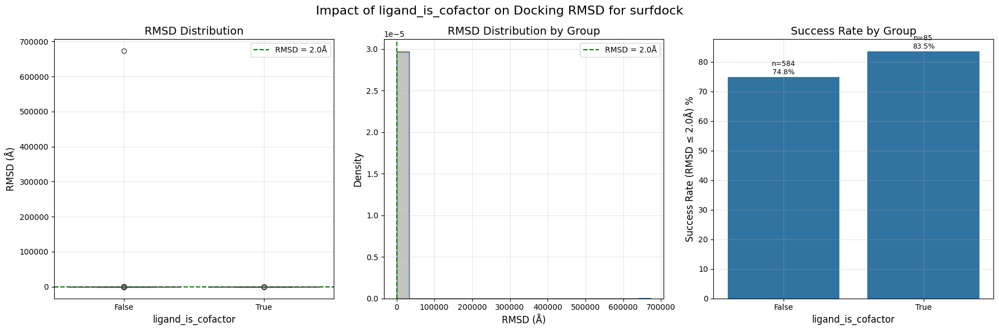


Impact of system_num_protein_chains on Docking RMSD for surfdock
Spearman correlation: -0.0650, p-value: 0.092734


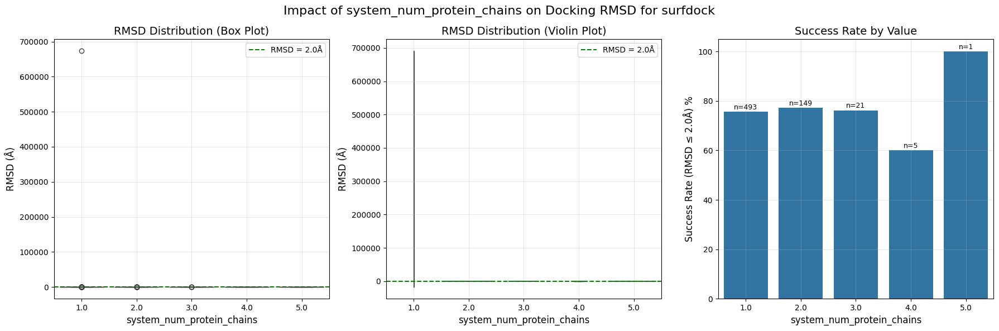


Success rates by discrete value:
  system_num_protein_chains  total_count  success_rate    mean_rmsd
0                       1.0          493     75.659229  1369.309106
1                       2.0          149     77.181208     1.631512
2                       3.0           21     76.190476     1.707347
3                       4.0            5     60.000000     3.561998
4                       5.0            1    100.000000     1.490138

ANOVA test: F=0.089, p=0.985898

Impact of ligand_num_rot_bonds on Docking RMSD for surfdock
Pearson correlation: -0.0003, p-value: 0.994311
Spearman correlation: 0.2760, p-value: 0.000000


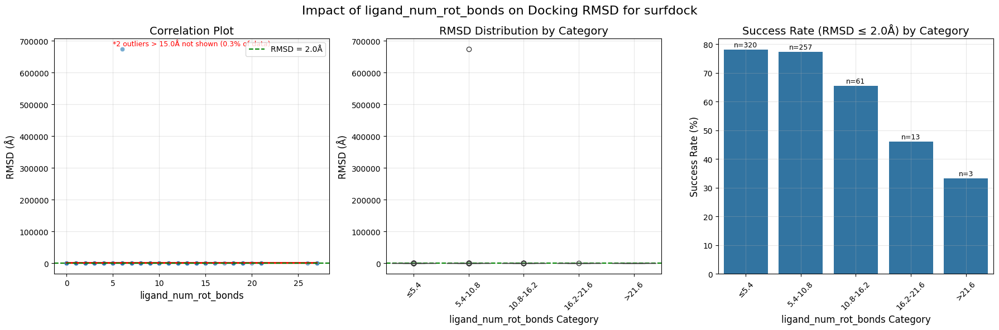


Success rates by category:
  ligand_num_rot_bonds_category  total_count  success_rate    mean_rmsd
0                          ≤5.4          320     78.125000     3.683994
1                      5.4-10.8          257     77.431907  2622.410225
2                     10.8-16.2           61     65.573770     2.629156
3                     16.2-21.6           13     46.153846     2.887120
4                         >21.6            3     33.333333     3.842896

ANOVA test: F=0.384, p=0.819982

Impact of ligand_num_hbd on Docking RMSD for surfdock
Pearson correlation: 0.0357, p-value: 0.356527
Spearman correlation: 0.3243, p-value: 0.000000


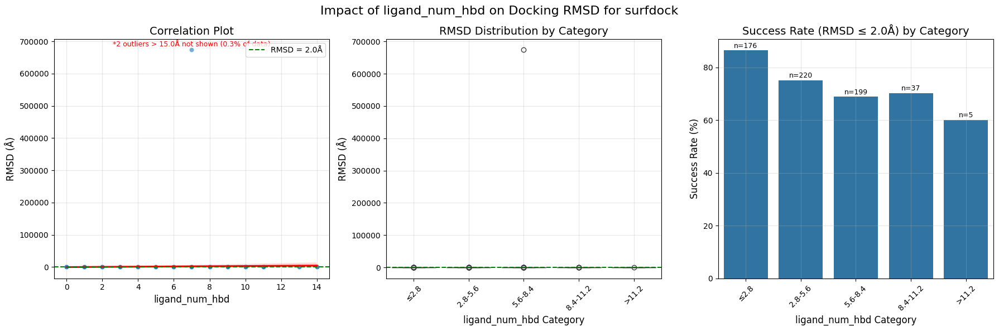


Success rates by category:
  ligand_num_hbd_category  total_count  success_rate    mean_rmsd
0                    ≤2.8          176     86.363636     1.226141
1                 2.8-5.6          220     75.000000     4.882579
2                 5.6-8.4          199     68.844221  3386.570104
3                8.4-11.2           37     70.270270     2.081128
4                   >11.2            5     60.000000     2.434490

ANOVA test: F=0.548, p=0.700284

Impact of ligand_num_hba on Docking RMSD for surfdock
Pearson correlation: 0.0200, p-value: 0.606308
Spearman correlation: 0.2982, p-value: 0.000000


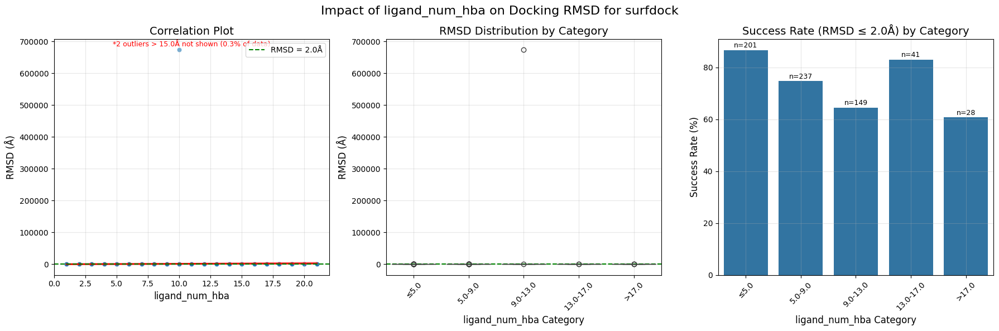


Success rates by category:
  ligand_num_hba_category  total_count  success_rate    mean_rmsd
0                    ≤5.0          201     86.567164     1.275128
1                 5.0-9.0          237     74.683544     4.605441
2                9.0-13.0          149     64.429530  4522.542373
3               13.0-17.0           41     82.926829     1.623369
4                   >17.0           28     60.714286     2.591129

ANOVA test: F=0.850, p=0.493995

Impact of ligand_num_rings on Docking RMSD for surfdock
Spearman correlation: -0.0555, p-value: 0.151409


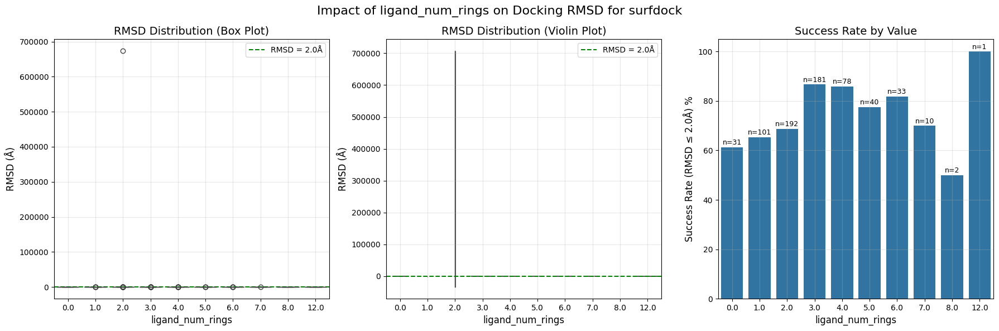


Success rates by discrete value:
  ligand_num_rings  total_count  success_rate    mean_rmsd
0              0.0           31     61.290323     2.119864
1              1.0          101     65.346535     8.905976
2              2.0          192     68.750000  3509.862666
3              3.0          181     86.740331     1.341725
4              4.0           78     85.897436     1.463025
5              5.0           40     77.500000     1.924370
6              6.0           33     81.818182     1.467025
7              7.0           10     70.000000     1.796173
8              8.0            2     50.000000     4.100988
9             12.0            1    100.000000     0.269246

ANOVA test: F=0.273, p=0.981756

Impact of entry_resolution on Docking RMSD for surfdock
Pearson correlation: 0.0896, p-value: 0.020452
Spearman correlation: 0.1044, p-value: 0.006886


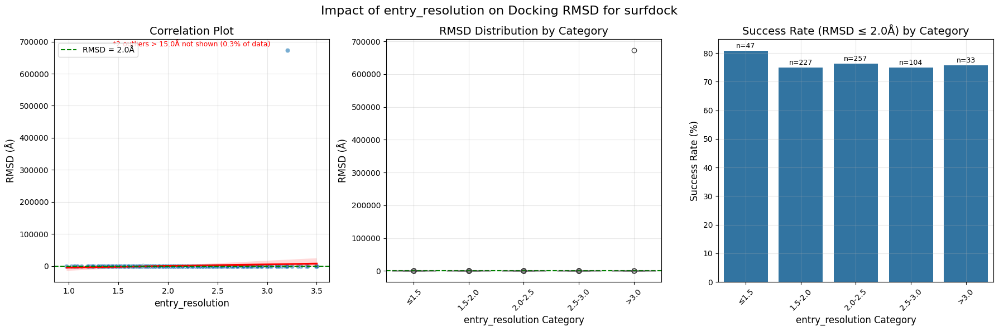


Success rates by category:
  entry_resolution_category  total_count  success_rate     mean_rmsd
0                      ≤1.5           47     80.851064      1.428658
1                   1.5-2.0          227     74.889868      4.872242
2                   2.0-2.5          257     76.264591      1.661444
3                   2.5-3.0          104     75.000000      1.981422
4                      >3.0           33     75.757576  20410.931681

ANOVA test: F=4.923, p=0.000645
Significant differences in RMSD across entry_resolution categories

Impact of entry_validation_molprobity on Docking RMSD for surfdock
Pearson correlation: 0.0405, p-value: 0.295854
Spearman correlation: -0.0016, p-value: 0.966563


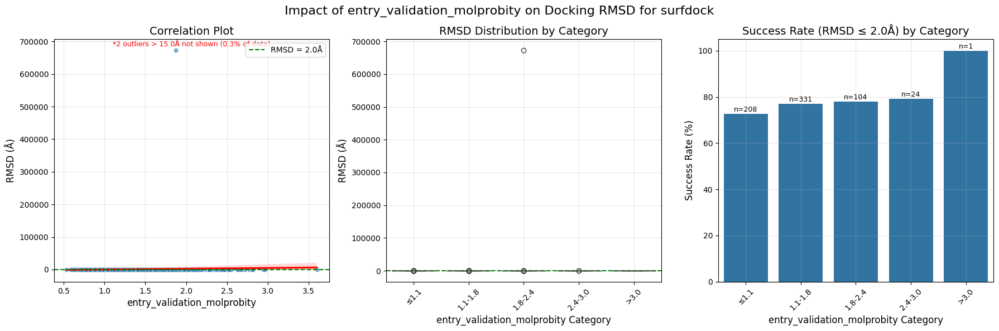


Success rates by category:
  entry_validation_molprobity_category  total_count  success_rate    mean_rmsd
0                                 ≤1.1          208     72.596154     1.843075
1                              1.1-1.8          331     77.039275     3.845621
2                              1.8-2.4          104     77.884615  6477.588147
3                              2.4-3.0           24     79.166667     1.705349
4                                 >3.0            1    100.000000     0.708130

ANOVA test: F=1.358, p=0.246988

Impact of system_num_pocket_residues on Docking RMSD for surfdock
Pearson correlation: -0.0495, p-value: 0.201304
Spearman correlation: -0.1707, p-value: 0.000009


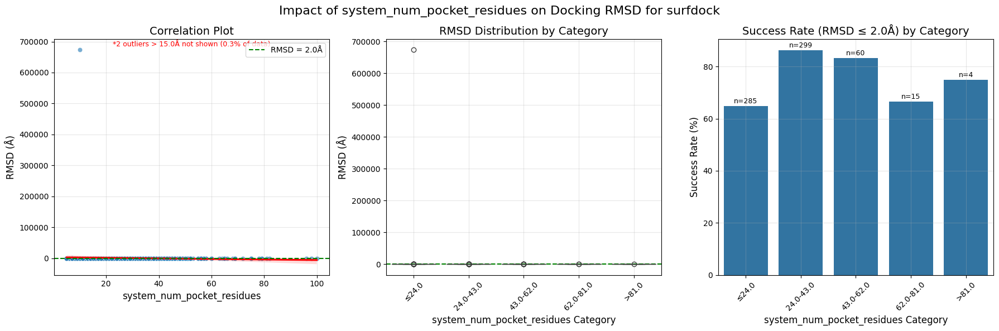


Success rates by category:
  system_num_pocket_residues_category  total_count  success_rate    mean_rmsd
0                               ≤24.0          285     64.912281  2367.764240
1                           24.0-43.0          299     86.287625     1.356745
2                           43.0-62.0           60     83.333333     1.422648
3                           62.0-81.0           15     66.666667     2.172160
4                               >81.0            4     75.000000     3.543788

ANOVA test: F=0.331, p=0.857084

Impact of system_num_interactions on Docking RMSD for surfdock
Pearson correlation: -0.0471, p-value: 0.223287
Spearman correlation: -0.1672, p-value: 0.000014


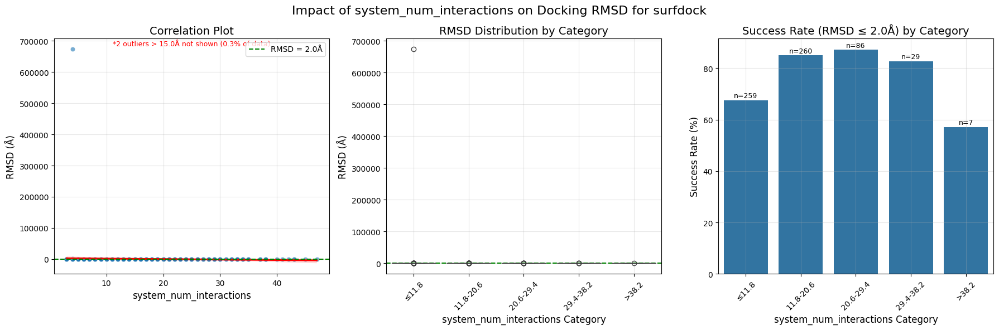


Success rates by category:
  system_num_interactions_category  total_count  success_rate    mean_rmsd
0                            ≤11.8          259     67.567568  2605.122875
1                        11.8-20.6          260     85.000000     1.348771
2                        20.6-29.4           86     87.209302     1.554951
3                        29.4-38.2           29     82.758621     1.522189
4                            >38.2            7     57.142857     3.215543

ANOVA test: F=0.368, p=0.831337

Impact of ligand_molecular_weight on Docking RMSD for surfdock
Pearson correlation: 0.0021, p-value: 0.956610
Spearman correlation: 0.2718, p-value: 0.000000


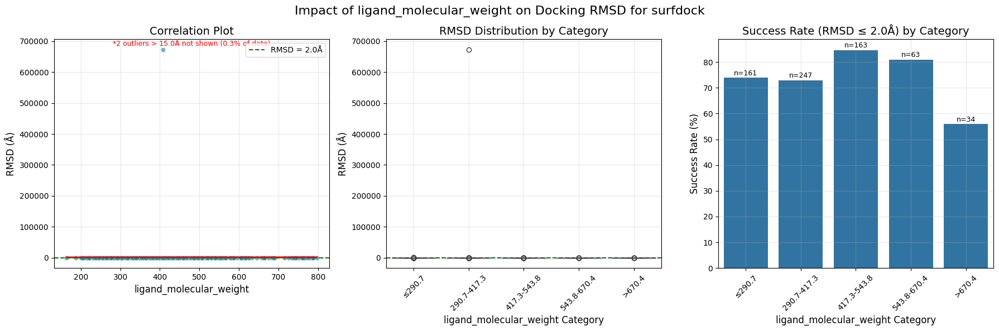


Success rates by category:
  ligand_molecular_weight_category  total_count  success_rate    mean_rmsd
0                           ≤290.7          161     73.913043     5.963862
1                      290.7-417.3          247     72.874494  2728.532686
2                      417.3-543.8          163     84.662577     1.539956
3                      543.8-670.4           63     80.952381     1.902482
4                           >670.4           34     55.882353     2.595030

ANOVA test: F=0.424, p=0.791256

Impact of ligand_crippen_clogp on Docking RMSD for surfdock
Pearson correlation: -0.0492, p-value: 0.204107
Spearman correlation: -0.2898, p-value: 0.000000


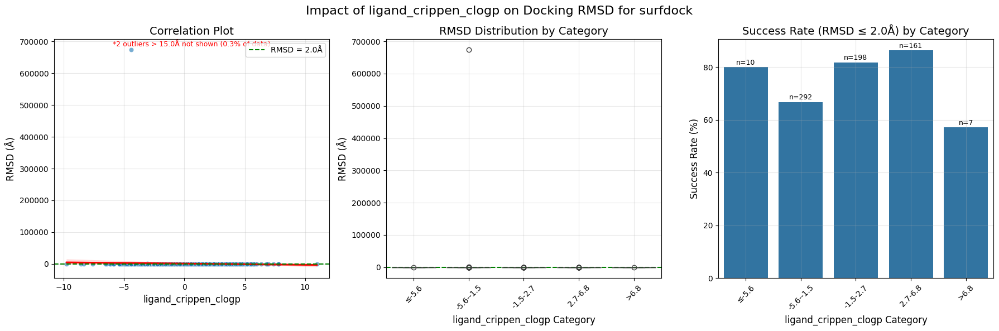


Success rates by category:
  ligand_crippen_clogp_category  total_count  success_rate    mean_rmsd
0                         ≤-5.6           10     80.000000     1.815621
1                     -5.6--1.5          292     66.780822  2311.040820
2                      -1.5-2.7          198     81.818182     1.433016
3                       2.7-6.8          161     86.335404     1.365570
4                          >6.8            7     57.142857     2.825228

ANOVA test: F=0.321, p=0.863648

Impact of ligand_num_interacting_residues on Docking RMSD for surfdock
Pearson correlation: -0.0435, p-value: 0.260987
Spearman correlation: -0.2216, p-value: 0.000000


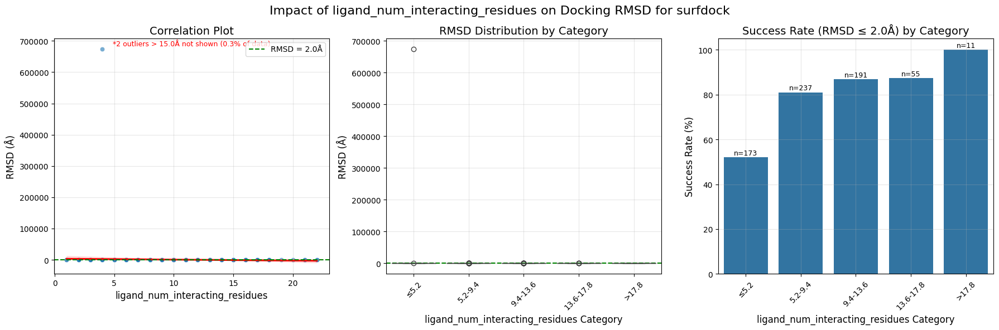


Success rates by category:
  ligand_num_interacting_residues_category  total_count  success_rate  \
0                                     ≤5.2          173     52.023121   
1                                  5.2-9.4          237     81.012658   
2                                 9.4-13.6          191     86.910995   
3                                13.6-17.8           55     87.272727   
4                                    >17.8           11    100.000000   

     mean_rmsd  
0  3899.728203  
1     1.484832  
2     1.398841  
3     1.398876  
4     1.252179  

ANOVA test: F=0.715, p=0.582129

Impact of ligand_num_neighboring_residues on Docking RMSD for surfdock
Pearson correlation: -0.0591, p-value: 0.126987
Spearman correlation: -0.2199, p-value: 0.000000


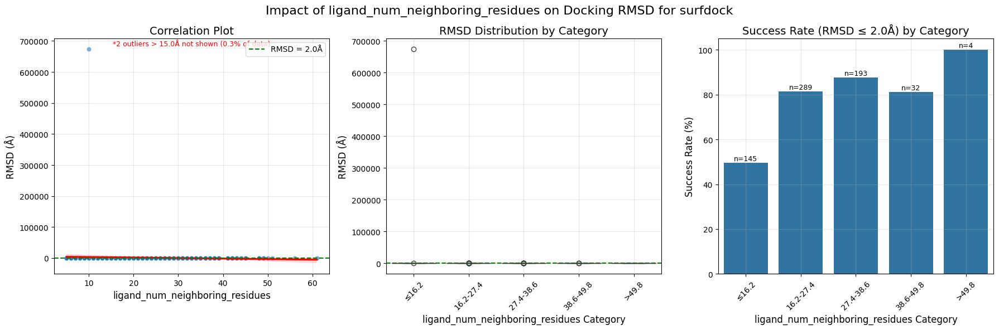


Success rates by category:
  ligand_num_neighboring_residues_category  total_count  success_rate  \
0                                    ≤16.2          145     49.655172   
1                                16.2-27.4          289     81.314879   
2                                27.4-38.6          193     87.564767   
3                                38.6-49.8           32     81.250000   
4                                    >49.8            4    100.000000   

     mean_rmsd  
0  4652.497382  
1     1.394774  
2     1.417592  
3     1.765043  
4     1.326241  

ANOVA test: F=0.895, p=0.466490

Impact of ligand_num_interactions on Docking RMSD for surfdock
Pearson correlation: -0.0491, p-value: 0.204755
Spearman correlation: -0.1947, p-value: 0.000000


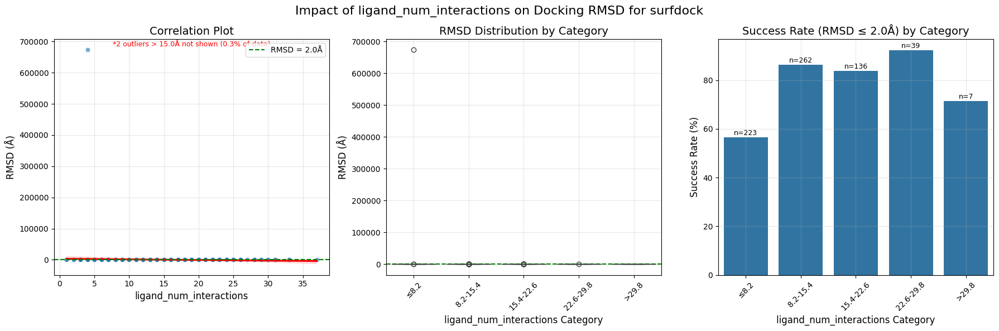


Success rates by category:
  ligand_num_interactions_category  total_count  success_rate    mean_rmsd
0                             ≤8.2          223     56.502242  3025.738008
1                         8.2-15.4          262     86.259542     1.347064
2                        15.4-22.6          136     83.823529     1.475067
3                        22.6-29.8           39     92.307692     1.485226
4                            >29.8            7     71.428571     1.676529

ANOVA test: F=0.498, p=0.737501


In [6]:
for prop in PLINDER_TEST_COLUMNS[2:]:
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_single_method(
        "surfdock", prop, prop_type,
    )

In [26]:
# get top 10 surfdock poses ranked by rmsd
df_combined[df_combined['method'] == 'surfdock'] \
    .sort_values(by='rmsd', ascending=False) \
    .head(10)[['protein', 'rmsd']]

,protein,rmsd
16095,7khx__1__1.B__1.E,673498.208906
14707,5fbc__1__1.A__1.E,19577.544870
14706,5fbc__1__1.A__1.E,7694.033984
14708,5fbc__1__1.A__1.E,5871.618307
14709,5fbc__1__1.A__1.E,1383.435231
14705,5fbc__1__1.A__1.E,709.635244
16373,8hq3__1__1.C__1.JA,13.701280
16407,6mcj__1__1.A__1.C,13.157408
16410,6mcj__1__1.A__1.C,13.061897
16406,6mcj__1__1.A__1.C,12.943928


#### diffdock_pocket_only


Impact of ligand_is_covalent on Docking RMSD for diffdock_pocket_only
Mann-Whitney U test p-value: 0.000000
Fisher's exact test p-value: 0.000000
Effect size (Cohen's d): 1.046

True group: 188 samples, mean RMSD = 15.68, success rate = 18.1%
False group: 731 samples, mean RMSD = 5.35, success rate = 54.7%


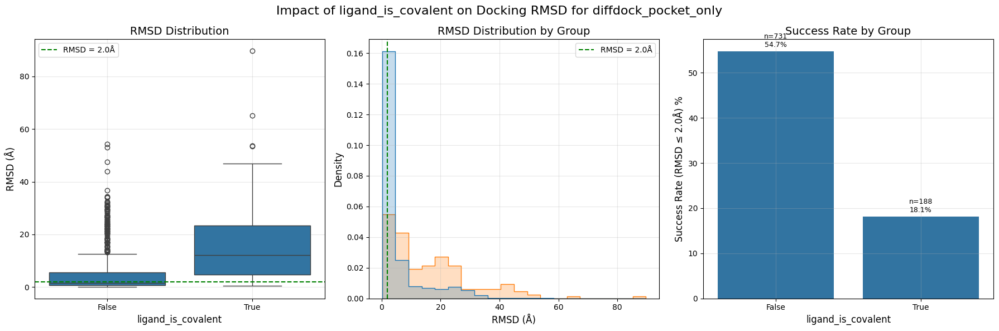


Impact of ligand_is_cofactor on Docking RMSD for diffdock_pocket_only
Mann-Whitney U test p-value: 0.056225
Fisher's exact test p-value: 0.038593
Effect size (Cohen's d): 0.228

True group: 94 samples, mean RMSD = 5.27, success rate = 57.4%
False group: 825 samples, mean RMSD = 7.71, success rate = 46.1%


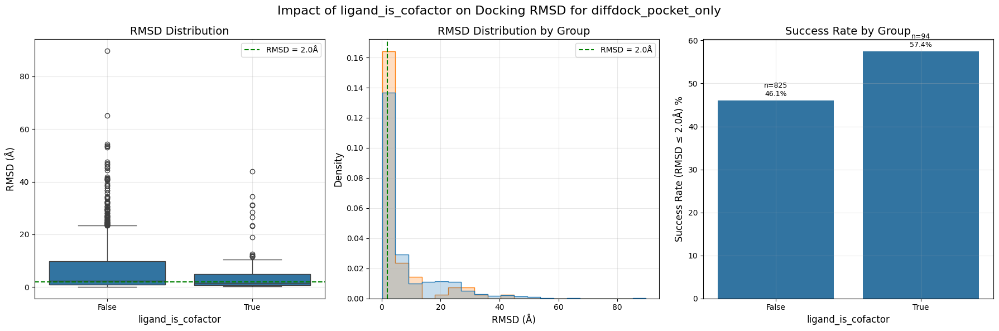


Impact of system_num_protein_chains on Docking RMSD for diffdock_pocket_only
Spearman correlation: -0.0041, p-value: 0.901673


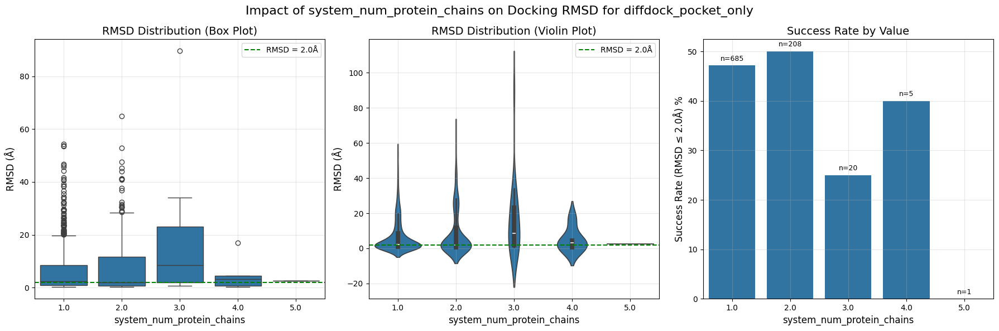


Success rates by discrete value:
  system_num_protein_chains  total_count  success_rate  mean_rmsd
0                       1.0          685     47.153285   6.864853
1                       2.0          208     50.000000   8.677788
2                       3.0           20     25.000000  16.203581
3                       4.0            5     40.000000   5.103846
4                       5.0            1      0.000000   2.668840

ANOVA test: F=4.713, p=0.000908
Significant differences in RMSD across system_num_protein_chains values

Impact of ligand_num_rot_bonds on Docking RMSD for diffdock_pocket_only
Spearman correlation: -0.0589, p-value: 0.074127


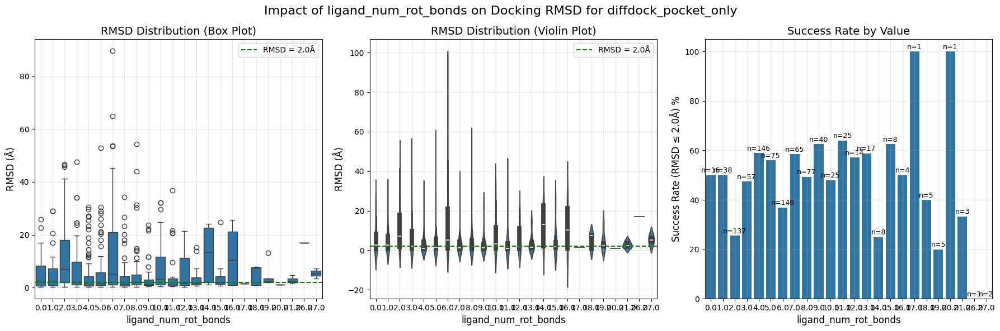


Success rates by discrete value:
   ligand_num_rot_bonds  total_count  success_rate  mean_rmsd
0                   0.0           16     50.000000   6.461236
1                   1.0           38     50.000000   5.665881
2                   2.0          137     25.547445  11.602230
3                   3.0           57     47.368421   7.463699
4                   4.0          146     58.904110   4.141033
5                   5.0           75     56.000000   5.893807
6                   6.0          149     36.912752  12.583729
7                   7.0           65     58.461538   4.247748
8                   8.0           77     49.350649   5.090339
9                   9.0           40     62.500000   3.879844
10                 10.0           25     48.000000   8.932896
11                 11.0           25     64.000000   5.394115
12                 12.0           14     57.142857   6.066893
13                 13.0           17     58.823529   3.686145
14                 14.0            8

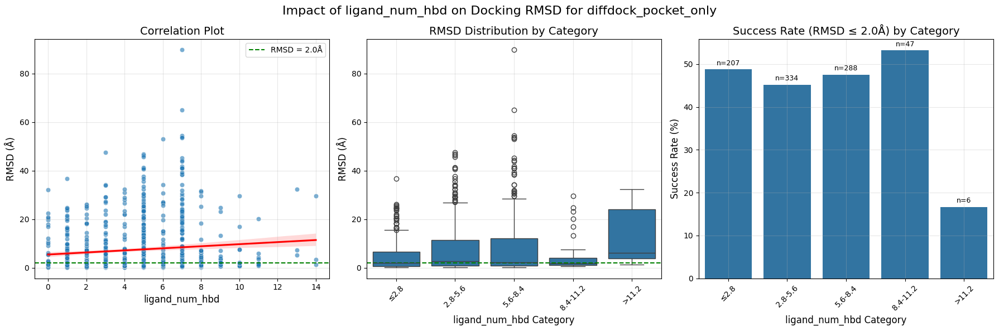


Success rates by category:
  ligand_num_hbd_category  total_count  success_rate  mean_rmsd
0                    ≤2.8          207     48.792271   5.174079
1                 2.8-5.6          334     45.209581   8.081092
2                 5.6-8.4          288     47.569444   8.844371
3                8.4-11.2           47     53.191489   4.779843
4                   >11.2            6     16.666667  13.233038

ANOVA test: F=5.006, p=0.000541
Significant differences in RMSD across ligand_num_hbd categories

Impact of ligand_num_hba on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.0031, p-value: 0.924423
Spearman correlation: 0.0041, p-value: 0.900203


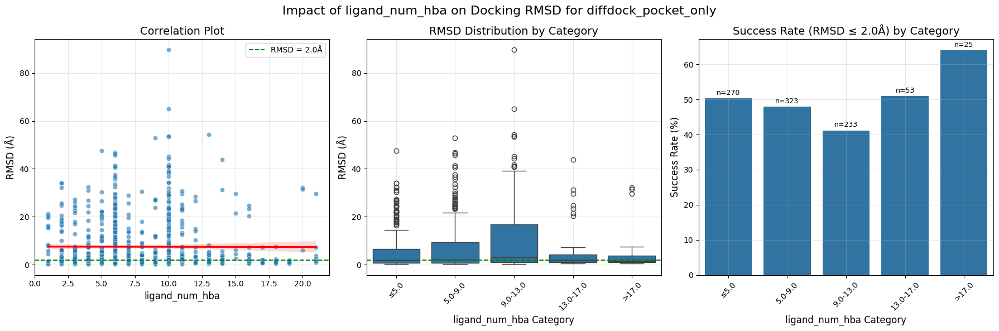


Success rates by category:
  ligand_num_hba_category  total_count  success_rate  mean_rmsd
0                    ≤5.0          270     50.370370   5.756006
1                 5.0-9.0          323     47.987616   7.249099
2                9.0-13.0          233     41.201717  10.155010
3               13.0-17.0           53     50.943396   5.609559
4                   >17.0           25     64.000000   5.648863

ANOVA test: F=6.087, p=0.000078
Significant differences in RMSD across ligand_num_hba categories

Impact of ligand_num_rings on Docking RMSD for diffdock_pocket_only
Spearman correlation: -0.1654, p-value: 0.000000


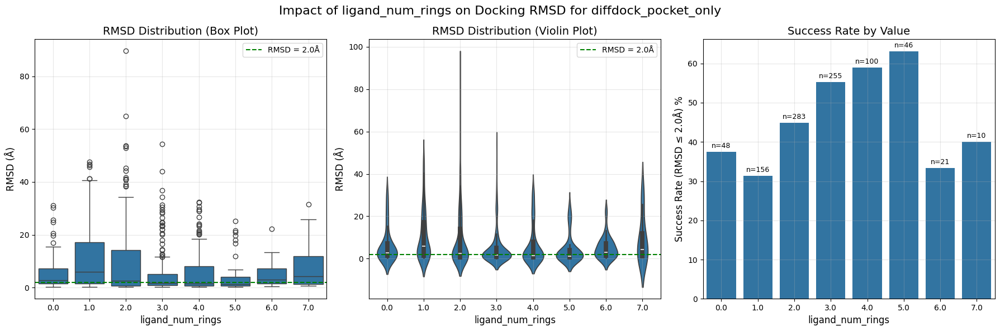


Success rates by discrete value:
  ligand_num_rings  total_count  success_rate  mean_rmsd
0              0.0           48     37.500000   6.499795
1              1.0          156     31.410256  10.952879
2              2.0          283     44.876325   8.972805
3              3.0          255     55.294118   4.954434
4              4.0          100     59.000000   6.304753
5              5.0           46     63.043478   4.423135
6              6.0           21     33.333333   5.234678
7              7.0           10     40.000000   9.247185

ANOVA test: F=6.328, p=0.000000
Significant differences in RMSD across ligand_num_rings values

Impact of entry_resolution on Docking RMSD for diffdock_pocket_only
Pearson correlation: 0.1013, p-value: 0.002099
Spearman correlation: 0.1538, p-value: 0.000003


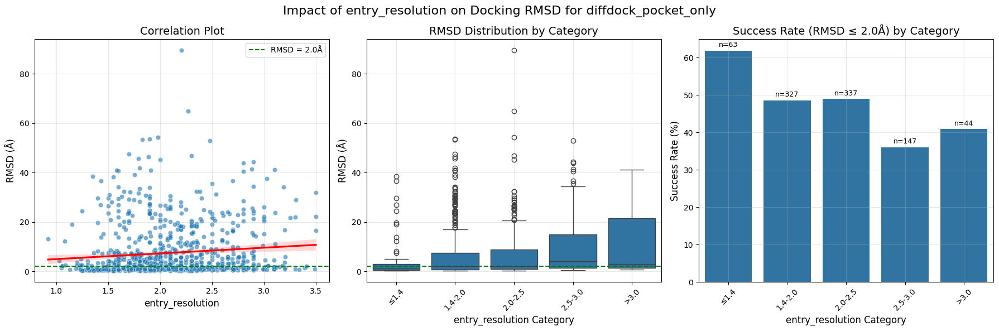


Success rates by category:
  entry_resolution_category  total_count  success_rate  mean_rmsd
0                      ≤1.4           63     61.904762   4.837859
1                   1.4-2.0          327     48.623853   7.518932
2                   2.0-2.5          337     48.961424   6.657979
3                   2.5-3.0          147     36.054422   9.293670
4                      >3.0           44     40.909091  10.751190

ANOVA test: F=3.567, p=0.006763
Significant differences in RMSD across entry_resolution categories

Impact of entry_validation_molprobity on Docking RMSD for diffdock_pocket_only
Pearson correlation: 0.0536, p-value: 0.104671
Spearman correlation: 0.0548, p-value: 0.096775


/Users/aoxu/projects/DrugDiscovery/PoseBench/notebooks/plinder_analysis_utils.py:1380: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[property_category] = pd.cut(df[property_name], bins=bins, labels=bin_labels)


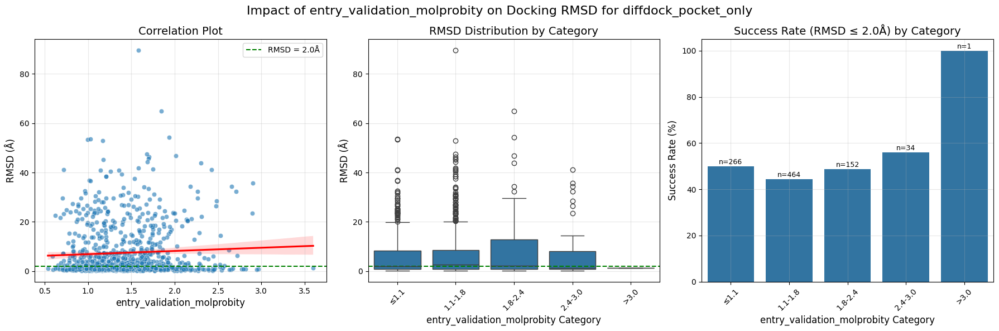


Success rates by category:
  entry_validation_molprobity_category  total_count  success_rate  mean_rmsd
0                                 ≤1.1          266     50.000000   7.104912
1                              1.1-1.8          464     44.396552   7.447456
2                              1.8-2.4          152     48.684211   8.029288
3                              2.4-3.0           34     55.882353   8.393896
4                                 >3.0            1    100.000000   1.242592

ANOVA test: F=0.327, p=0.859812

Impact of system_num_pocket_residues on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.3318, p-value: 0.000000
Spearman correlation: -0.3727, p-value: 0.000000


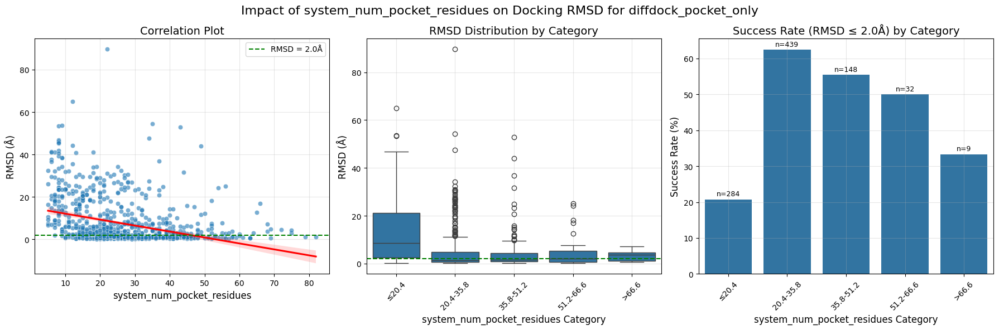


Success rates by category:
  system_num_pocket_residues_category  total_count  success_rate  mean_rmsd
0                               ≤20.4          284     20.774648  13.360832
1                           20.4-35.8          439     62.414579   4.818903
2                           35.8-51.2          148     55.405405   4.403884
3                           51.2-66.6           32     50.000000   4.949426
4                               >66.6            9     33.333333   3.388231

ANOVA test: F=37.114, p=0.000000
Significant differences in RMSD across system_num_pocket_residues categories

Impact of system_num_interactions on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.3161, p-value: 0.000000
Spearman correlation: -0.4083, p-value: 0.000000


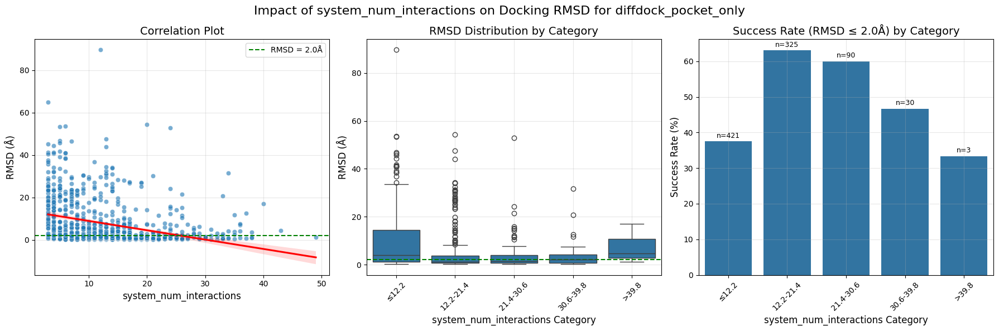


Success rates by category:
  system_num_interactions_category  total_count  success_rate  mean_rmsd
0                            ≤12.2          421     37.529691   9.191068
1                        12.2-21.4          325     63.076923   4.677444
2                        21.4-30.6           90     60.000000   3.952931
3                        30.6-39.8           30     46.666667   4.540081
4                            >39.8            3     33.333333   7.594502

ANOVA test: F=12.057, p=0.000000
Significant differences in RMSD across system_num_interactions categories

Impact of ligand_molecular_weight on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.0851, p-value: 0.009847
Spearman correlation: -0.0505, p-value: 0.125833


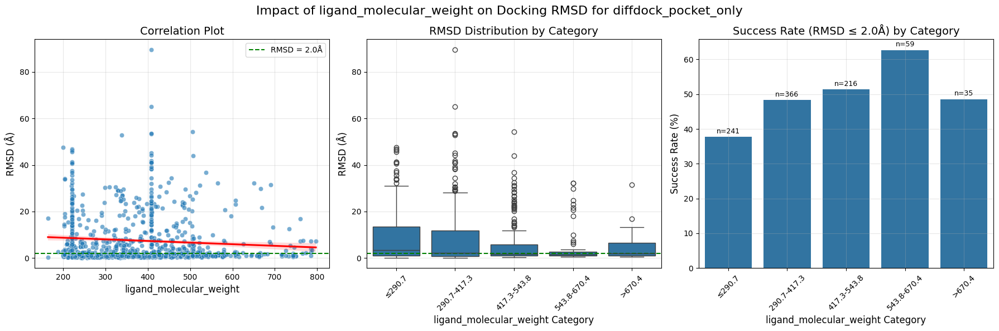


Success rates by category:
  ligand_molecular_weight_category  total_count  success_rate  mean_rmsd
0                           ≤290.7          241     37.759336   8.620724
1                      290.7-417.3          366     48.360656   8.256445
2                      417.3-543.8          216     51.388889   5.921715
3                      543.8-670.4           59     62.711864   5.068694
4                           >670.4           35     48.571429   4.703905

ANOVA test: F=3.677, p=0.005592
Significant differences in RMSD across ligand_molecular_weight categories

Impact of ligand_crippen_clogp on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.1682, p-value: 0.000000
Spearman correlation: -0.1515, p-value: 0.000004


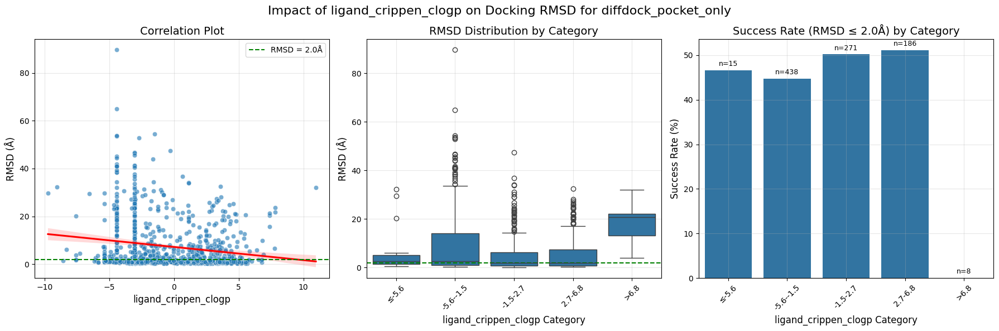


Success rates by category:
  ligand_crippen_clogp_category  total_count  success_rate  mean_rmsd
0                         ≤-5.6           15     46.666667   7.426930
1                     -5.6--1.5          438     44.748858   9.228234
2                      -1.5-2.7          271     50.184502   5.377546
3                       2.7-6.8          186     51.075269   5.775518
4                          >6.8            8      0.000000  18.127074

ANOVA test: F=9.003, p=0.000000
Significant differences in RMSD across ligand_crippen_clogp categories

Impact of ligand_num_interacting_residues on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.3668, p-value: 0.000000
Spearman correlation: -0.4641, p-value: 0.000000


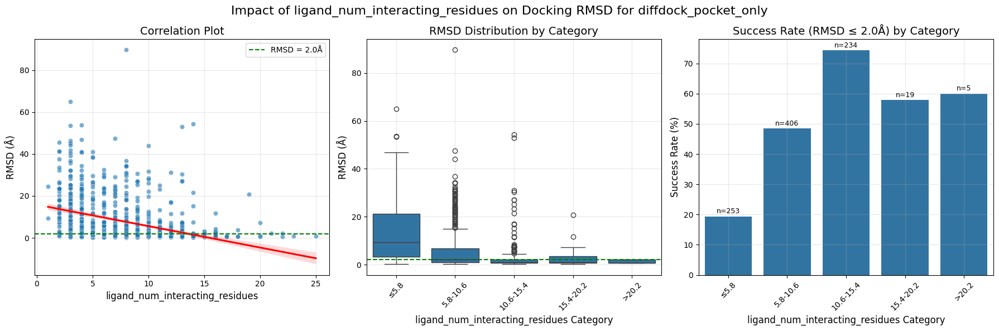


Success rates by category:
  ligand_num_interacting_residues_category  total_count  success_rate  \
0                                     ≤5.8          253     19.367589   
1                                 5.8-10.6          406     48.522167   
2                                10.6-15.4          234     74.358974   
3                                15.4-20.2           19     57.894737   
4                                    >20.2            5     60.000000   

   mean_rmsd  
0  13.815710  
1   6.224779  
2   3.129167  
3   3.400566  
4   1.276699  

ANOVA test: F=40.115, p=0.000000
Significant differences in RMSD across ligand_num_interacting_residues categories

Impact of ligand_num_neighboring_residues on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.4091, p-value: 0.000000
Spearman correlation: -0.4610, p-value: 0.000000


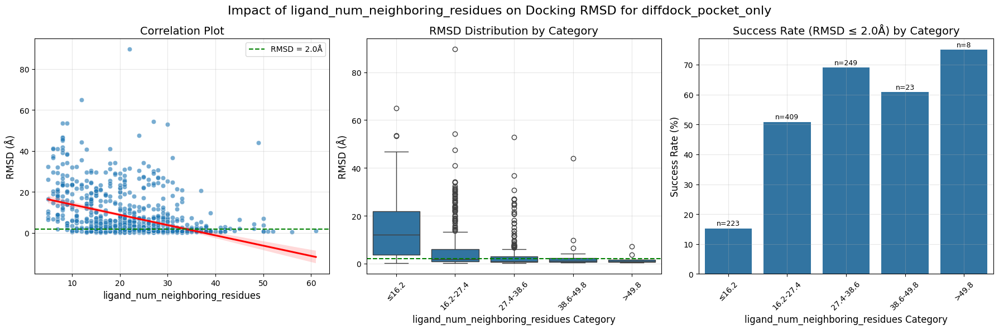


Success rates by category:
  ligand_num_neighboring_residues_category  total_count  success_rate  \
0                                    ≤16.2          223     15.246637   
1                                16.2-27.4          409     50.855746   
2                                27.4-38.6          249     69.076305   
3                                38.6-49.8           23     60.869565   
4                                    >49.8            8     75.000000   

   mean_rmsd  
0  14.728856  
1   5.986731  
2   3.664433  
3   3.885330  
4   1.963896  

ANOVA test: F=43.467, p=0.000000
Significant differences in RMSD across ligand_num_neighboring_residues categories

Impact of ligand_num_interactions on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.3449, p-value: 0.000000
Spearman correlation: -0.4434, p-value: 0.000000


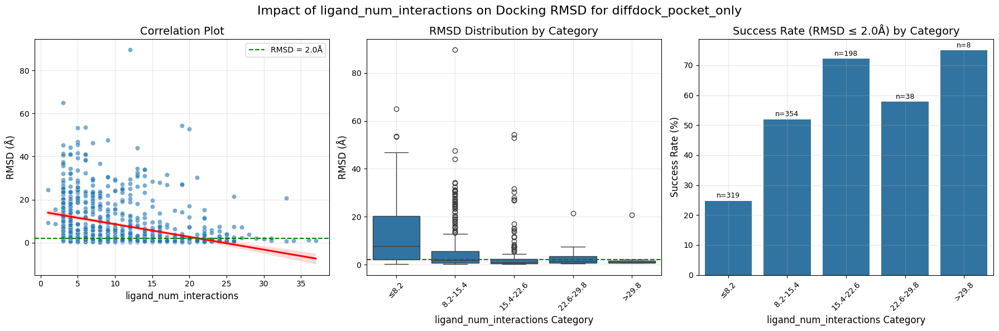


Success rates by category:
  ligand_num_interactions_category  total_count  success_rate  mean_rmsd
0                             ≤8.2          319     24.764890  12.456754
1                         8.2-15.4          354     51.977401   5.753013
2                        15.4-22.6          198     72.222222   3.430726
3                        22.6-29.8           38     57.894737   2.829218
4                            >29.8            8     75.000000   3.598605

ANOVA test: F=32.574, p=0.000000
Significant differences in RMSD across ligand_num_interactions categories


In [16]:
for prop in PLINDER_TEST_COLUMNS[2:]:
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_single_method(
        "diffdock_pocket_only", prop, prop_type,
    )

#### chai-1


Impact of ligand_is_covalent on Docking RMSD for chai-1
Mann-Whitney U test p-value: 0.000000
Fisher's exact test p-value: 0.001547
Effect size (Cohen's d): 0.647

True group: 169 samples, mean RMSD = 14.43, success rate = 35.5%
False group: 733 samples, mean RMSD = 7.22, success rate = 49.0%


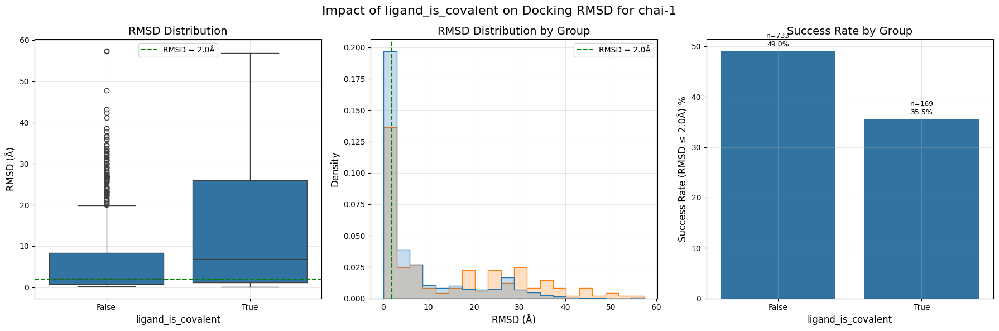


Impact of ligand_is_cofactor on Docking RMSD for chai-1
Mann-Whitney U test p-value: 0.000410
Fisher's exact test p-value: 0.000691
Effect size (Cohen's d): 0.198

True group: 95 samples, mean RMSD = 6.53, success rate = 63.2%
False group: 807 samples, mean RMSD = 8.81, success rate = 44.5%


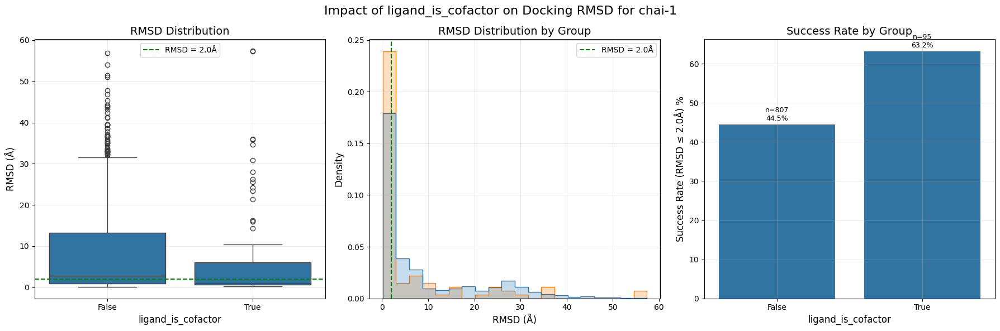


Impact of system_num_protein_chains on Docking RMSD for chai-1
Spearman correlation: 0.2538, p-value: 0.000000


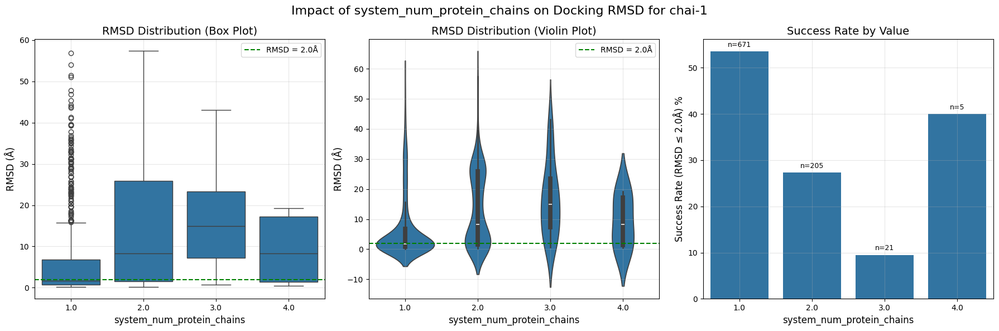


Success rates by discrete value:
  system_num_protein_chains  total_count  success_rate  mean_rmsd
0                       1.0          671     53.502235   6.833964
1                       2.0          205     27.317073  13.398293
2                       3.0           21      9.523810  16.625666
3                       4.0            5     40.000000   9.305209

ANOVA test: F=22.008, p=0.000000
Significant differences in RMSD across system_num_protein_chains values

Impact of ligand_num_rot_bonds on Docking RMSD for chai-1
Spearman correlation: -0.0349, p-value: 0.294873


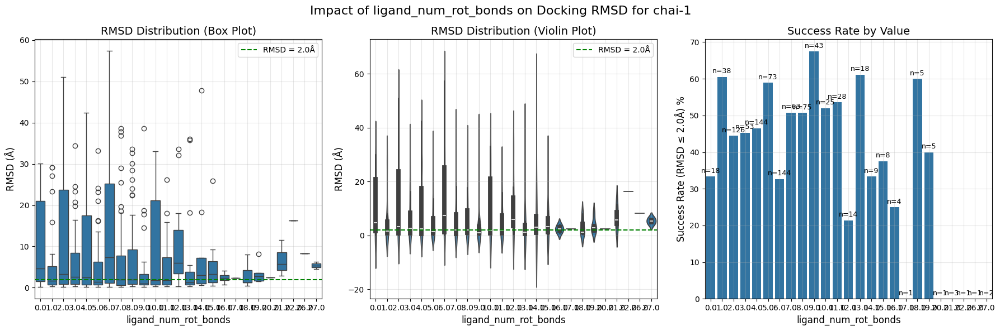


Success rates by discrete value:
   ligand_num_rot_bonds  total_count  success_rate  mean_rmsd
0                   0.0           18     33.333333  11.018469
1                   1.0           38     60.526316   5.192187
2                   2.0          126     44.444444  11.448985
3                   3.0           53     45.283019   6.345522
4                   4.0          144     46.527778   8.645580
5                   5.0           73     58.904110   4.694824
6                   6.0          144     32.638889  14.323612
7                   7.0           63     50.793651   6.416762
8                   8.0           75     50.666667   6.267285
9                   9.0           43     67.441860   3.632342
10                 10.0           25     52.000000   9.037389
11                 11.0           28     53.571429   5.286101
12                 12.0           14     21.428571  10.223596
13                 13.0           18     61.111111   6.349162
14                 14.0            9

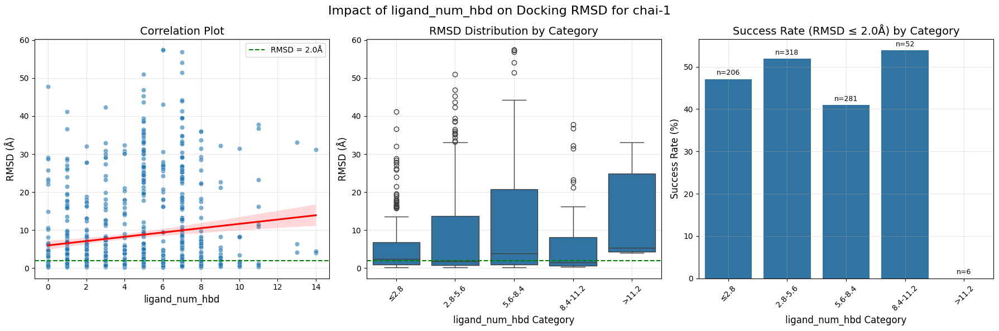


Success rates by category:
  ligand_num_hbd_category  total_count  success_rate  mean_rmsd
0                    ≤2.8          206     47.087379   5.651855
1                 2.8-5.6          318     51.886792   8.644430
2                 5.6-8.4          281     40.925267  10.956038
3                8.4-11.2           52     53.846154   6.390849
4                   >11.2            6      0.000000  13.843500

ANOVA test: F=7.278, p=0.000009
Significant differences in RMSD across ligand_num_hbd categories

Impact of ligand_num_hba on Docking RMSD for chai-1
Pearson correlation: 0.0703, p-value: 0.034791
Spearman correlation: 0.0444, p-value: 0.182936


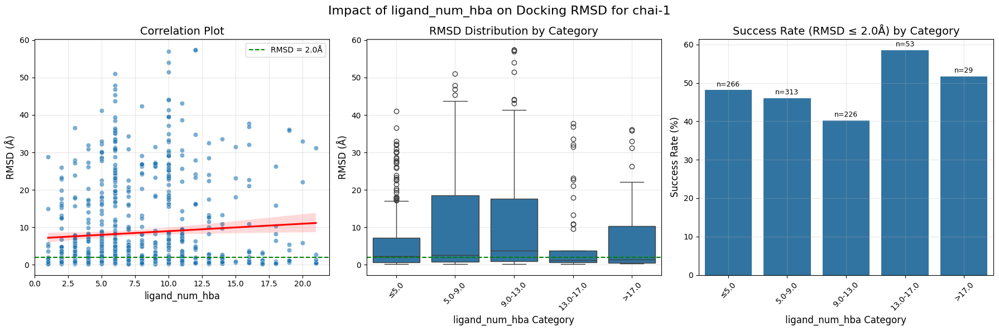


Success rates by category:
  ligand_num_hba_category  total_count  success_rate  mean_rmsd
0                    ≤5.0          266     48.120301   6.232137
1                 5.0-9.0          313     46.006390   9.549443
2                9.0-13.0          226     40.265487  10.647030
3               13.0-17.0           53     58.490566   6.675143
4                   >17.0           29     51.724138   8.769518

ANOVA test: F=5.581, p=0.000194
Significant differences in RMSD across ligand_num_hba categories

Impact of ligand_num_rings on Docking RMSD for chai-1
Spearman correlation: -0.1085, p-value: 0.001096


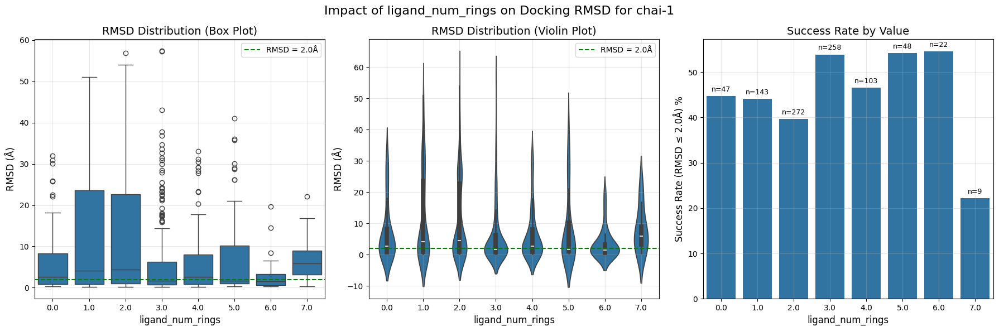


Success rates by discrete value:
  ligand_num_rings  total_count  success_rate  mean_rmsd
0              0.0           47     44.680851   7.322724
1              1.0          143     44.055944  11.726887
2              2.0          272     39.705882  10.852914
3              3.0          258     53.875969   6.014252
4              4.0          103     46.601942   6.348753
5              5.0           48     54.166667   8.326550
6              6.0           22     54.545455   3.549636
7              7.0            9     22.222222   7.937109

ANOVA test: F=6.376, p=0.000000
Significant differences in RMSD across ligand_num_rings values

Impact of entry_resolution on Docking RMSD for chai-1
Pearson correlation: 0.0071, p-value: 0.830538
Spearman correlation: 0.0733, p-value: 0.027634


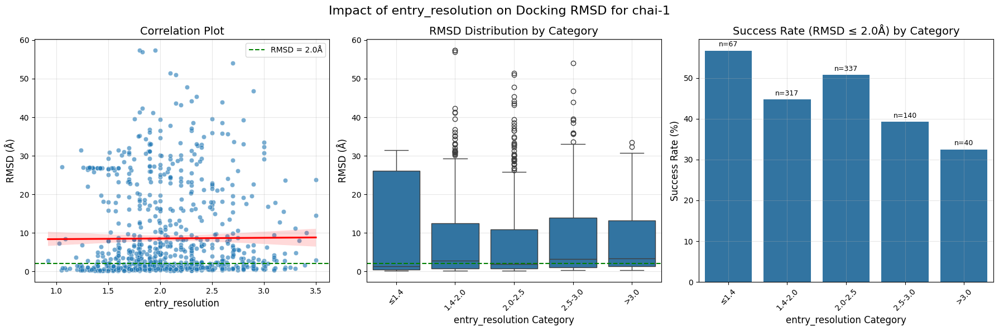


Success rates by category:
  entry_resolution_category  total_count  success_rate  mean_rmsd
0                      ≤1.4           67     56.716418   8.999513
1                   1.4-2.0          317     44.794953   8.671821
2                   2.0-2.5          337     50.741840   8.261743
3                   2.5-3.0          140     39.285714   8.894363
4                      >3.0           40     32.500000   8.593332

ANOVA test: F=0.117, p=0.976383

Impact of entry_validation_molprobity on Docking RMSD for chai-1
Pearson correlation: 0.0324, p-value: 0.331445
Spearman correlation: 0.0524, p-value: 0.115707


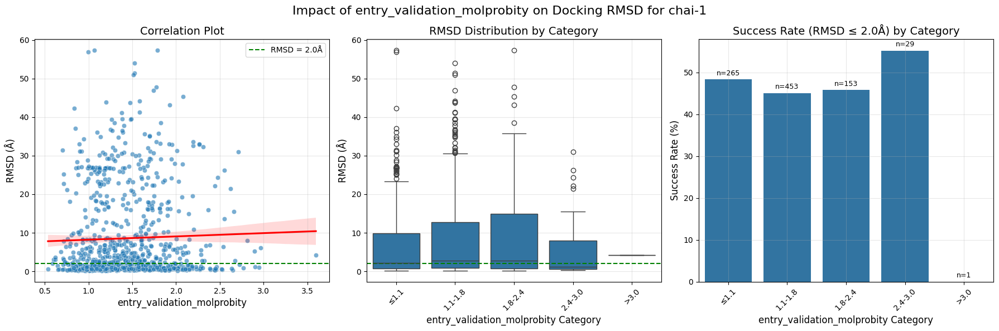


Success rates by category:
  entry_validation_molprobity_category  total_count  success_rate  mean_rmsd
0                                 ≤1.1          265     48.301887   7.922392
1                              1.1-1.8          453     45.033113   8.925711
2                              1.8-2.4          153     45.751634   9.013922
3                              2.4-3.0           29     55.172414   6.934565
4                                 >3.0            1      0.000000   4.247307

ANOVA test: F=0.555, p=0.695057

Impact of system_num_pocket_residues on Docking RMSD for chai-1
Pearson correlation: -0.2656, p-value: 0.000000
Spearman correlation: -0.2797, p-value: 0.000000


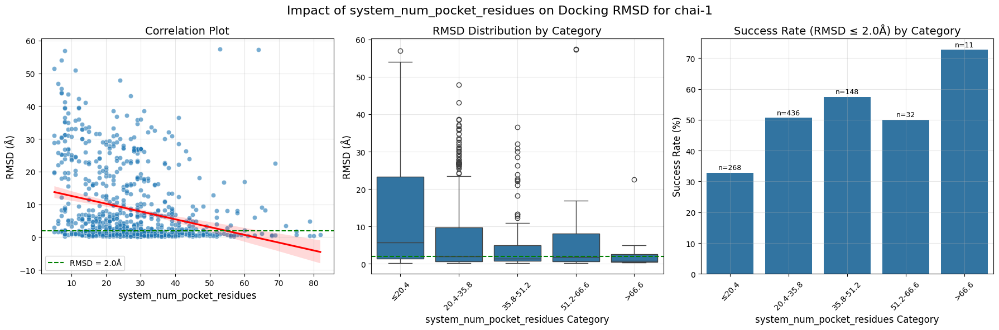


Success rates by category:
  system_num_pocket_residues_category  total_count  success_rate  mean_rmsd
0                               ≤20.4          268     32.835821  12.738211
1                           20.4-35.8          436     50.688073   7.360613
2                           35.8-51.2          148     57.432432   4.598245
3                           51.2-66.6           32     50.000000   7.261164
4                               >66.6           11     72.727273   3.327129

ANOVA test: F=16.404, p=0.000000
Significant differences in RMSD across system_num_pocket_residues categories

Impact of system_num_interactions on Docking RMSD for chai-1
Pearson correlation: -0.2022, p-value: 0.000000
Spearman correlation: -0.2706, p-value: 0.000000


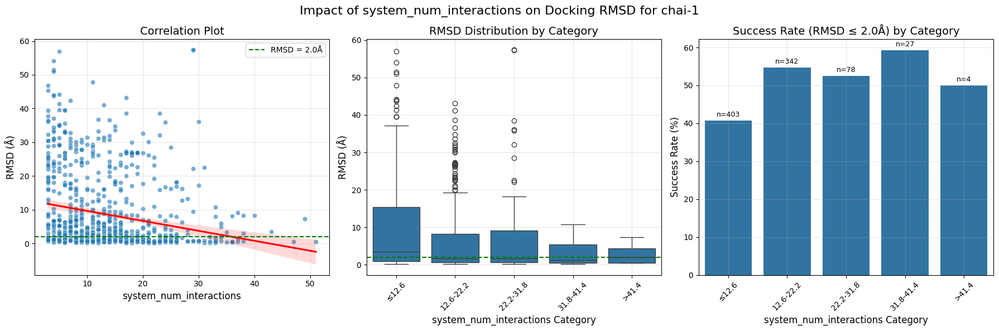


Success rates by category:
  system_num_interactions_category  total_count  success_rate  mean_rmsd
0                            ≤12.6          403     40.694789   9.552971
1                        12.6-22.2          342     54.678363   6.874944
2                        22.2-31.8           78     52.564103   7.793680
3                        31.8-41.4           27     59.259259   3.068072
4                            >41.4            4     50.000000   2.922601

ANOVA test: F=4.362, p=0.001695
Significant differences in RMSD across system_num_interactions categories

Impact of ligand_molecular_weight on Docking RMSD for chai-1
Pearson correlation: -0.0771, p-value: 0.020493
Spearman correlation: -0.0047, p-value: 0.887241


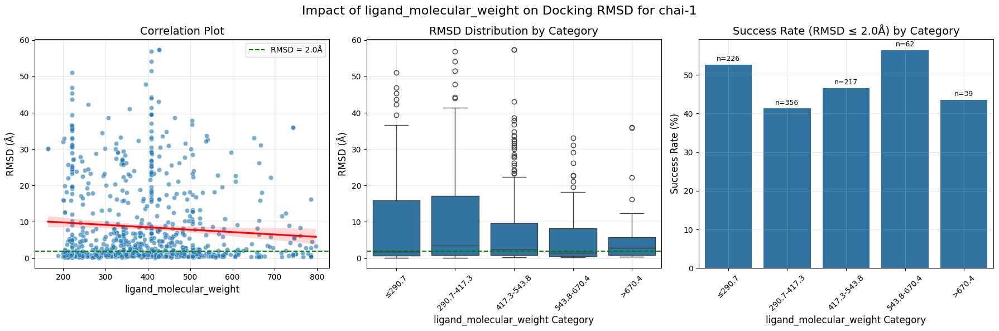


Success rates by category:
  ligand_molecular_weight_category  total_count  success_rate  mean_rmsd
0                           ≤290.7          226     52.654867   8.779452
1                      290.7-417.3          356     41.292135   9.683656
2                      417.3-543.8          217     46.543779   7.531513
3                      543.8-670.4           62     56.451613   6.130691
4                           >670.4           39     43.589744   5.685457

ANOVA test: F=2.634, p=0.032988
Significant differences in RMSD across ligand_molecular_weight categories

Impact of ligand_crippen_clogp on Docking RMSD for chai-1
Pearson correlation: -0.2248, p-value: 0.000000
Spearman correlation: -0.1368, p-value: 0.000038


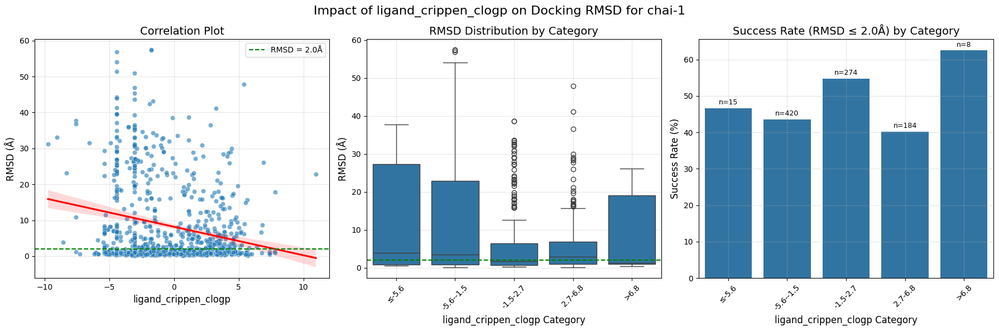


Success rates by category:
  ligand_crippen_clogp_category  total_count  success_rate  mean_rmsd
0                         ≤-5.6           15     46.666667  12.485684
1                     -5.6--1.5          420     43.571429  11.164585
2                      -1.5-2.7          274     54.744526   5.953498
3                       2.7-6.8          184     40.217391   6.073288
4                          >6.8            8     62.500000   8.950131

ANOVA test: F=12.091, p=0.000000
Significant differences in RMSD across ligand_crippen_clogp categories

Impact of ligand_num_interacting_residues on Docking RMSD for chai-1
Pearson correlation: -0.2079, p-value: 0.000000
Spearman correlation: -0.2887, p-value: 0.000000


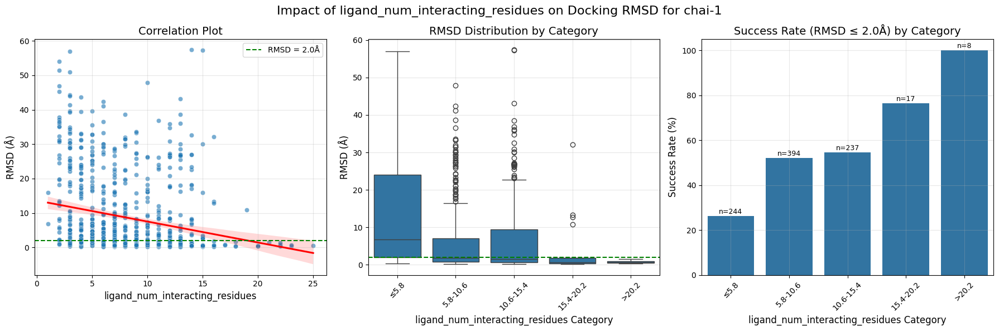


Success rates by category:
  ligand_num_interacting_residues_category  total_count  success_rate  \
0                                     ≤5.8          244     26.229508   
1                                 5.8-10.6          394     52.030457   
2                                10.6-15.4          237     54.430380   
3                                15.4-20.2           17     76.470588   
4                                    >20.2            8    100.000000   

   mean_rmsd  
0  13.568221  
1   6.174847  
2   7.922969  
3   4.572523  
4   0.765288  

ANOVA test: F=18.747, p=0.000000
Significant differences in RMSD across ligand_num_interacting_residues categories

Impact of ligand_num_neighboring_residues on Docking RMSD for chai-1
Pearson correlation: -0.2900, p-value: 0.000000
Spearman correlation: -0.3085, p-value: 0.000000


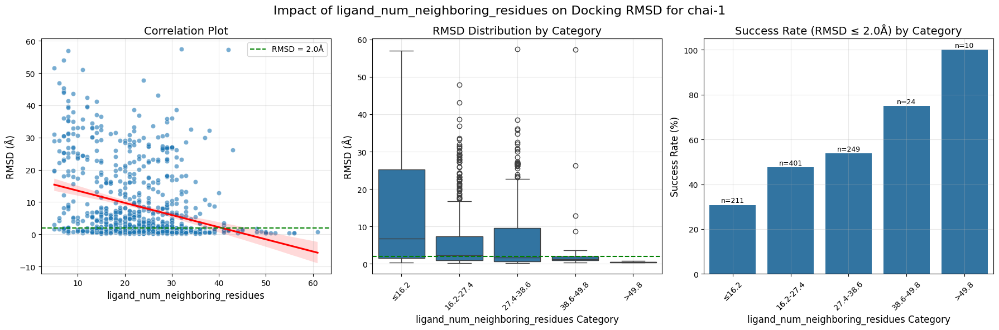


Success rates by category:
  ligand_num_neighboring_residues_category  total_count  success_rate  \
0                                    ≤16.2          211     30.805687   
1                                16.2-27.4          401     47.630923   
2                                27.4-38.6          249     53.815261   
3                                38.6-49.8           24     75.000000   
4                                    >49.8           10    100.000000   

   mean_rmsd  
0  14.196450  
1   6.362791  
2   7.590420  
3   5.443958  
4   0.496398  

ANOVA test: F=20.385, p=0.000000
Significant differences in RMSD across ligand_num_neighboring_residues categories

Impact of ligand_num_interactions on Docking RMSD for chai-1
Pearson correlation: -0.1871, p-value: 0.000000
Spearman correlation: -0.2777, p-value: 0.000000


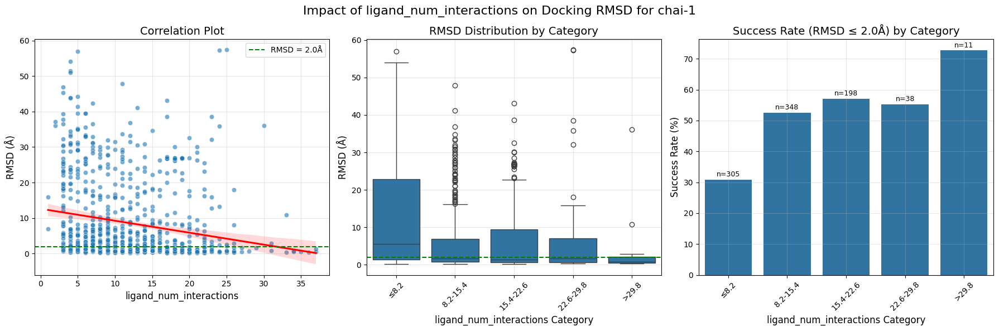


Success rates by category:
  ligand_num_interactions_category  total_count  success_rate  mean_rmsd
0                             ≤8.2          305     30.819672  12.242254
1                         8.2-15.4          348     52.586207   6.041397
2                        15.4-22.6          198     57.070707   7.514129
3                        22.6-29.8           38     55.263158   8.585422
4                            >29.8           11     72.727273   4.981577

ANOVA test: F=13.328, p=0.000000
Significant differences in RMSD across ligand_num_interactions categories


In [15]:
for prop in PLINDER_TEST_COLUMNS[2:]:
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_single_method(
        "chai-1", prop, prop_type,
    )

### Property Comparative Analysis

In [10]:
# 3. Compare how properties affect different methods
for prop in PLINDER_TEST_COLUMNS[2:]:
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_comparative(
        "diffdock_pocket_only", "chai-1", prop, prop_type
    )

Analyzing ligand_is_covalent effects on diffdock_pocket_only vs chai-1
Common proteins: 875


AttributeError: 'PropertyAnalysis' object has no attribute '_analyze_binary_property_comparative'

### Property Universal Analysis

Analyzing ligand_is_covalent for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of binary property 'ligand_is_covalent':
Success cases: n=650, True=6.2%, False=93.8%
Failure cases: n=330, True=60.6%, False=39.4%
Difference in 'True' proportion: -54.5%
Fisher's exact test: p=0.000000
Odds ratio: 0.04


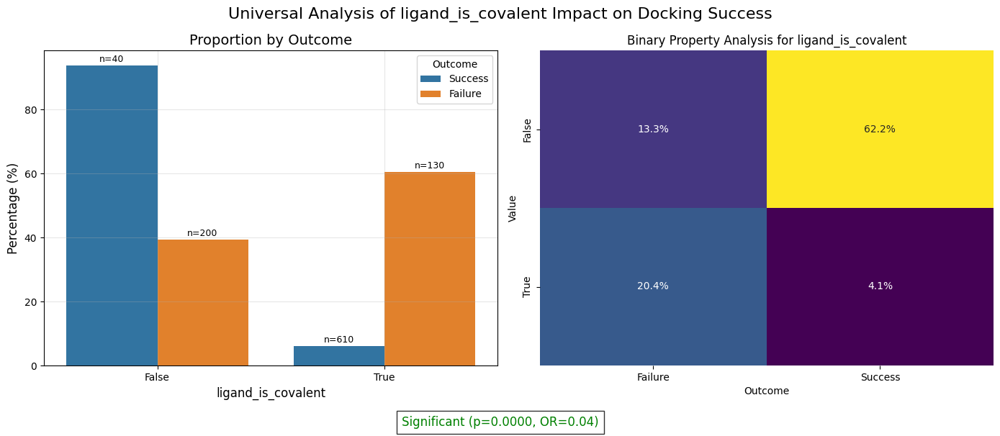

Analyzing ligand_is_ion for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of binary property 'ligand_is_ion':
Success cases: n=650, True=0.0%, False=100.0%
Failure cases: n=330, True=0.0%, False=100.0%
Difference in 'True' proportion: 0.0%
Fisher's exact test: p=1.000000
Odds ratio: 0.00


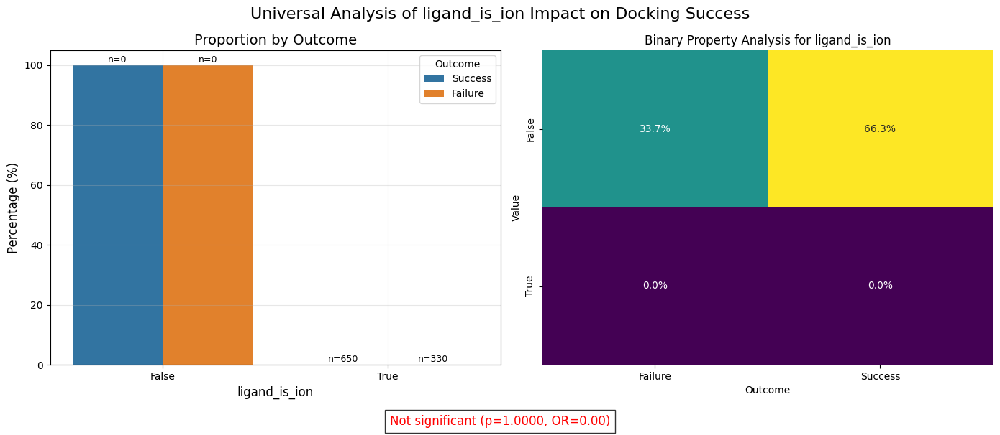

Analyzing ligand_is_cofactor for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of binary property 'ligand_is_cofactor':
Success cases: n=650, True=14.6%, False=85.4%
Failure cases: n=330, True=1.5%, False=98.5%
Difference in 'True' proportion: 13.1%
Fisher's exact test: p=0.000000
Odds ratio: 11.13


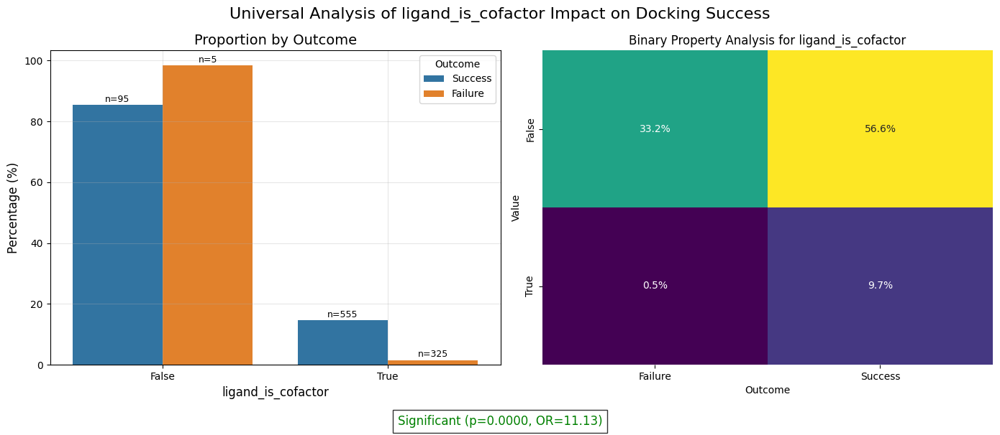

Analyzing ligand_is_artifact for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of binary property 'ligand_is_artifact':
Success cases: n=650, True=0.0%, False=100.0%
Failure cases: n=330, True=0.0%, False=100.0%
Difference in 'True' proportion: 0.0%
Fisher's exact test: p=1.000000
Odds ratio: 0.00


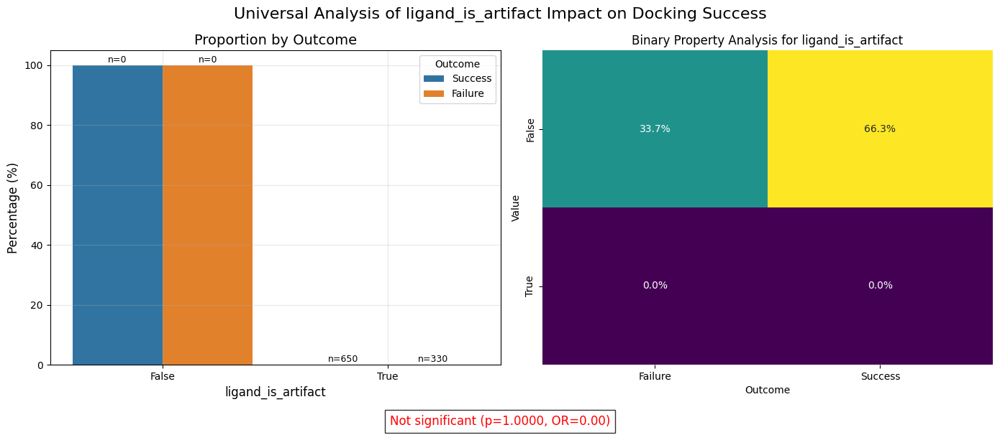

Analyzing system_num_protein_chains for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of discrete property 'system_num_protein_chains':
Categories: [1.0, 2.0, 3.0, 4.0]
Counts (success vs failure):
  system_num_protein_chains  success_count  failure_count
0                       1.0            550            250
1                       2.0            100             65
2                       3.0              0             10
3                       4.0              0              5
Chi-square test: statistic=34.067, p-value=0.000000
Significant distribution difference between success and failure groups.


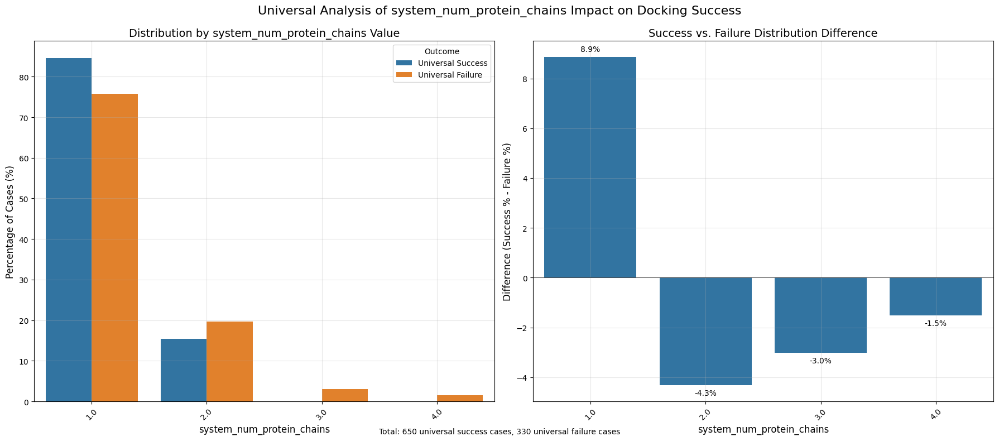

Analyzing ligand_num_rot_bonds for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'ligand_num_rot_bonds':
Success cases: n=650, mean=6.015, std=3.066
Failure cases: n=330, mean=7.697, std=5.560
Mann-Whitney U test: p=0.000464
Effect size (Cohen's d): 0.412
Chi-square test for distribution: p=0.000000


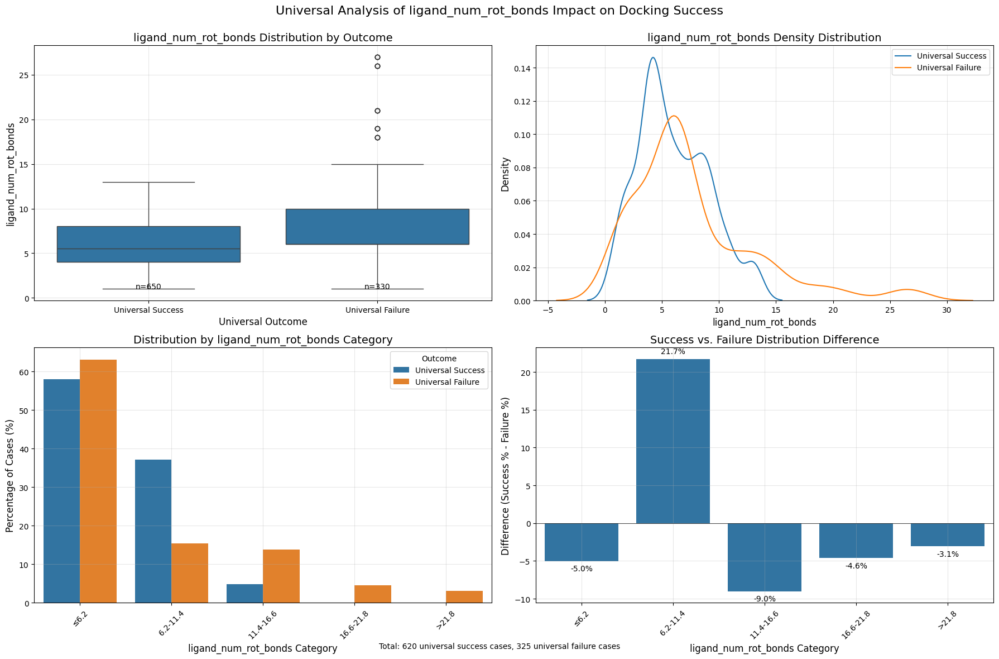

Analyzing ligand_num_hbd for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'ligand_num_hbd':
Success cases: n=650, mean=4.446, std=2.565
Failure cases: n=330, mean=6.136, std=2.390
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 0.674
Chi-square test for distribution: p=0.000000


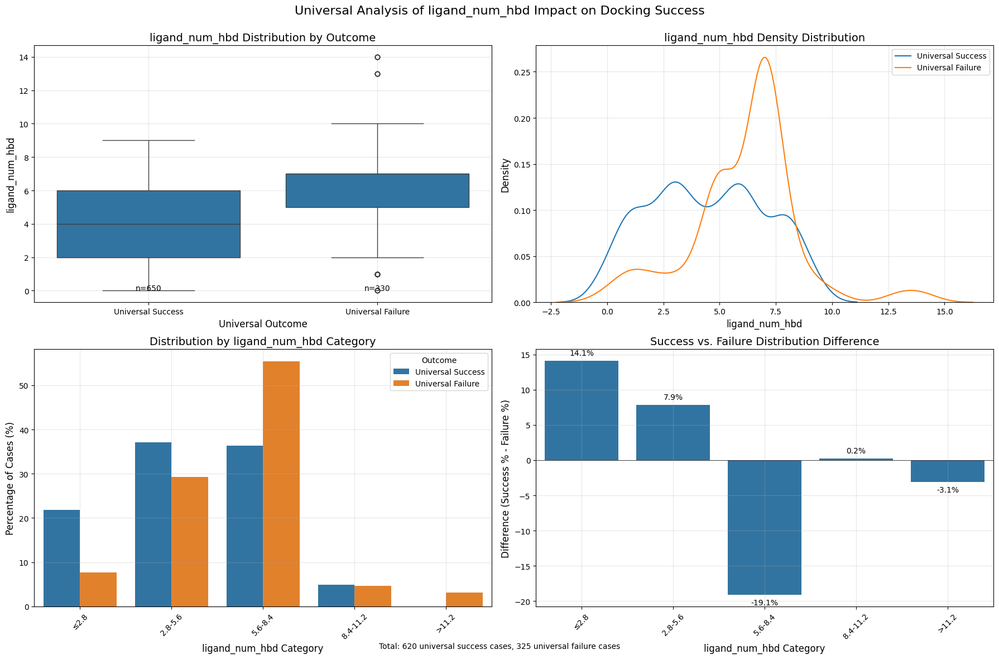

Analyzing ligand_num_hba for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'ligand_num_hba':
Success cases: n=650, mean=8.369, std=4.375
Failure cases: n=330, mean=8.439, std=3.030
Mann-Whitney U test: p=0.023627
Effect size (Cohen's d): 0.018
Chi-square test for distribution: p=0.000000


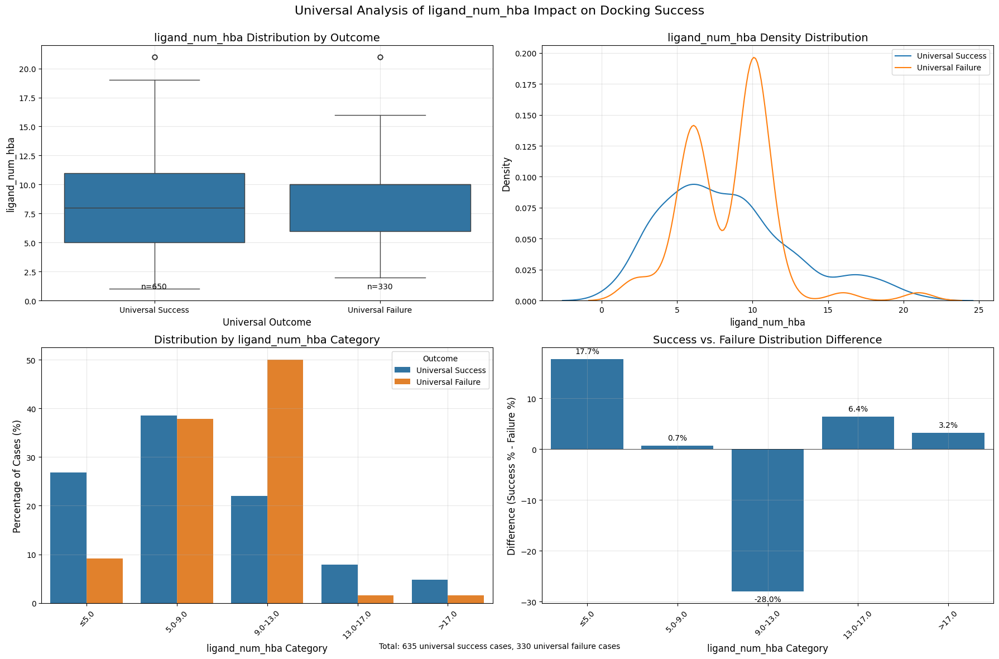

Analyzing ligand_num_rings for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of discrete property 'ligand_num_rings':
Categories: [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0]
Counts (success vs failure):
  ligand_num_rings  success_count  failure_count
0              0.0             25             50
1              1.0             60             85
2              2.0            180            155
3              3.0            205             30
4              4.0             90              5
5              5.0             65              0
6              6.0             20              5
7              7.0              5              0
Chi-square test: statistic=218.711, p-value=0.000000
Significant distribution difference between success and failure groups.


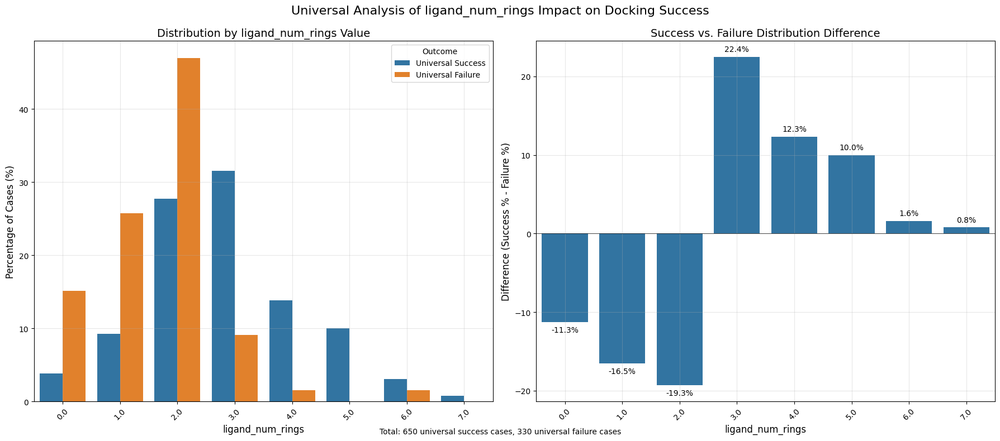

Analyzing entry_resolution for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'entry_resolution':
Success cases: n=650, mean=2.115, std=0.460
Failure cases: n=330, mean=2.142, std=0.489
Mann-Whitney U test: p=0.515132
Effect size (Cohen's d): 0.057
Chi-square test for distribution: p=0.196012


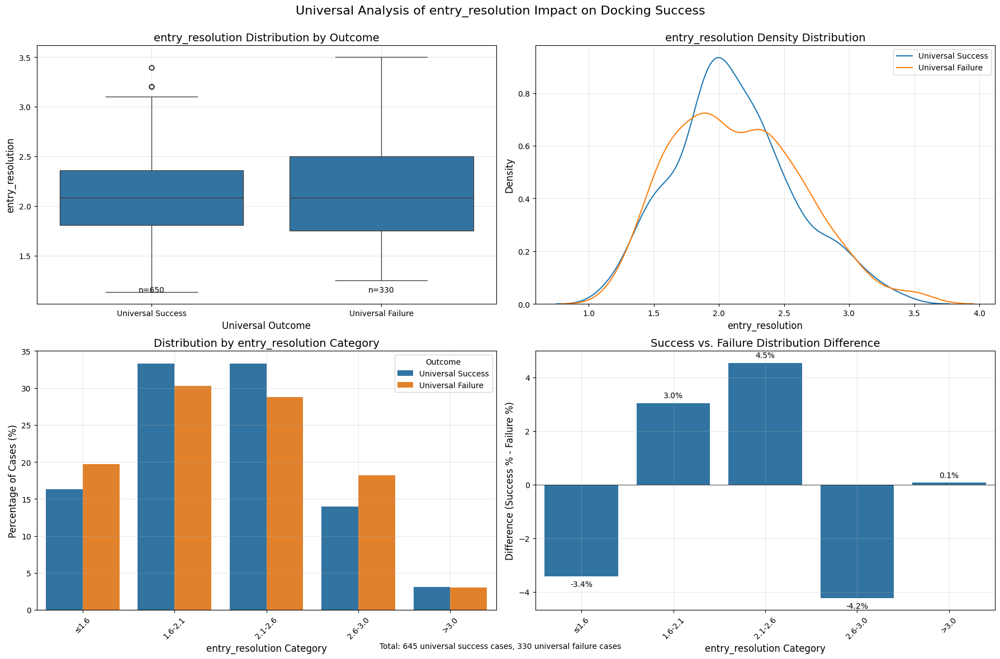

Analyzing entry_validation_molprobity for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'entry_validation_molprobity':
Success cases: n=650, mean=1.389, std=0.467
Failure cases: n=330, mean=1.379, std=0.413
Mann-Whitney U test: p=0.364221
Effect size (Cohen's d): 0.022
Chi-square test for distribution: p=0.005456


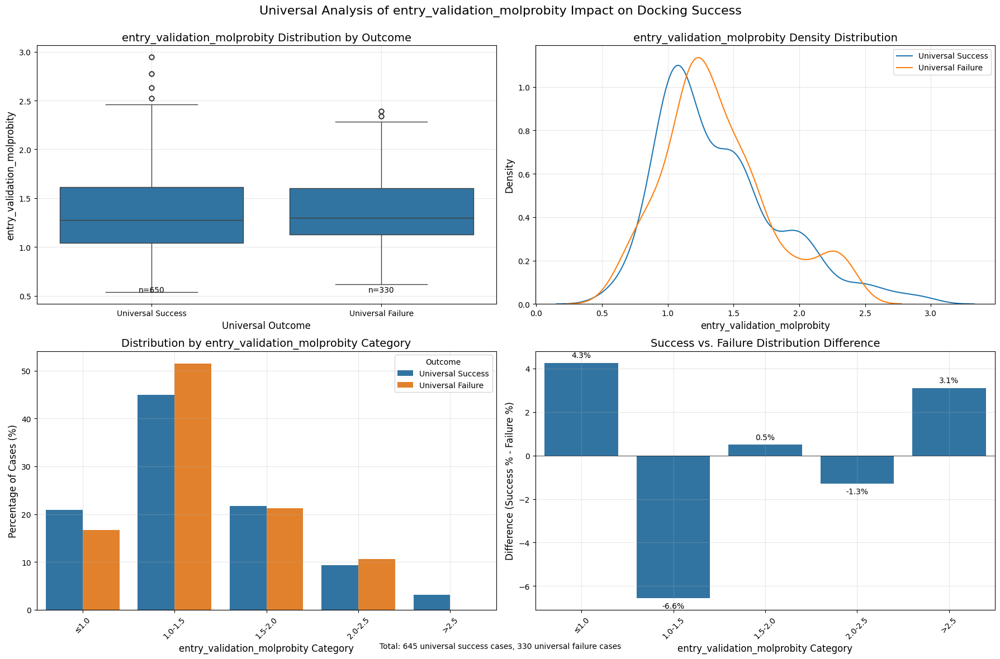

Analyzing system_num_pocket_residues for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'system_num_pocket_residues':
Success cases: n=650, mean=31.838, std=10.016
Failure cases: n=330, mean=18.545, std=15.106
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 1.110
Chi-square test for distribution: p=0.000000


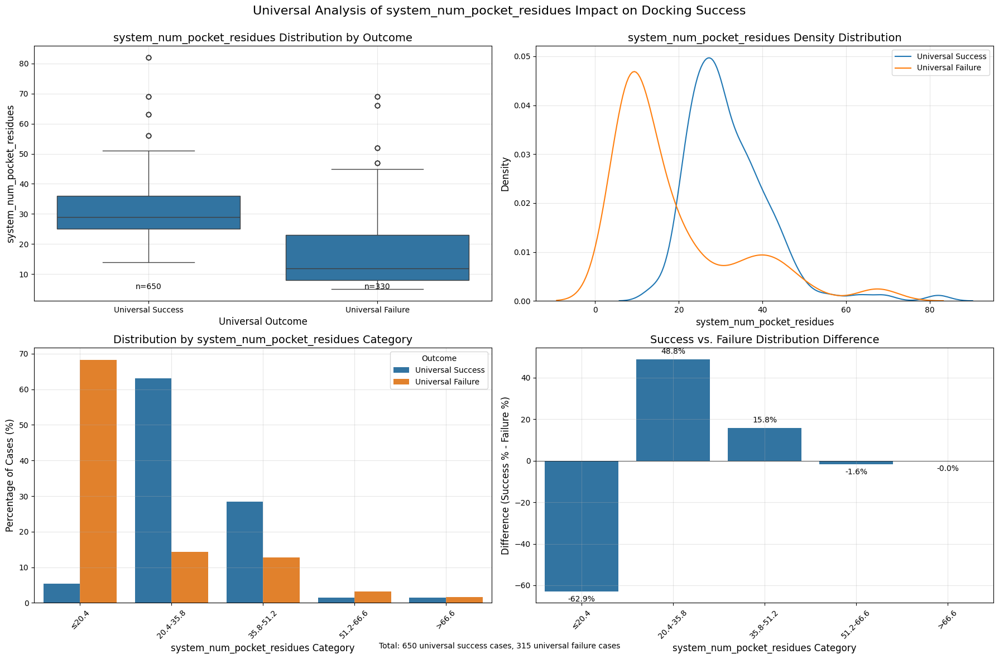

Analyzing system_num_interactions for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'system_num_interactions':
Success cases: n=650, mean=16.446, std=6.029
Failure cases: n=330, mean=8.515, std=7.503
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 1.209
Chi-square test for distribution: p=0.000000


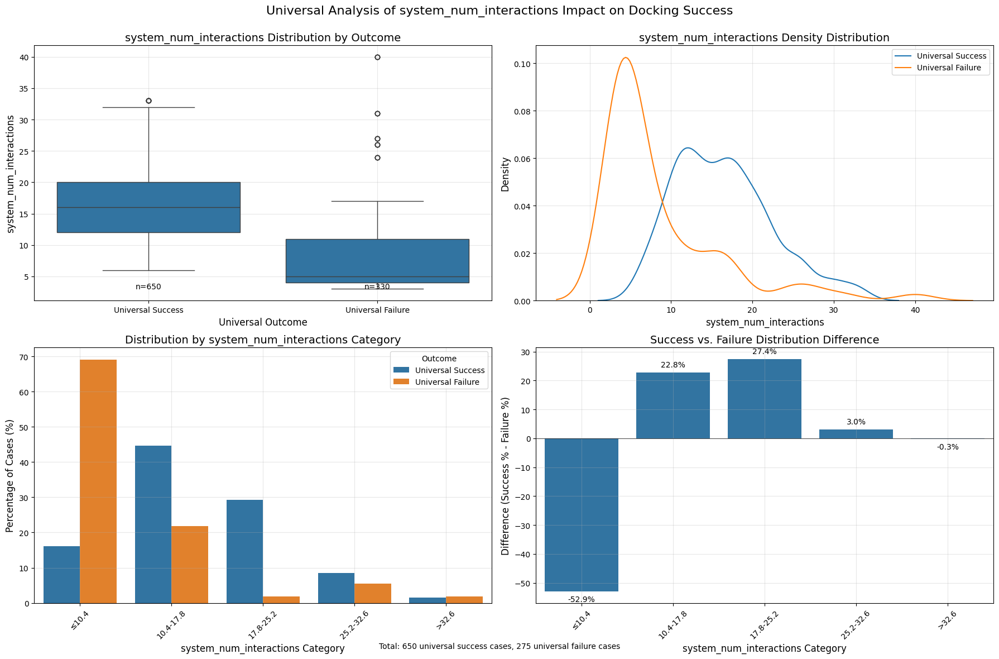

Analyzing ligand_molecular_weight for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'ligand_molecular_weight':
Success cases: n=650, mean=405.927, std=125.813
Failure cases: n=330, mean=399.174, std=133.343
Mann-Whitney U test: p=0.808805
Effect size (Cohen's d): 0.053
Chi-square test for distribution: p=0.000000


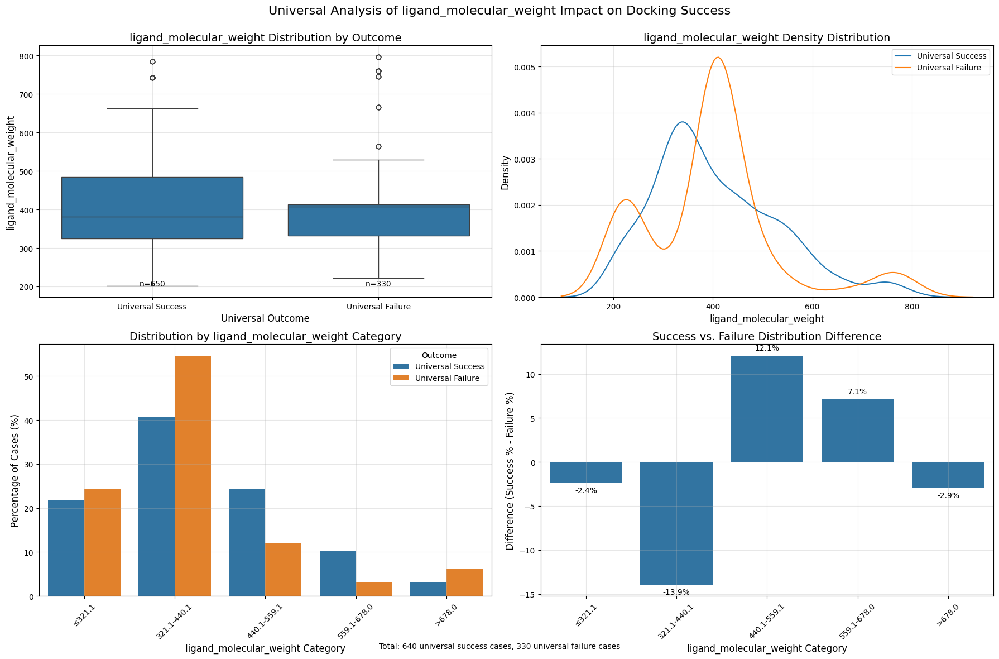

Analyzing ligand_crippen_clogp for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'ligand_crippen_clogp':
Success cases: n=650, mean=-0.265, std=3.354
Failure cases: n=330, mean=-2.609, std=3.069
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 0.719
Chi-square test for distribution: p=0.000000


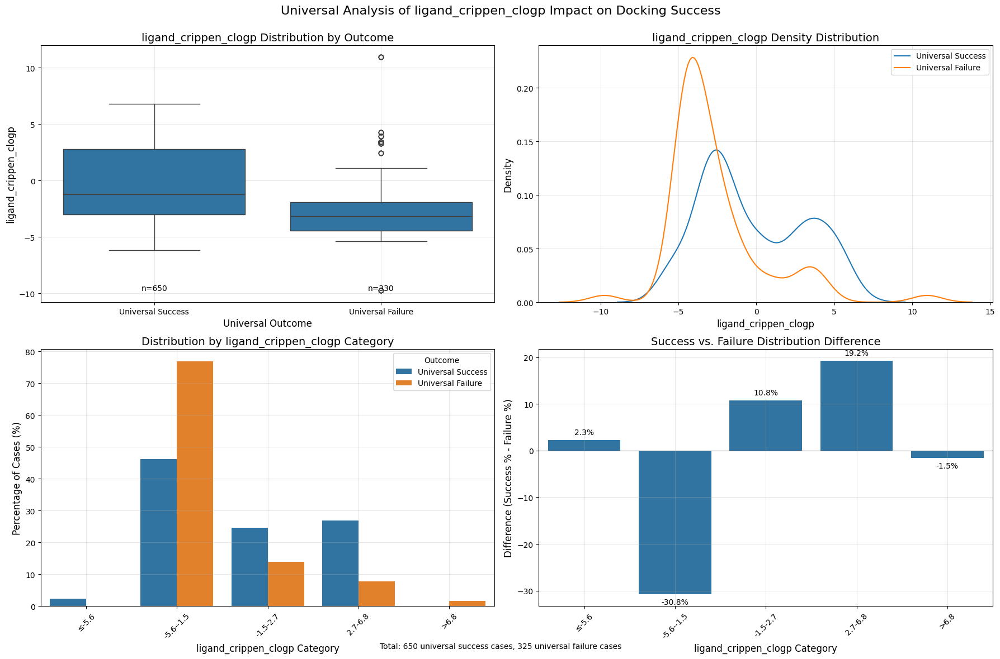

Analyzing ligand_num_interacting_residues for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'ligand_num_interacting_residues':
Success cases: n=650, mean=10.600, std=2.978
Failure cases: n=330, mean=4.636, std=2.905
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 2.019
Chi-square test for distribution: p=0.000000


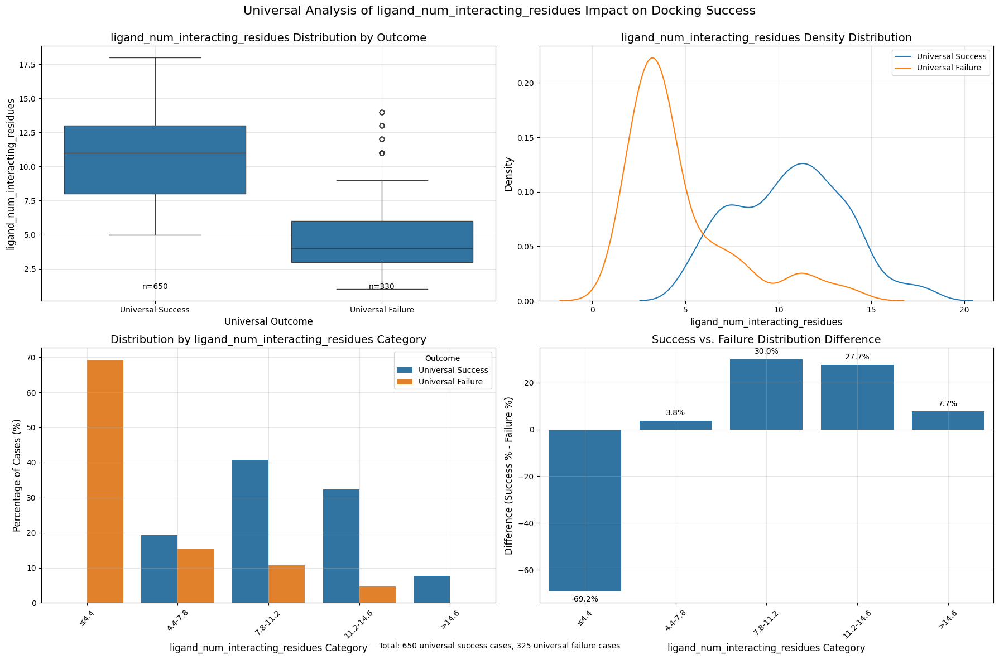

Analyzing ligand_num_neighboring_residues for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'ligand_num_neighboring_residues':
Success cases: n=650, mean=28.669, std=6.543
Failure cases: n=330, mean=13.470, std=7.204
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 2.244
Chi-square test for distribution: p=0.000000


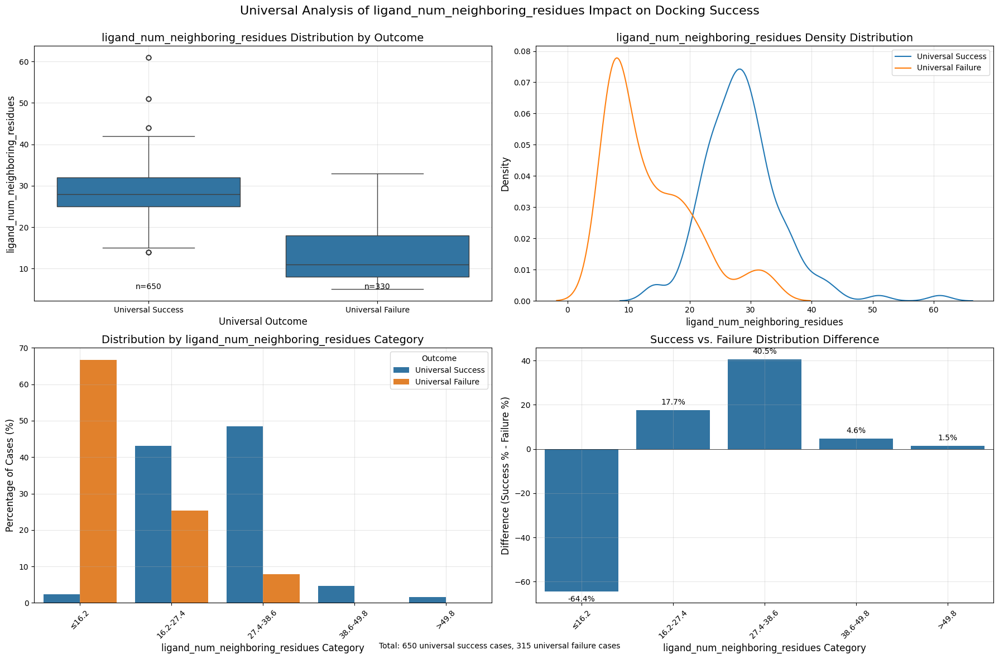

Analyzing ligand_num_interactions for 130 cases where all methods succeed
and 66 cases where all methods fail

Universal analysis of continuous property 'ligand_num_interactions':
Success cases: n=650, mean=15.054, std=5.046
Failure cases: n=330, mean=6.455, std=4.496
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 1.767
Chi-square test for distribution: p=0.000000


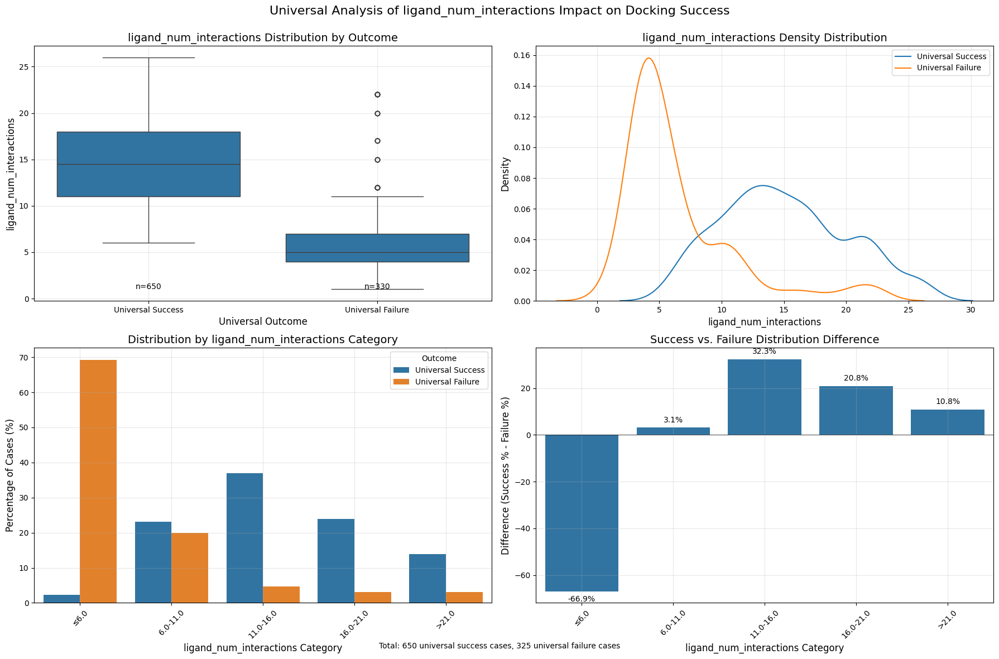

In [11]:
property_analysis = PropertyAnalysis(df_combined)

# 4. Look at universal patterns across all methods
for prop in PLINDER_TEST_COLUMNS[2:]:
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_universal(
        ["icm", "gnina", "surfdock", "diffdock_pocket_only", "chai-1"], prop, prop_type,
    )

# Analysis After Removing covalent, cofactor, ionic systems

In [5]:
# add the `has_ion` flag from inputs_csv (mapping on system_id)
df_combined['has_ion'] = df_combined['protein'].map(
    inputs_csv.set_index('system_id')['has_ion']
)

# build a boolean mask: drop any row where covalent, ionic or has_ion is True
mask = ~(
    df_combined['ligand_is_covalent'] |
    df_combined['ligand_is_ion'] |
    df_combined['has_ion'] |
    df_combined['ligand_is_cofactor']
)

# filter and reset index
df_combined = df_combined.loc[mask].reset_index(drop=True)
print("Filtered shape:", df_combined.shape)

Filtered shape: (13175, 172)


## Individual and Universal Analysis

In [4]:
property_analysis = PropertyAnalysis(df_combined)

In [6]:
PLINDER_TEST_COLUMNS.remove("ligand_is_artifact")
PLINDER_TEST_COLUMNS.remove("ligand_is_cofactor")
PLINDER_TEST_COLUMNS.remove("ligand_is_ion")
PLINDER_TEST_COLUMNS.remove("ligand_is_covalent")
PLINDER_TEST_COLUMNS

['system_id',
 'ligand_smiles',
 'system_num_protein_chains',
 'ligand_num_rot_bonds',
 'ligand_num_hbd',
 'ligand_num_hba',
 'ligand_num_rings',
 'entry_resolution',
 'entry_validation_molprobity',
 'system_num_pocket_residues',
 'system_num_interactions',
 'ligand_molecular_weight',
 'ligand_crippen_clogp',
 'ligand_num_interacting_residues',
 'ligand_num_neighboring_residues',
 'ligand_num_interactions']

### gnina


Impact of system_num_protein_chains on Docking RMSD for gnina
Spearman correlation: -0.1938, p-value: 0.000018


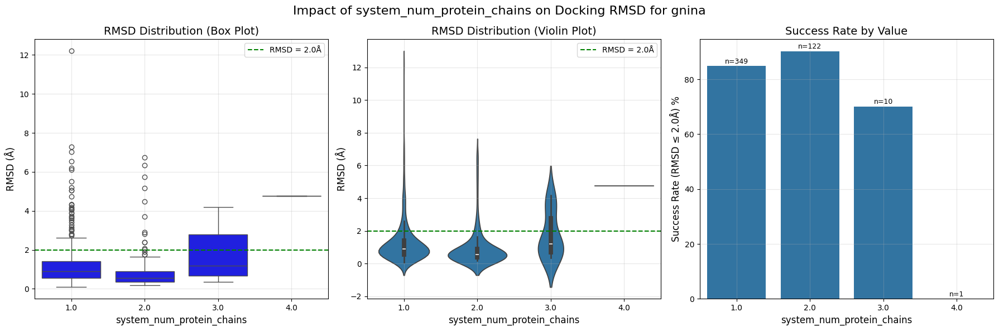


Success rates by discrete value:
  system_num_protein_chains  total_count  success_rate  mean_rmsd
0                       1.0          349     84.813754   1.270674
1                       2.0          122     90.163934   0.936849
2                       3.0           10     70.000000   1.725042
3                       4.0            1      0.000000   4.757058

ANOVA test: F=5.326, p=0.001287
Significant differences in RMSD across system_num_protein_chains values

Impact of ligand_num_rot_bonds on Docking RMSD for gnina
Pearson correlation: 0.4189, p-value: 0.000000
Spearman correlation: 0.4528, p-value: 0.000000


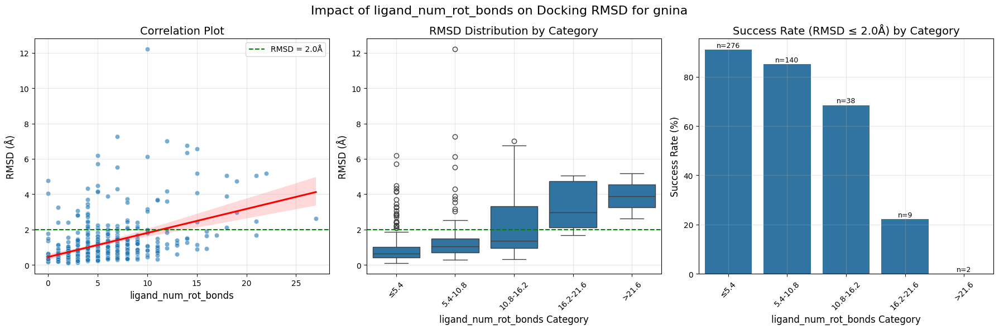


Success rates by category:
  ligand_num_rot_bonds_category  total_count  success_rate  mean_rmsd
0                          ≤5.4          276     90.942029   0.898006
1                      5.4-10.8          140     85.000000   1.369874
2                     10.8-16.2           38     68.421053   2.220595
3                     16.2-21.6            9     22.222222   3.294249
4                         >21.6            2      0.000000   3.898052

ANOVA test: F=22.080, p=0.000000
Significant differences in RMSD across ligand_num_rot_bonds categories

Impact of ligand_num_hbd on Docking RMSD for gnina
Pearson correlation: 0.1139, p-value: 0.012367
Spearman correlation: 0.0702, p-value: 0.123835


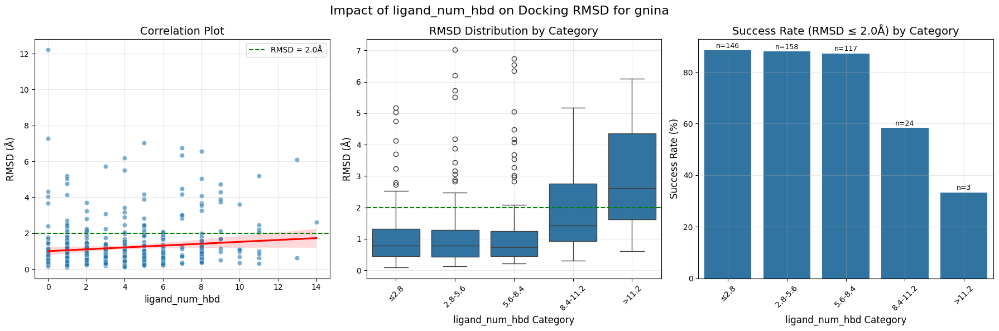


Success rates by category:
  ligand_num_hbd_category  total_count  success_rate  mean_rmsd
0                    ≤2.8          146     88.356164   1.055630
1                 2.8-5.6          158     87.974684   1.100991
2                 5.6-8.4          117     87.179487   1.181695
3                8.4-11.2           24     58.333333   1.966818
4                   >11.2            3     33.333333   3.111699

ANOVA test: F=5.688, p=0.000180
Significant differences in RMSD across ligand_num_hbd categories

Impact of ligand_num_hba on Docking RMSD for gnina
Pearson correlation: 0.0945, p-value: 0.038118
Spearman correlation: 0.0950, p-value: 0.037145


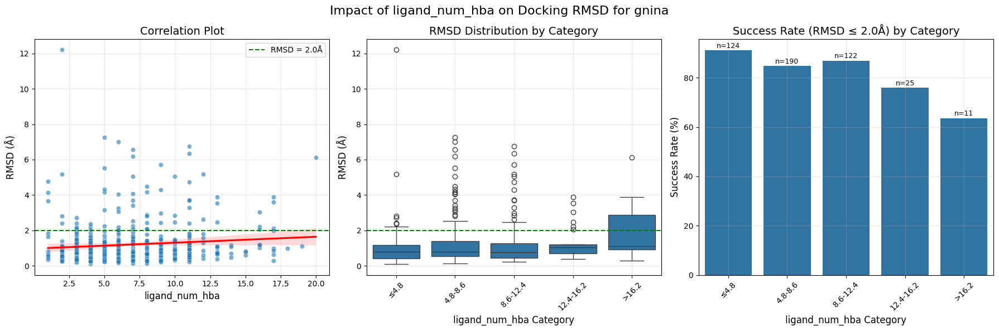


Success rates by category:
  ligand_num_hba_category  total_count  success_rate  mean_rmsd
0                    ≤4.8          124     91.129032   1.016631
1                 4.8-8.6          190     84.736842   1.237542
2                8.6-12.4          122     86.885246   1.179602
3               12.4-16.2           25     76.000000   1.328864
4                   >16.2           11     63.636364   2.052184

ANOVA test: F=2.001, p=0.093337

Impact of ligand_num_rings on Docking RMSD for gnina
Spearman correlation: -0.0891, p-value: 0.050706


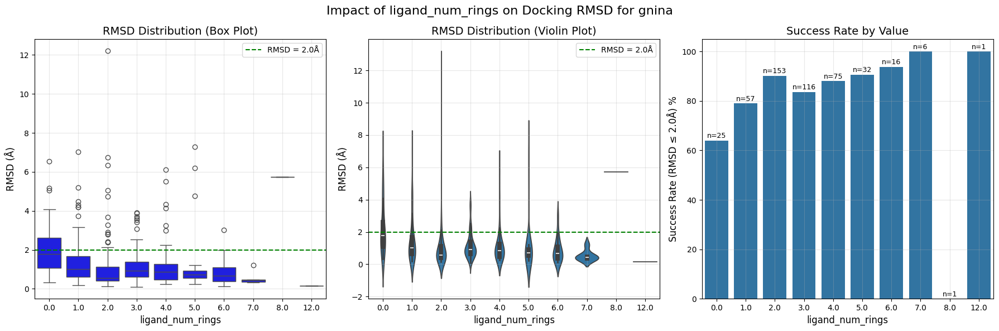


Success rates by discrete value:
  ligand_num_rings  total_count  success_rate  mean_rmsd
0              0.0           25     64.000000   2.221077
1              1.0           57     78.947368   1.504571
2              2.0          153     90.196078   1.014376
3              3.0          116     83.620690   1.169694
4              4.0           75     88.000000   1.148850
5              5.0           32     90.625000   1.189561
6              6.0           16     93.750000   0.889384
7              7.0            6    100.000000   0.540778
8              8.0            1      0.000000   5.726397
9             12.0            1    100.000000   0.165846

ANOVA test: F=4.507, p=0.000011
Significant differences in RMSD across ligand_num_rings values

Impact of entry_resolution on Docking RMSD for gnina
Pearson correlation: 0.1240, p-value: 0.006412
Spearman correlation: 0.1773, p-value: 0.000091


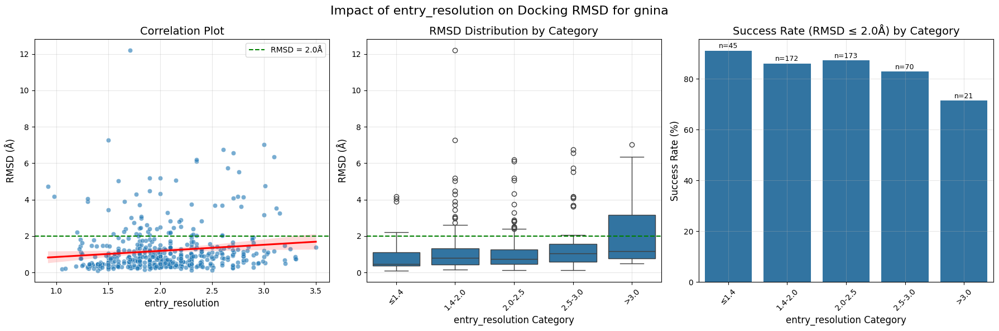


Success rates by category:
  entry_resolution_category  total_count  success_rate  mean_rmsd
0                      ≤1.4           45     91.111111   0.895581
1                   1.4-2.0          172     86.046512   1.177162
2                   2.0-2.5          173     87.283237   1.068509
3                   2.5-3.0           70     82.857143   1.502226
4                      >3.0           21     71.428571   2.012146

ANOVA test: F=4.353, p=0.001819
Significant differences in RMSD across entry_resolution categories

Impact of entry_validation_molprobity on Docking RMSD for gnina
Pearson correlation: 0.0828, p-value: 0.069393
Spearman correlation: 0.1349, p-value: 0.002993


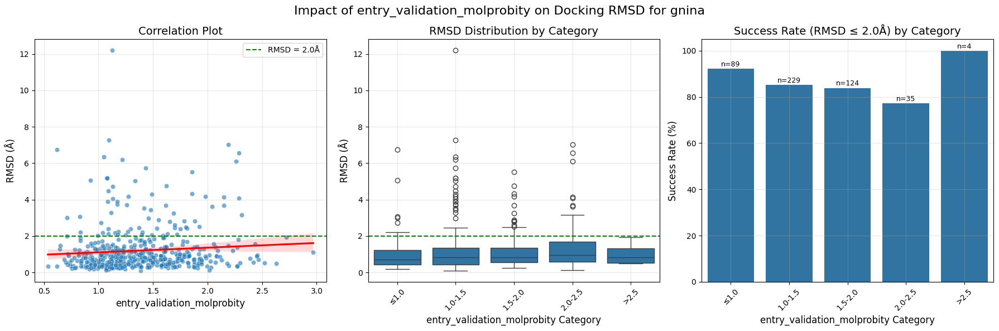


Success rates by category:
  entry_validation_molprobity_category  total_count  success_rate  mean_rmsd
0                                 ≤1.0           89     92.134831   0.981558
1                              1.0-1.5          229     85.152838   1.236403
2                              1.5-2.0          124     83.870968   1.153660
3                              2.0-2.5           35     77.142857   1.765743
4                                 >2.5            4    100.000000   1.019710

ANOVA test: F=2.480, p=0.043268
Significant differences in RMSD across entry_validation_molprobity categories

Impact of system_num_pocket_residues on Docking RMSD for gnina
Pearson correlation: -0.3123, p-value: 0.000000
Spearman correlation: -0.3106, p-value: 0.000000


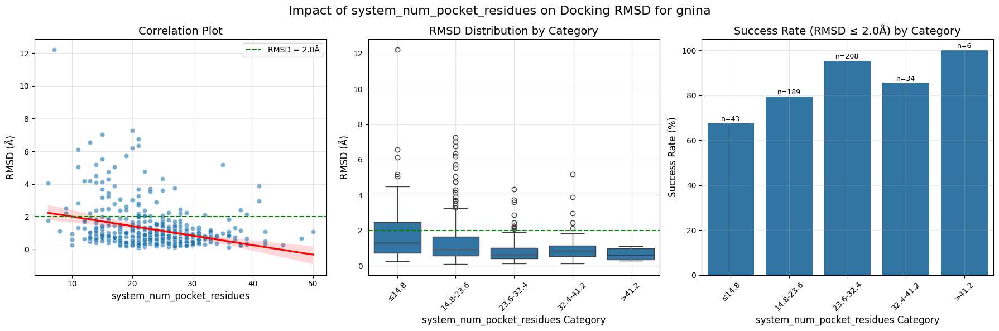


Success rates by category:
  system_num_pocket_residues_category  total_count  success_rate  mean_rmsd
0                               ≤14.8           43     67.441860   2.174357
1                           14.8-23.6          189     79.365079   1.420880
2                           23.6-32.4          208     95.192308   0.812676
3                           32.4-41.2           34     85.294118   1.144397
4                               >41.2            6    100.000000   0.658327

ANOVA test: F=14.101, p=0.000000
Significant differences in RMSD across system_num_pocket_residues categories

Impact of system_num_interactions on Docking RMSD for gnina
Pearson correlation: -0.2756, p-value: 0.000000
Spearman correlation: -0.3185, p-value: 0.000000


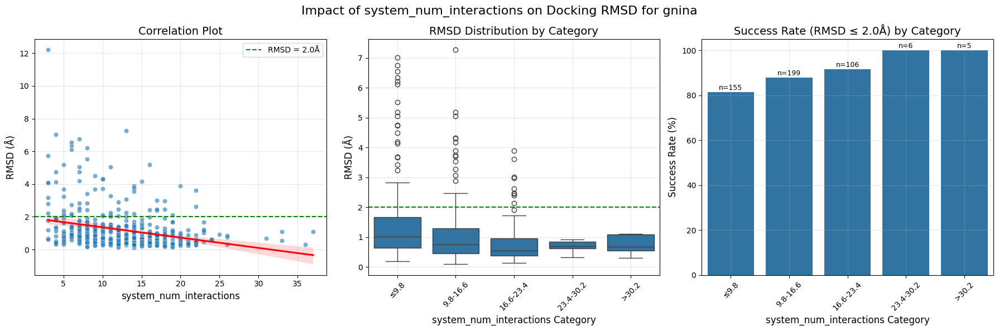


Success rates by category:
  system_num_interactions_category  total_count  success_rate  mean_rmsd
0                             ≤9.8          155     81.290323   1.517899
1                         9.8-16.6          199     87.939698   1.058790
2                        16.6-23.4          106     91.509434   0.825145
3                        23.4-30.2            6    100.000000   0.684926
4                            >30.2            5    100.000000   0.740113

ANOVA test: F=7.127, p=0.000014
Significant differences in RMSD across system_num_interactions categories

Impact of ligand_molecular_weight on Docking RMSD for gnina
Pearson correlation: 0.2514, p-value: 0.000000
Spearman correlation: 0.2409, p-value: 0.000000


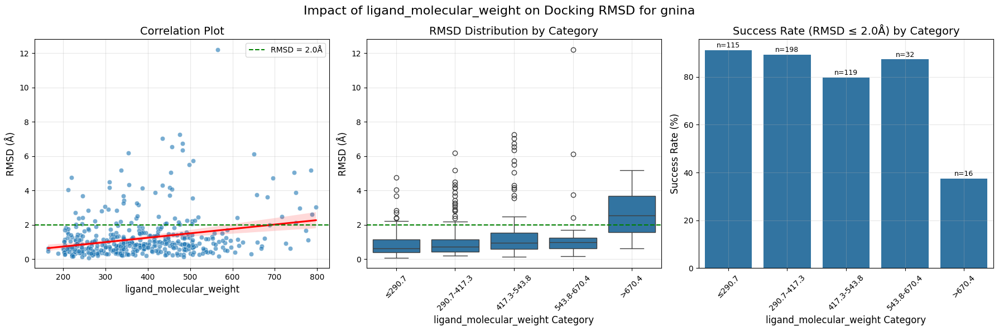


Success rates by category:
  ligand_molecular_weight_category  total_count  success_rate  mean_rmsd
0                           ≤290.7          115     91.304348   0.925059
1                      290.7-417.3          198     89.393939   1.028211
2                      417.3-543.8          119     79.831933   1.485428
3                      543.8-670.4           32     87.500000   1.523312
4                           >670.4           16     37.500000   2.698780

ANOVA test: F=10.372, p=0.000000
Significant differences in RMSD across ligand_molecular_weight categories

Impact of ligand_crippen_clogp on Docking RMSD for gnina
Pearson correlation: 0.0128, p-value: 0.779506
Spearman correlation: 0.0048, p-value: 0.915875


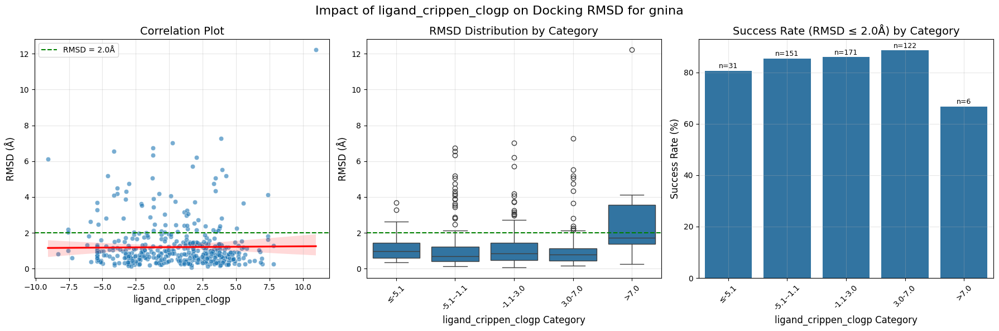


Success rates by category:
  ligand_crippen_clogp_category  total_count  success_rate  mean_rmsd
0                         ≤-5.1           31     80.645161   1.218658
1                     -5.1--1.1          151     85.430464   1.193910
2                      -1.1-3.0          171     85.964912   1.184699
3                       3.0-7.0          122     88.524590   1.079126
4                          >7.0            6     66.666667   3.560431

ANOVA test: F=5.729, p=0.000165
Significant differences in RMSD across ligand_crippen_clogp categories

Impact of ligand_num_interacting_residues on Docking RMSD for gnina
Pearson correlation: -0.2846, p-value: 0.000000
Spearman correlation: -0.3236, p-value: 0.000000


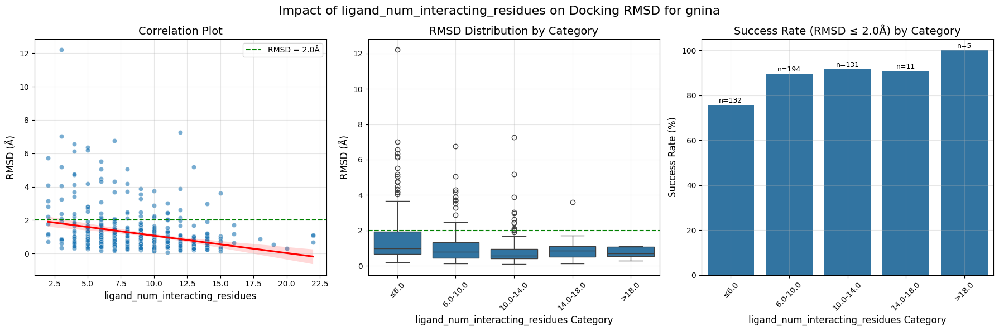


Success rates by category:
  ligand_num_interacting_residues_category  total_count  success_rate  \
0                                     ≤6.0          132     75.757576   
1                                 6.0-10.0          194     89.690722   
2                                10.0-14.0          131     91.603053   
3                                14.0-18.0           11     90.909091   
4                                    >18.0            5    100.000000   

   mean_rmsd  
0   1.696976  
1   1.054570  
2   0.864489  
3   1.043012  
4   0.740113  

ANOVA test: F=8.759, p=0.000001
Significant differences in RMSD across ligand_num_interacting_residues categories

Impact of ligand_num_neighboring_residues on Docking RMSD for gnina
Pearson correlation: -0.3117, p-value: 0.000000
Spearman correlation: -0.3108, p-value: 0.000000


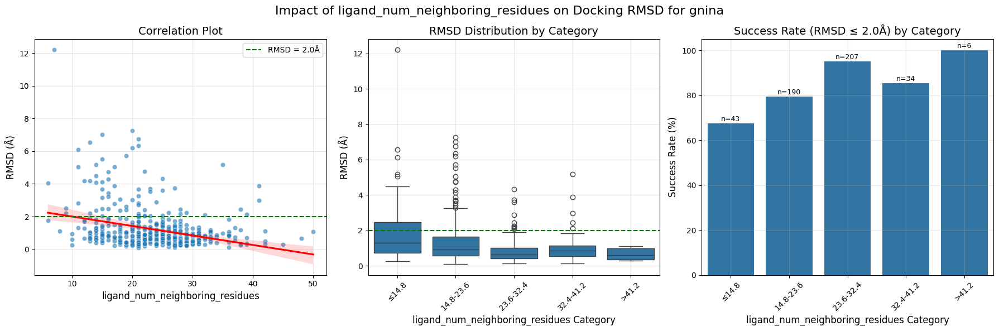


Success rates by category:
  ligand_num_neighboring_residues_category  total_count  success_rate  \
0                                    ≤14.8           43     67.441860   
1                                14.8-23.6          190     79.473684   
2                                23.6-32.4          207     95.169082   
3                                32.4-41.2           34     85.294118   
4                                    >41.2            6    100.000000   

   mean_rmsd  
0   2.174357  
1   1.417452  
2   0.812884  
3   1.144397  
4   0.658327  

ANOVA test: F=14.022, p=0.000000
Significant differences in RMSD across ligand_num_neighboring_residues categories

Impact of ligand_num_interactions on Docking RMSD for gnina
Pearson correlation: -0.2756, p-value: 0.000000
Spearman correlation: -0.3185, p-value: 0.000000


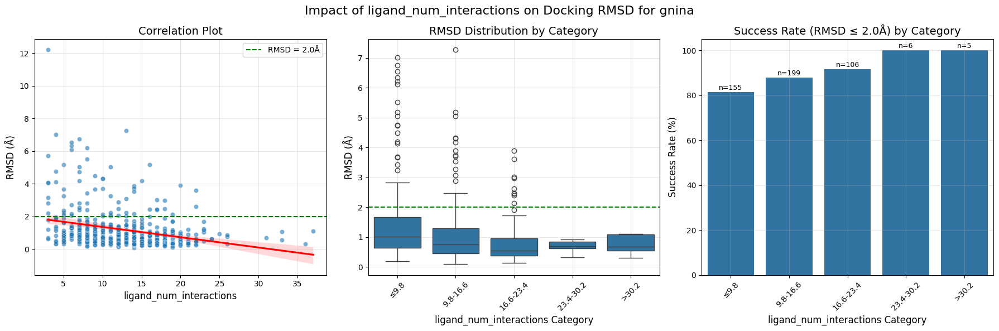


Success rates by category:
  ligand_num_interactions_category  total_count  success_rate  mean_rmsd
0                             ≤9.8          155     81.290323   1.517899
1                         9.8-16.6          199     87.939698   1.058790
2                        16.6-23.4          106     91.509434   0.825145
3                        23.4-30.2            6    100.000000   0.684926
4                            >30.2            5    100.000000   0.740113

ANOVA test: F=7.127, p=0.000014
Significant differences in RMSD across ligand_num_interactions categories


In [27]:
for prop in PLINDER_TEST_COLUMNS[2:]: 
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_single_method(
        "gnina", prop, prop_type,
    )

### icm


Impact of system_num_protein_chains on Docking RMSD for icm
Spearman correlation: nan, p-value: nan


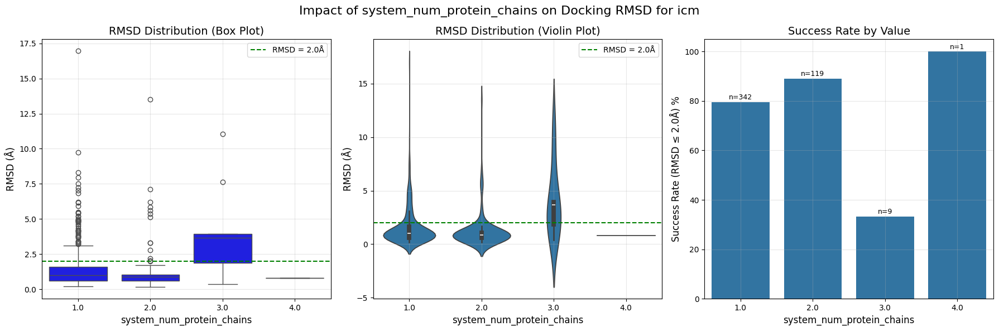


Success rates by discrete value:
  system_num_protein_chains  total_count  success_rate  mean_rmsd
0                       1.0          342     79.532164   1.577437
1                       2.0          119     89.075630   1.253527
2                       3.0            9     33.333333   3.952768
3                       4.0            1    100.000000   0.812903

ANOVA test: F=nan, p=nan


ValueError: array must not contain infs or NaNs

In [ ]:
for prop in PLINDER_TEST_COLUMNS[2:]: 
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_single_method(
        "icm", prop, prop_type,
    )

### surfdock


Impact of system_num_protein_chains on Docking RMSD for surfdock
Spearman correlation: -0.1036, p-value: 0.063750


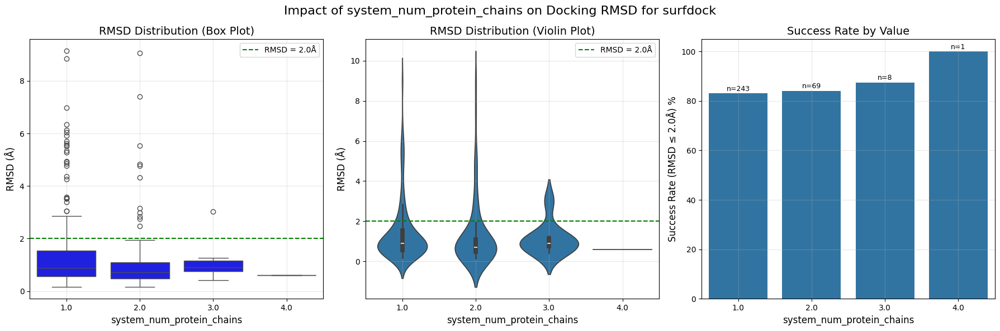


Success rates by discrete value:
  system_num_protein_chains  total_count  success_rate  mean_rmsd
0                       1.0          243     83.127572   1.422756
1                       2.0           69     84.057971   1.316949
2                       3.0            8     87.500000   1.135565
3                       4.0            1    100.000000   0.603722

ANOVA test: F=0.251, p=0.860498

Impact of ligand_num_rot_bonds on Docking RMSD for surfdock
Pearson correlation: 0.1781, p-value: 0.001353
Spearman correlation: 0.3889, p-value: 0.000000


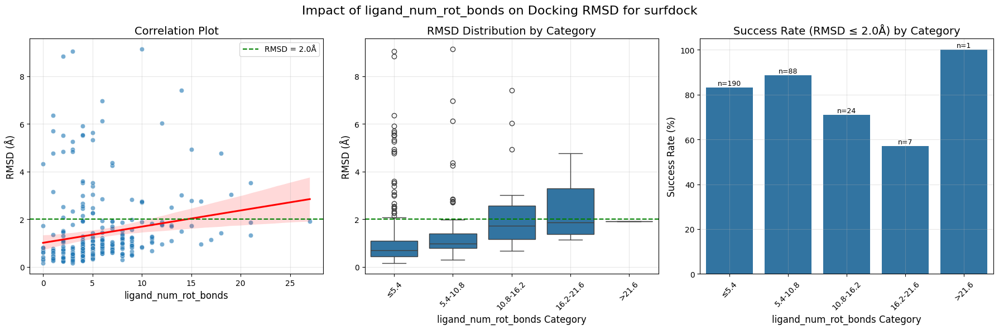


Success rates by category:
  ligand_num_rot_bonds_category  total_count  success_rate  mean_rmsd
0                          ≤5.4          190     83.157895   1.262337
1                      5.4-10.8           88     88.636364   1.407131
2                     10.8-16.2           24     70.833333   2.203212
3                     16.2-21.6            7     57.142857   2.443595
4                         >21.6            1    100.000000   1.903425

ANOVA test: F=2.931, p=0.021119
Significant differences in RMSD across ligand_num_rot_bonds categories

Impact of ligand_num_hbd on Docking RMSD for surfdock
Pearson correlation: 0.0866, p-value: 0.121564
Spearman correlation: 0.1834, p-value: 0.000964


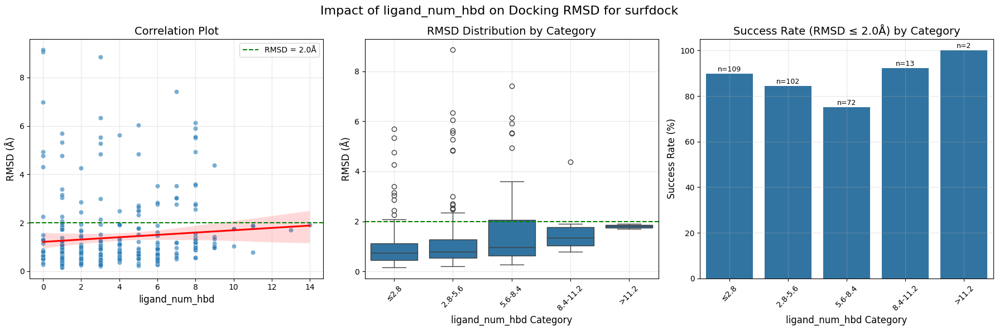


Success rates by category:
  ligand_num_hbd_category  total_count  success_rate  mean_rmsd
0                    ≤2.8          109     89.908257   1.053252
1                 2.8-5.6          102     84.313725   1.328861
2                 5.6-8.4           72     75.000000   1.632239
3                8.4-11.2           13     92.307692   1.563937
4                   >11.2            2    100.000000   1.799214

ANOVA test: F=2.188, p=0.070361

Impact of ligand_num_hba on Docking RMSD for surfdock
Pearson correlation: 0.0955, p-value: 0.087694
Spearman correlation: 0.2978, p-value: 0.000000


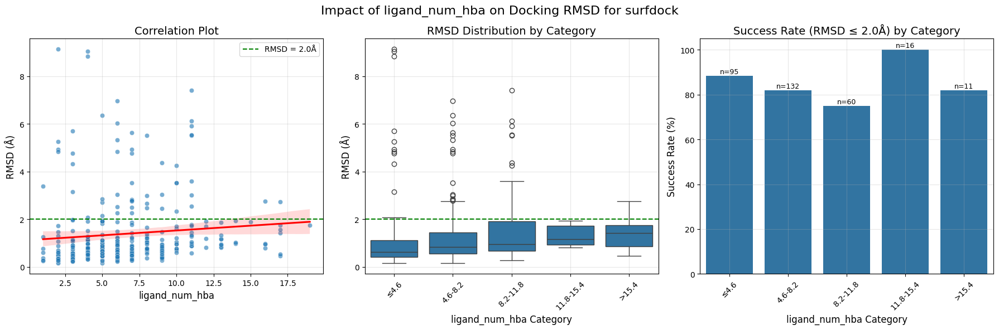


Success rates by category:
  ligand_num_hba_category  total_count  success_rate  mean_rmsd
0                    ≤4.6           95     88.421053   1.278244
1                 4.6-8.2          132     81.818182   1.357922
2                8.2-11.8           60     75.000000   1.706869
3               11.8-15.4           16    100.000000   1.282960
4                   >15.4           11     81.818182   1.430533

ANOVA test: F=0.798, p=0.527340

Impact of ligand_num_rings on Docking RMSD for surfdock
Spearman correlation: 0.0645, p-value: 0.248963


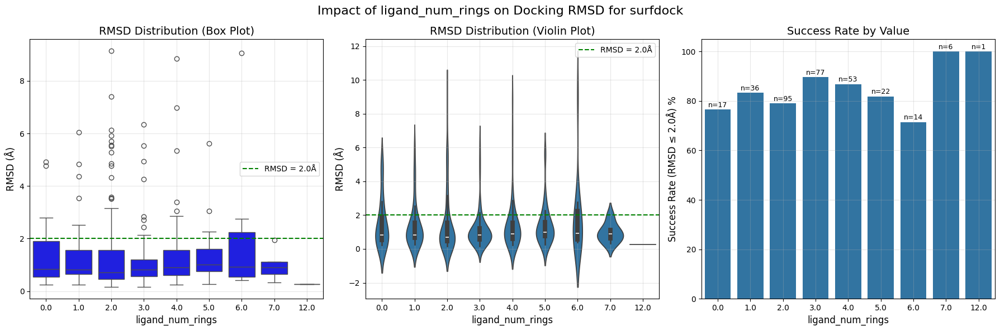


Success rates by discrete value:
  ligand_num_rings  total_count  success_rate  mean_rmsd
0              0.0           17     76.470588   1.515245
1              1.0           36     83.333333   1.390044
2              2.0           95     78.947368   1.504923
3              3.0           77     89.610390   1.159201
4              4.0           53     86.792453   1.447843
5              5.0           22     81.818182   1.384724
6              6.0           14     71.428571   1.784461
7              7.0            6    100.000000   0.968204
8             12.0            1    100.000000   0.269246

ANOVA test: F=0.547, p=0.820319

Impact of entry_resolution on Docking RMSD for surfdock
Pearson correlation: 0.0031, p-value: 0.956428
Spearman correlation: 0.0854, p-value: 0.126835


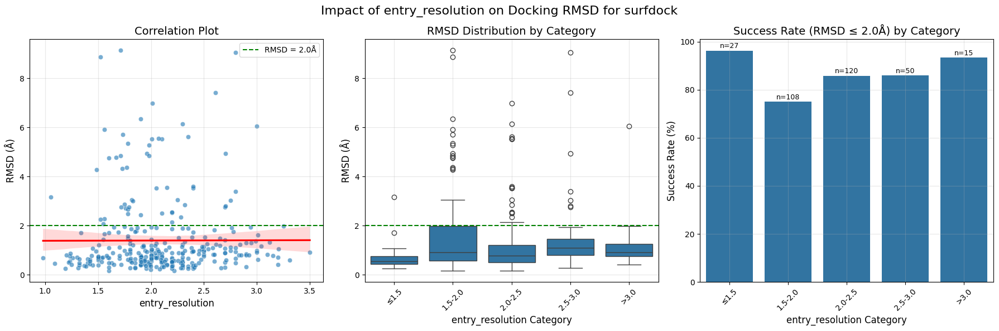


Success rates by category:
  entry_resolution_category  total_count  success_rate  mean_rmsd
0                      ≤1.5           27     96.296296   0.710342
1                   1.5-2.0          108     75.000000   1.700664
2                   2.0-2.5          120     85.833333   1.214077
3                   2.5-3.0           50     86.000000   1.543642
4                      >3.0           15     93.333333   1.325131

ANOVA test: F=3.063, p=0.016926
Significant differences in RMSD across entry_resolution categories

Impact of entry_validation_molprobity on Docking RMSD for surfdock
Pearson correlation: 0.0030, p-value: 0.957298
Spearman correlation: -0.0080, p-value: 0.886872


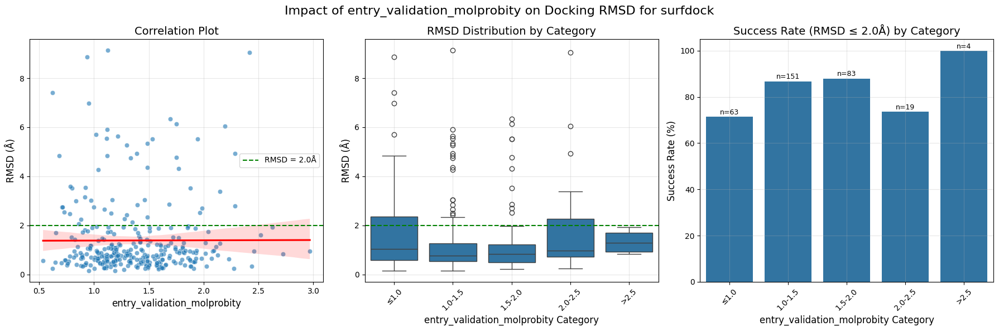


Success rates by category:
  entry_validation_molprobity_category  total_count  success_rate  mean_rmsd
0                                 ≤1.0           63     71.428571   1.738263
1                              1.0-1.5          151     86.754967   1.250291
2                              1.5-2.0           83     87.951807   1.248614
3                              2.0-2.5           19     73.684211   2.022007
4                                 >2.5            4    100.000000   1.338730

ANOVA test: F=2.159, p=0.073494

Impact of system_num_pocket_residues on Docking RMSD for surfdock
Pearson correlation: -0.2002, p-value: 0.000308
Spearman correlation: -0.0952, p-value: 0.088645


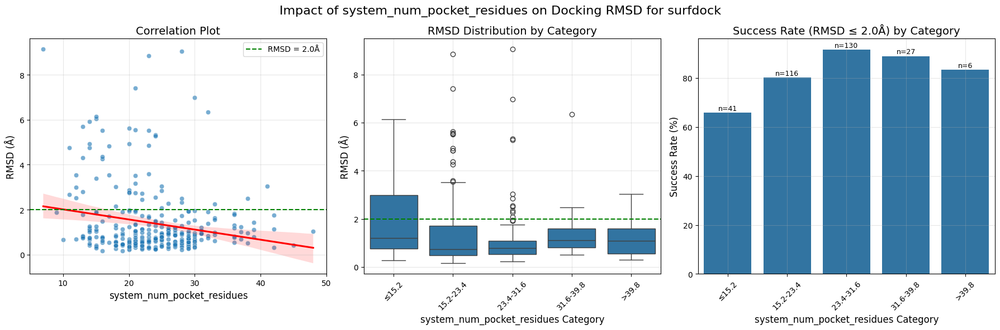


Success rates by category:
  system_num_pocket_residues_category  total_count  success_rate  mean_rmsd
0                               ≤15.2           41     65.853659   2.105206
1                           15.2-23.4          116     80.172414   1.445357
2                           23.4-31.6          130     91.538462   1.061475
3                           31.6-39.8           27     88.888889   1.388931
4                               >39.8            6     83.333333   1.279667

ANOVA test: F=4.278, p=0.002195
Significant differences in RMSD across system_num_pocket_residues categories

Impact of system_num_interactions on Docking RMSD for surfdock
Pearson correlation: -0.1801, p-value: 0.001191
Spearman correlation: -0.0941, p-value: 0.092320


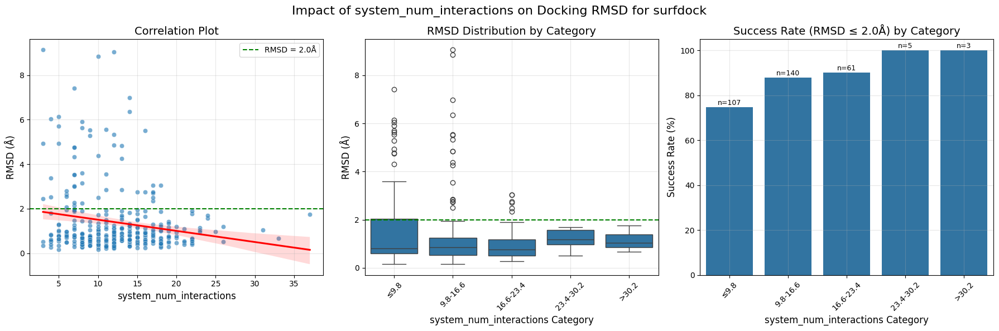


Success rates by category:
  system_num_interactions_category  total_count  success_rate  mean_rmsd
0                             ≤9.8          107     74.766355   1.623503
1                         9.8-16.6          140     87.857143   1.324204
2                        16.6-23.4           61     90.163934   0.990890
3                        23.4-30.2            5    100.000000   1.183826
4                            >30.2            3    100.000000   1.152359

ANOVA test: F=1.931, p=0.105072

Impact of ligand_molecular_weight on Docking RMSD for surfdock
Pearson correlation: 0.1543, p-value: 0.005614
Spearman correlation: 0.3954, p-value: 0.000000


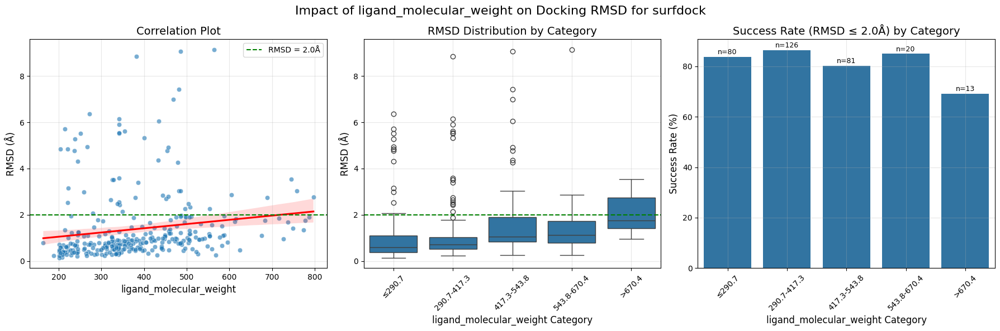


Success rates by category:
  ligand_molecular_weight_category  total_count  success_rate  mean_rmsd
0                           ≤290.7           80     83.750000   1.216883
1                      290.7-417.3          126     86.507937   1.204188
2                      417.3-543.8           81     80.246914   1.699094
3                      543.8-670.4           20     85.000000   1.645606
4                           >670.4           13     69.230769   1.991296

ANOVA test: F=2.230, p=0.065615

Impact of ligand_crippen_clogp on Docking RMSD for surfdock
Pearson correlation: -0.0147, p-value: 0.793700
Spearman correlation: -0.0700, p-value: 0.211133


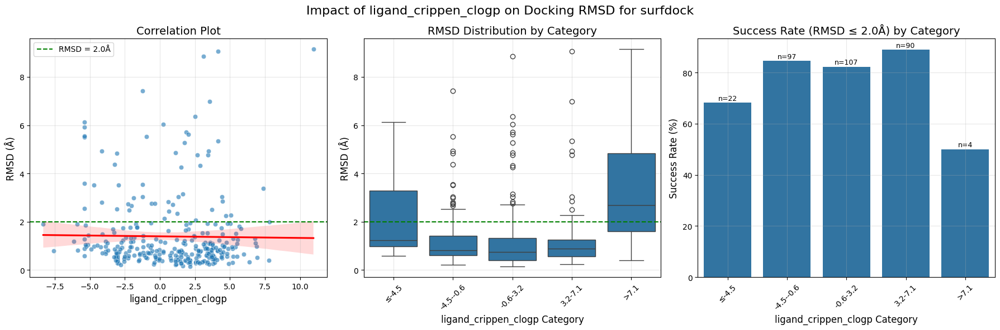


Success rates by category:
  ligand_crippen_clogp_category  total_count  success_rate  mean_rmsd
0                         ≤-4.5           22     68.181818   2.246999
1                     -4.5--0.6           97     84.536082   1.298251
2                      -0.6-3.2          107     82.242991   1.318608
3                       3.2-7.1           90     88.888889   1.255664
4                          >7.1            4     50.000000   3.731252

ANOVA test: F=4.600, p=0.001268
Significant differences in RMSD across ligand_crippen_clogp categories

Impact of ligand_num_interacting_residues on Docking RMSD for surfdock
Pearson correlation: -0.2090, p-value: 0.000162
Spearman correlation: -0.1265, p-value: 0.023444


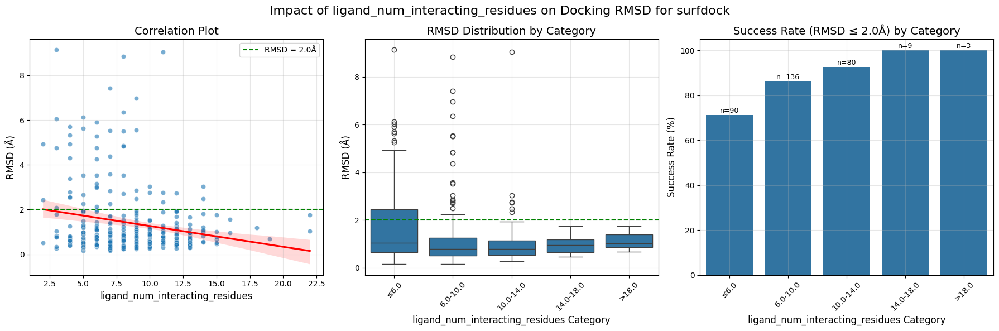


Success rates by category:
  ligand_num_interacting_residues_category  total_count  success_rate  \
0                                     ≤6.0           90     71.111111   
1                                 6.0-10.0          136     86.029412   
2                                10.0-14.0           80     92.500000   
3                                14.0-18.0            9    100.000000   
4                                    >18.0            3    100.000000   

   mean_rmsd  
0   1.831254  
1   1.300293  
2   1.055104  
3   0.987390  
4   1.152359  

ANOVA test: F=3.258, p=0.012252
Significant differences in RMSD across ligand_num_interacting_residues categories

Impact of ligand_num_neighboring_residues on Docking RMSD for surfdock
Pearson correlation: -0.2011, p-value: 0.000287
Spearman correlation: -0.0965, p-value: 0.084223


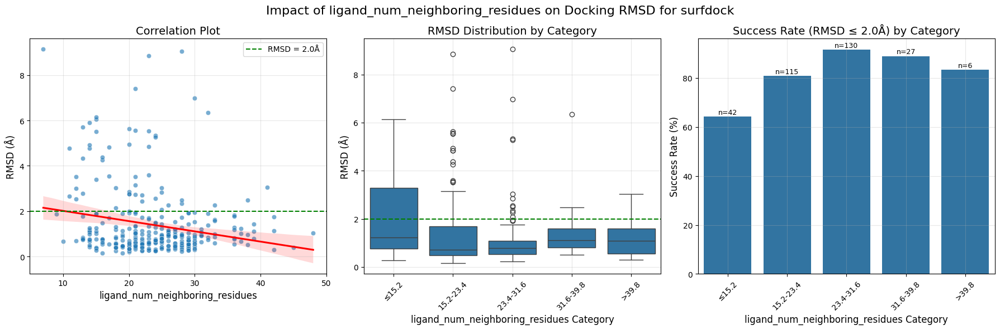


Success rates by category:
  ligand_num_neighboring_residues_category  total_count  success_rate  \
0                                    ≤15.2           42     64.285714   
1                                15.2-23.4          115     80.869565   
2                                23.4-31.6          130     91.538462   
3                                31.6-39.8           27     88.888889   
4                                    >39.8            6     83.333333   

   mean_rmsd  
0   2.186342  
1   1.409987  
2   1.061475  
3   1.388931  
4   1.279667  

ANOVA test: F=4.969, p=0.000676
Significant differences in RMSD across ligand_num_neighboring_residues categories

Impact of ligand_num_interactions on Docking RMSD for surfdock
Pearson correlation: -0.1801, p-value: 0.001191
Spearman correlation: -0.0941, p-value: 0.092320


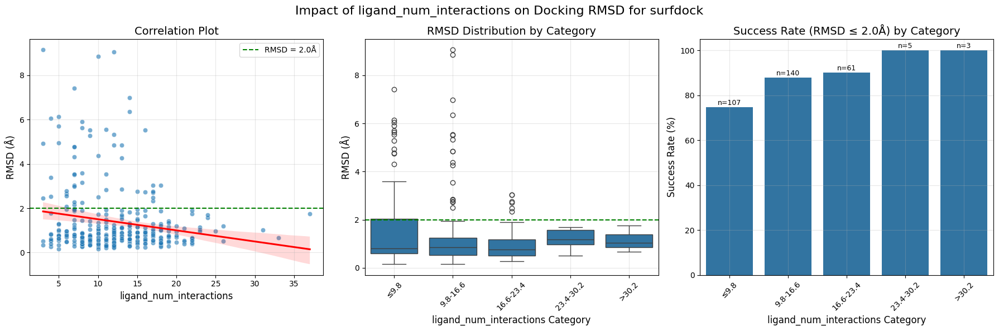


Success rates by category:
  ligand_num_interactions_category  total_count  success_rate  mean_rmsd
0                             ≤9.8          107     74.766355   1.623503
1                         9.8-16.6          140     87.857143   1.324204
2                        16.6-23.4           61     90.163934   0.990890
3                        23.4-30.2            5    100.000000   1.183826
4                            >30.2            3    100.000000   1.152359

ANOVA test: F=1.931, p=0.105072


In [29]:
for prop in PLINDER_TEST_COLUMNS[2:]: 
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_single_method(
        "surfdock", prop, prop_type,
    )

### diffdock_pocket_only


Impact of system_num_protein_chains on Docking RMSD for diffdock_pocket_only
Spearman correlation: -0.0604, p-value: 0.200453


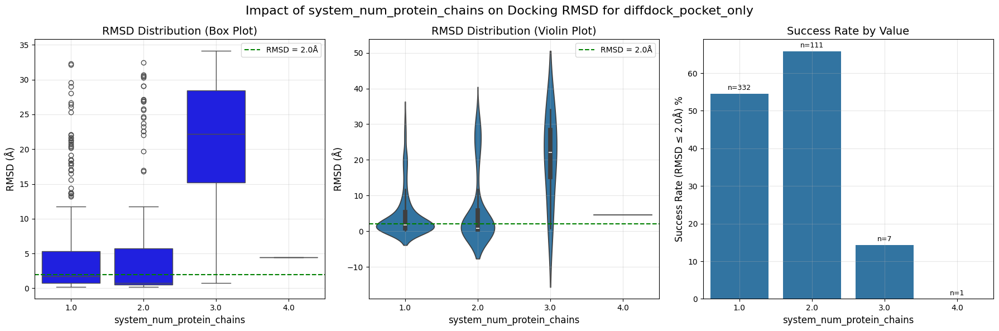


Success rates by discrete value:
  system_num_protein_chains  total_count  success_rate  mean_rmsd
0                       1.0          332     54.518072   4.557960
1                       2.0          111     65.765766   6.398459
2                       3.0            7     14.285714  20.602695
3                       4.0            1      0.000000   4.490900

ANOVA test: F=11.071, p=0.000001
Significant differences in RMSD across system_num_protein_chains values

Impact of ligand_num_rot_bonds on Docking RMSD for diffdock_pocket_only
Pearson correlation: 0.0523, p-value: 0.267698
Spearman correlation: 0.0934, p-value: 0.047331


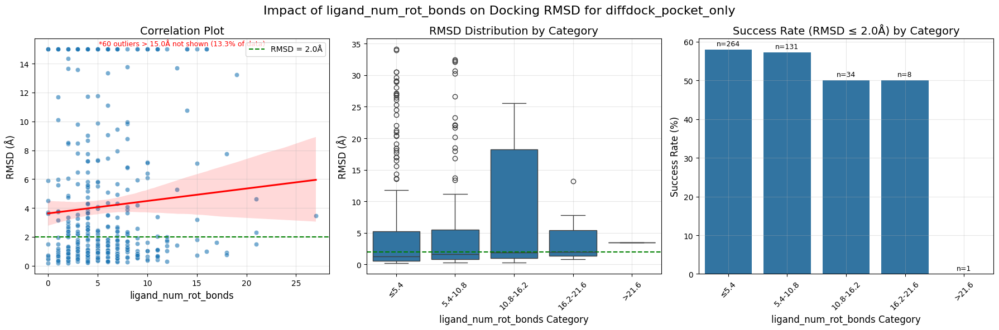


Success rates by category:
  ligand_num_rot_bonds_category  total_count  success_rate  mean_rmsd
0                          ≤5.4          264     57.954545   4.972149
1                      5.4-10.8          131     57.251908   5.128146
2                     10.8-16.2           34     50.000000   7.781139
3                     16.2-21.6            8     50.000000   4.087032
4                         >21.6            1      0.000000   3.446215

ANOVA test: F=1.016, p=0.398654

Impact of ligand_num_hbd on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.0343, p-value: 0.467664
Spearman correlation: -0.0695, p-value: 0.140644


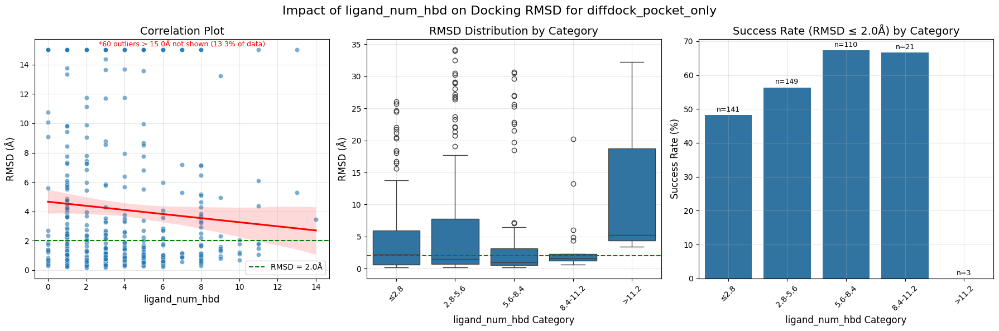


Success rates by category:
  ligand_num_hbd_category  total_count  success_rate  mean_rmsd
0                    ≤2.8          141     48.226950   4.827067
1                 2.8-5.6          149     56.375839   6.280011
2                 5.6-8.4          110     67.272727   4.159917
3                8.4-11.2           21     66.666667   3.403401
4                   >11.2            3      0.000000  13.666665

ANOVA test: F=2.440, p=0.046325
Significant differences in RMSD across ligand_num_hbd categories

Impact of ligand_num_hba on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.0815, p-value: 0.083942
Spearman correlation: -0.0681, p-value: 0.148783


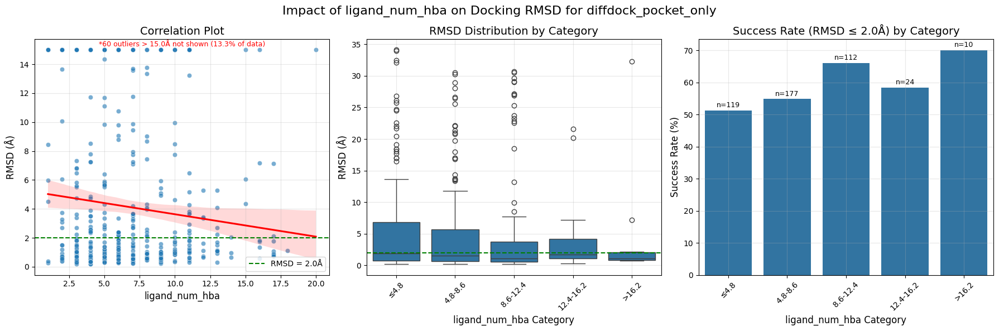


Success rates by category:
  ligand_num_hba_category  total_count  success_rate  mean_rmsd
0                    ≤4.8          119     51.260504   6.120437
1                 4.8-8.6          177     54.802260   4.863271
2                8.6-12.4          112     66.071429   4.869560
3               12.4-16.2           24     58.333333   3.819147
4                   >16.2           10     70.000000   4.875050

ANOVA test: F=0.717, p=0.580398

Impact of ligand_num_rings on Docking RMSD for diffdock_pocket_only
Spearman correlation: 0.0477, p-value: 0.311804


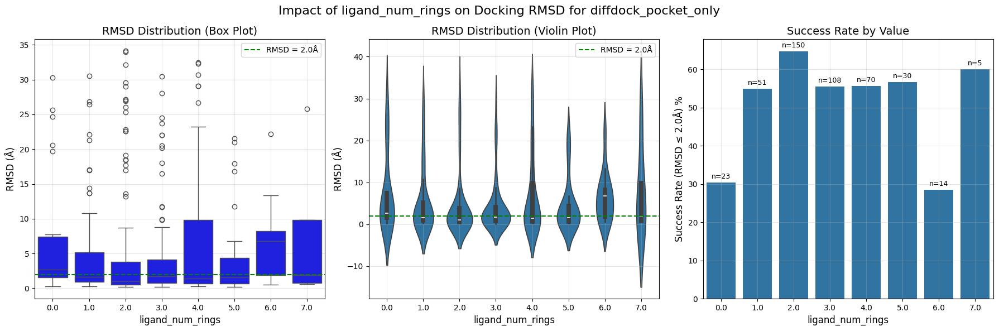


Success rates by discrete value:
  ligand_num_rings  total_count  success_rate  mean_rmsd
0              0.0           23     30.434783   7.483339
1              1.0           51     54.901961   5.587437
2              2.0          150     64.666667   4.666850
3              3.0          108     55.555556   4.280831
4              4.0           70     55.714286   6.927663
5              5.0           30     56.666667   4.620133
6              6.0           14     28.571429   6.458308
7              7.0            5     60.000000   7.758296

ANOVA test: F=1.217, p=0.291489

Impact of entry_resolution on Docking RMSD for diffdock_pocket_only
Pearson correlation: 0.1407, p-value: 0.002757
Spearman correlation: 0.1856, p-value: 0.000073


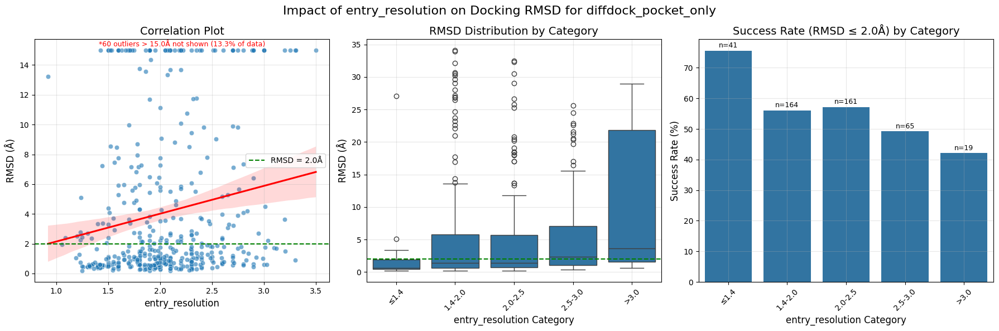


Success rates by category:
  entry_resolution_category  total_count  success_rate  mean_rmsd
0                      ≤1.4           41     75.609756   1.769259
1                   1.4-2.0          164     56.097561   5.569916
2                   2.0-2.5          161     57.142857   4.872248
3                   2.5-3.0           65     49.230769   5.957936
4                      >3.0           19     42.105263  10.592157

ANOVA test: F=4.561, p=0.001279
Significant differences in RMSD across entry_resolution categories

Impact of entry_validation_molprobity on Docking RMSD for diffdock_pocket_only
Pearson correlation: 0.0992, p-value: 0.035253
Spearman correlation: 0.1194, p-value: 0.011151


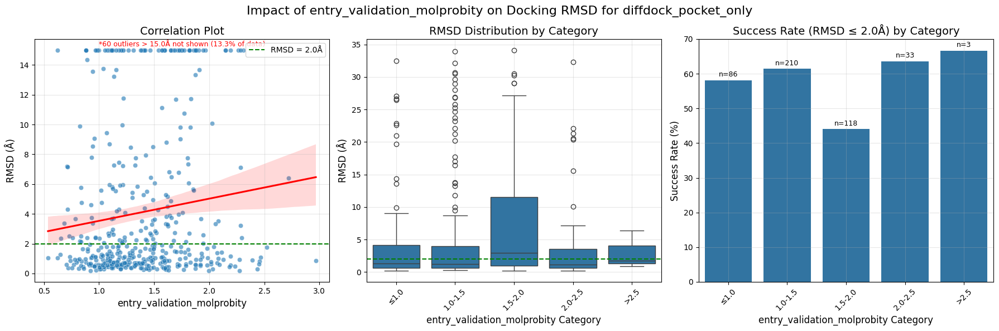


Success rates by category:
  entry_validation_molprobity_category  total_count  success_rate  mean_rmsd
0                                 ≤1.0           86     58.139535   4.473051
1                              1.0-1.5          210     61.428571   4.415961
2                              1.5-2.0          118     44.067797   7.382474
3                              2.0-2.5           33     63.636364   5.422517
4                                 >2.5            3     66.666667   3.005810

ANOVA test: F=3.035, p=0.017323
Significant differences in RMSD across entry_validation_molprobity categories

Impact of system_num_pocket_residues on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.2412, p-value: 0.000000
Spearman correlation: -0.3348, p-value: 0.000000


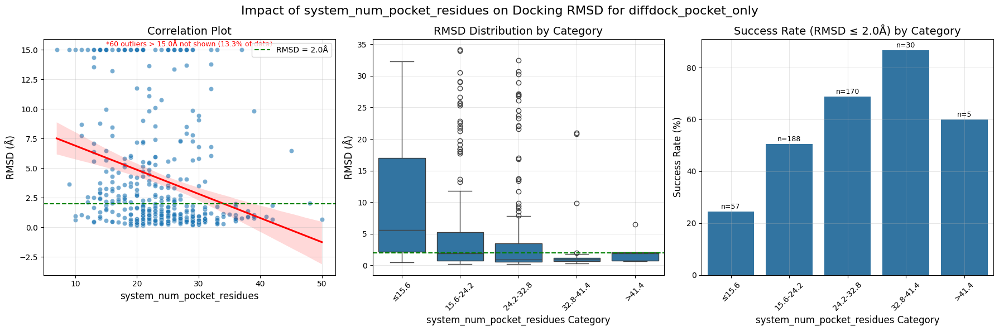


Success rates by category:
  system_num_pocket_residues_category  total_count  success_rate  mean_rmsd
0                               ≤15.6           57     24.561404   9.526866
1                           15.6-24.2          188     50.531915   5.173135
2                           24.2-32.8          170     68.823529   4.335583
3                           32.8-41.4           30     86.666667   2.523669
4                               >41.4            5     60.000000   2.344690

ANOVA test: F=6.179, p=0.000076
Significant differences in RMSD across system_num_pocket_residues categories

Impact of system_num_interactions on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.2275, p-value: 0.000001
Spearman correlation: -0.3108, p-value: 0.000000


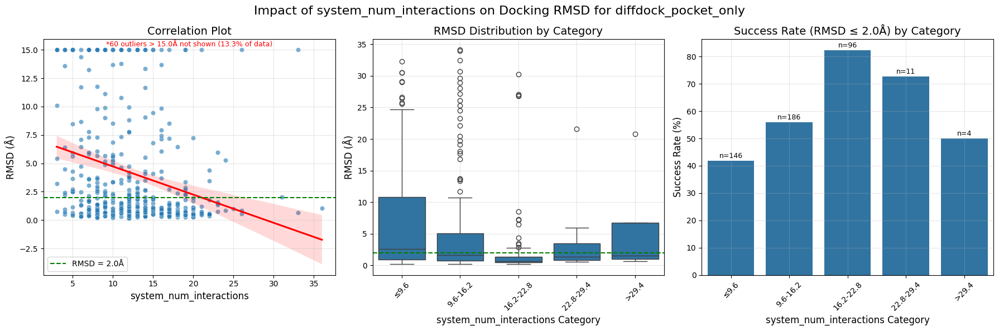


Success rates by category:
  system_num_interactions_category  total_count  success_rate  mean_rmsd
0                             ≤9.6          146     41.780822   7.196248
1                         9.6-16.2          186     55.913978   4.939551
2                        16.2-22.8           96     82.291667   2.341290
3                        22.8-29.4           11     72.727273   3.743440
4                            >29.4            4     50.000000   6.137022

ANOVA test: F=6.038, p=0.000098
Significant differences in RMSD across system_num_interactions categories

Impact of ligand_molecular_weight on Docking RMSD for diffdock_pocket_only
Pearson correlation: 0.0139, p-value: 0.768276
Spearman correlation: 0.0953, p-value: 0.043086


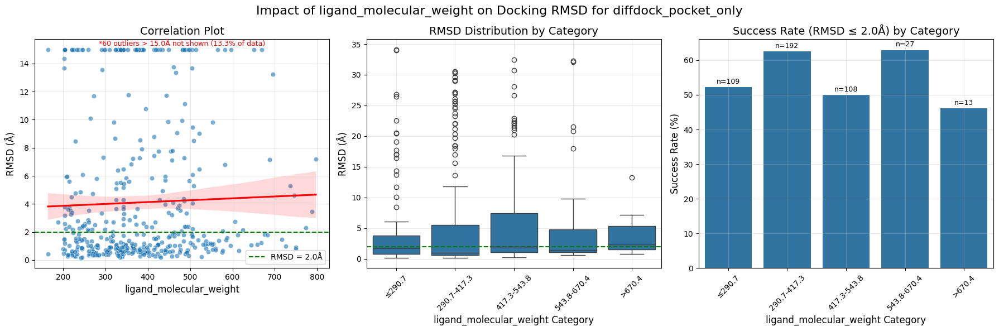


Success rates by category:
  ligand_molecular_weight_category  total_count  success_rate  mean_rmsd
0                           ≤290.7          109     52.293578   4.573941
1                      290.7-417.3          192     62.500000   5.310267
2                      417.3-543.8          108     50.000000   5.732148
3                      543.8-670.4           27     62.962963   6.168351
4                           >670.4           13     46.153846   3.923311

ANOVA test: F=0.481, p=0.749885

Impact of ligand_crippen_clogp on Docking RMSD for diffdock_pocket_only
Pearson correlation: 0.1127, p-value: 0.016614
Spearman correlation: 0.1235, p-value: 0.008632


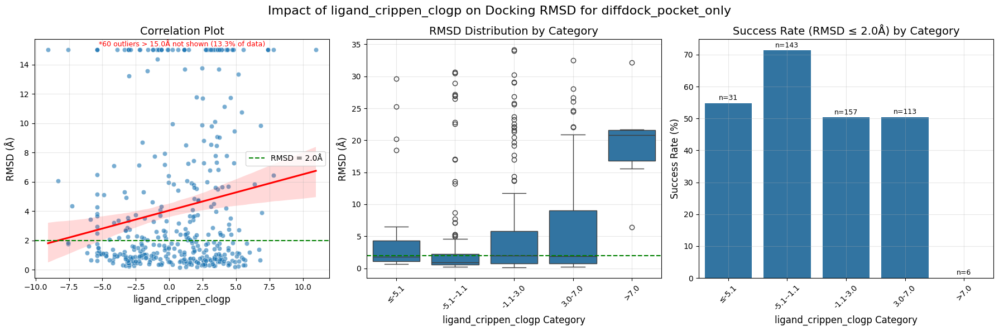


Success rates by category:
  ligand_crippen_clogp_category  total_count  success_rate  mean_rmsd
0                         ≤-5.1           31     54.838710   5.078740
1                     -5.1--1.1          143     71.328671   3.627988
2                      -1.1-3.0          157     50.318471   5.445246
3                       3.0-7.0          113     50.442478   6.118207
4                          >7.0            6      0.000000  19.567788

ANOVA test: F=7.304, p=0.000011
Significant differences in RMSD across ligand_crippen_clogp categories

Impact of ligand_num_interacting_residues on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.2565, p-value: 0.000000
Spearman correlation: -0.3512, p-value: 0.000000


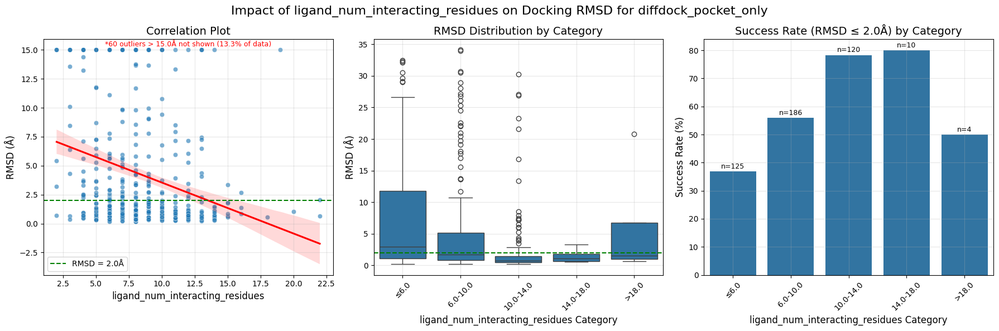


Success rates by category:
  ligand_num_interacting_residues_category  total_count  success_rate  \
0                                     ≤6.0          125     36.800000   
1                                 6.0-10.0          186     55.913978   
2                                10.0-14.0          120     78.333333   
3                                14.0-18.0           10     80.000000   
4                                    >18.0            4     50.000000   

   mean_rmsd  
0   7.845882  
1   5.161931  
2   2.685793  
3   1.440531  
4   6.137022  

ANOVA test: F=7.584, p=0.000006
Significant differences in RMSD across ligand_num_interacting_residues categories

Impact of ligand_num_neighboring_residues on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.2402, p-value: 0.000000
Spearman correlation: -0.3337, p-value: 0.000000


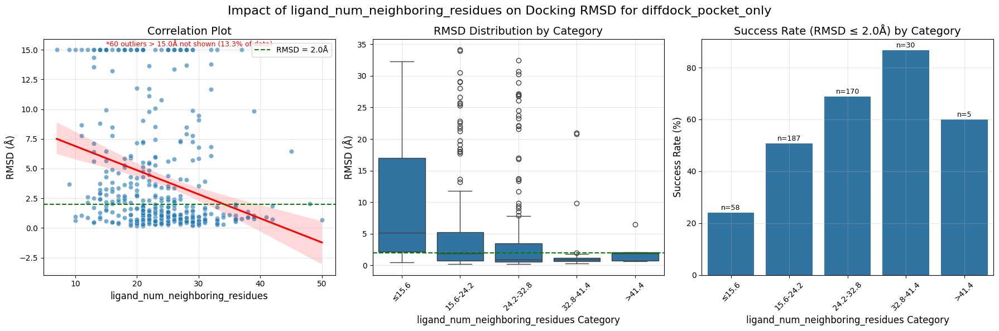


Success rates by category:
  ligand_num_neighboring_residues_category  total_count  success_rate  \
0                                    ≤15.6           58     24.137931   
1                                15.6-24.2          187     50.802139   
2                                24.2-32.8          170     68.823529   
3                                32.8-41.4           30     86.666667   
4                                    >41.4            5     60.000000   

   mean_rmsd  
0   9.436525  
1   5.177873  
2   4.335583  
3   2.523669  
4   2.344690  

ANOVA test: F=6.061, p=0.000093
Significant differences in RMSD across ligand_num_neighboring_residues categories

Impact of ligand_num_interactions on Docking RMSD for diffdock_pocket_only
Pearson correlation: -0.2275, p-value: 0.000001
Spearman correlation: -0.3108, p-value: 0.000000


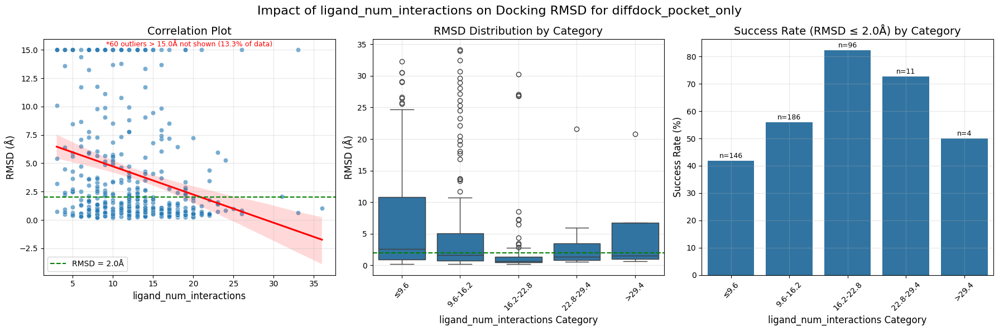


Success rates by category:
  ligand_num_interactions_category  total_count  success_rate  mean_rmsd
0                             ≤9.6          146     41.780822   7.196248
1                         9.6-16.2          186     55.913978   4.939551
2                        16.2-22.8           96     82.291667   2.341290
3                        22.8-29.4           11     72.727273   3.743440
4                            >29.4            4     50.000000   6.137022

ANOVA test: F=6.038, p=0.000098
Significant differences in RMSD across ligand_num_interactions categories


In [30]:
for prop in PLINDER_TEST_COLUMNS[2:]: 
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_single_method(
        "diffdock_pocket_only", prop, prop_type,
    )

### chai-1


Impact of system_num_protein_chains on Docking RMSD for chai-1
Spearman correlation: 0.2774, p-value: 0.000000


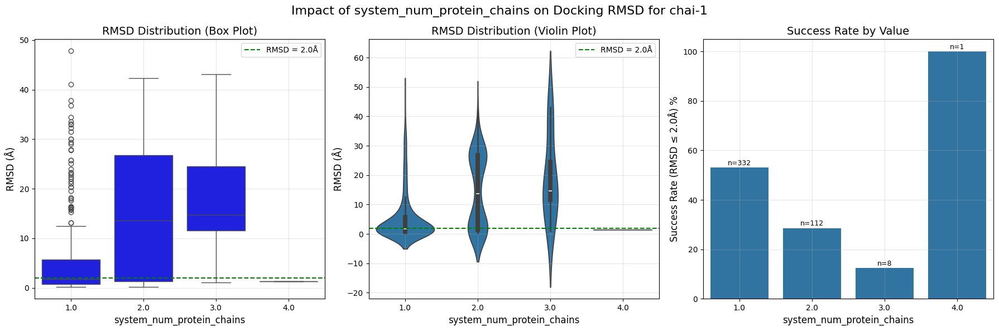


Success rates by discrete value:
  system_num_protein_chains  total_count  success_rate  mean_rmsd
0                       1.0          332     53.012048   5.482326
1                       2.0          112     28.571429  14.490430
2                       3.0            8     12.500000  19.147086
3                       4.0            1    100.000000   1.347653

ANOVA test: F=28.204, p=0.000000
Significant differences in RMSD across system_num_protein_chains values

Impact of ligand_num_rot_bonds on Docking RMSD for chai-1
Pearson correlation: -0.0329, p-value: 0.484286
Spearman correlation: 0.0319, p-value: 0.498695


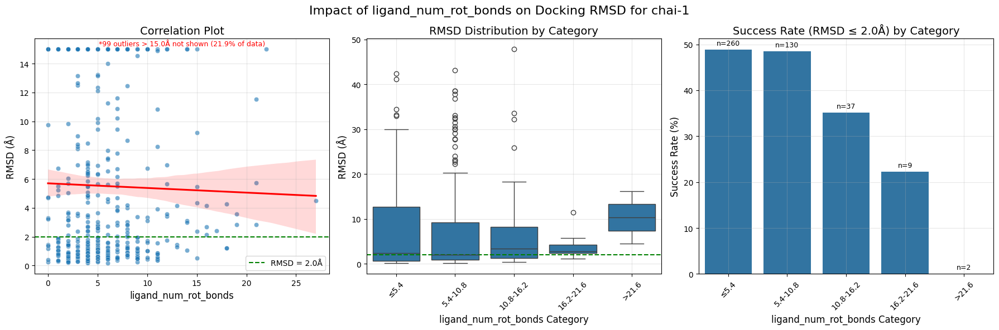


Success rates by category:
  ligand_num_rot_bonds_category  total_count  success_rate  mean_rmsd
0                          ≤5.4          260     48.846154   7.967220
1                      5.4-10.8          130     48.461538   7.877888
2                     10.8-16.2           37     35.135135   7.722279
3                     16.2-21.6            9     22.222222   3.955313
4                         >21.6            2      0.000000  10.369580

ANOVA test: F=0.350, p=0.843692

Impact of ligand_num_hbd on Docking RMSD for chai-1
Pearson correlation: 0.1151, p-value: 0.014265
Spearman correlation: 0.0390, p-value: 0.407912


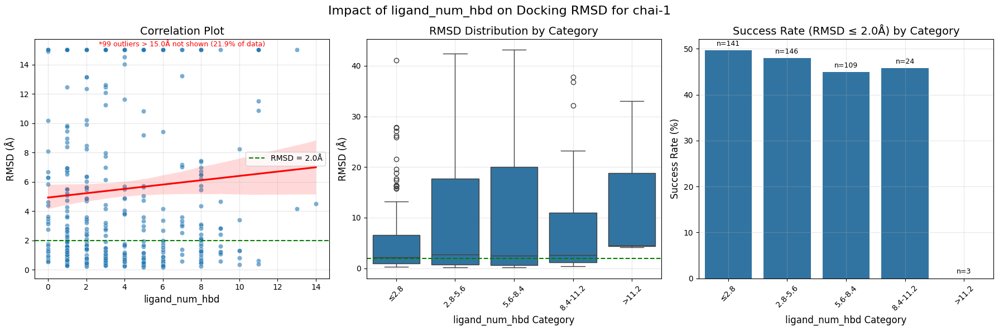


Success rates by category:
  ligand_num_hbd_category  total_count  success_rate  mean_rmsd
0                    ≤2.8          141     49.645390   5.316028
1                 2.8-5.6          146     47.945205   9.282514
2                 5.6-8.4          109     44.954128   9.009714
3                8.4-11.2           24     45.833333   8.479016
4                   >11.2            3      0.000000  13.894749

ANOVA test: F=3.460, p=0.008508
Significant differences in RMSD across ligand_num_hbd categories

Impact of ligand_num_hba on Docking RMSD for chai-1
Pearson correlation: 0.1093, p-value: 0.019927
Spearman correlation: 0.0564, p-value: 0.231005


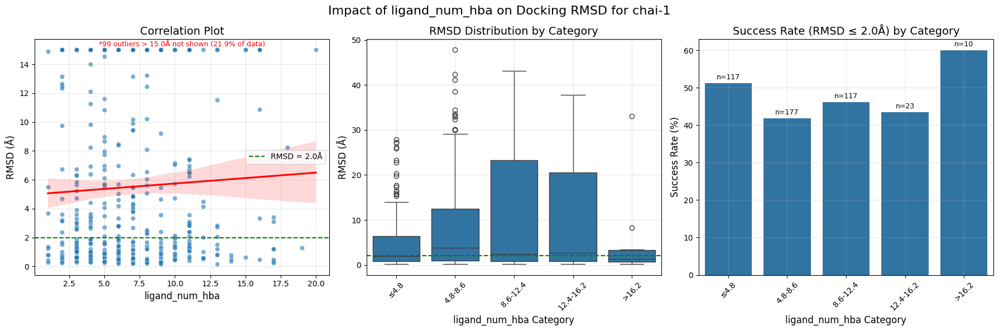


Success rates by category:
  ligand_num_hba_category  total_count  success_rate  mean_rmsd
0                    ≤4.8          117     51.282051   5.439788
1                 4.8-8.6          177     41.807910   8.618782
2                8.6-12.4          117     46.153846   9.476533
3               12.4-16.2           23     43.478261  10.664026
4                   >16.2           10     60.000000   5.258196

ANOVA test: F=3.045, p=0.017060
Significant differences in RMSD across ligand_num_hba categories

Impact of ligand_num_rings on Docking RMSD for chai-1
Spearman correlation: -0.0458, p-value: 0.331211


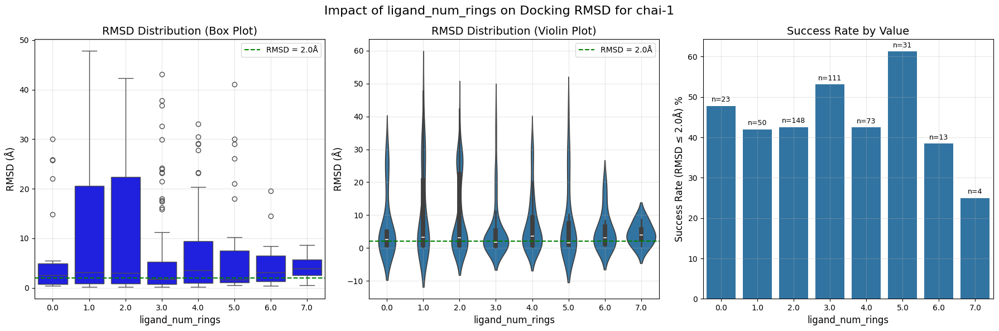


Success rates by discrete value:
  ligand_num_rings  total_count  success_rate  mean_rmsd
0              0.0           23     47.826087   6.821291
1              1.0           50     42.000000  10.945410
2              2.0          148     42.567568   9.856426
3              3.0          111     53.153153   5.507823
4              4.0           73     42.465753   7.051465
5              5.0           31     61.290323   7.182497
6              6.0           13     38.461538   5.291622
7              7.0            4     25.000000   4.274937

ANOVA test: F=2.535, p=0.014442
Significant differences in RMSD across ligand_num_rings values

Impact of entry_resolution on Docking RMSD for chai-1
Pearson correlation: -0.0988, p-value: 0.035448
Spearman correlation: 0.0046, p-value: 0.922935


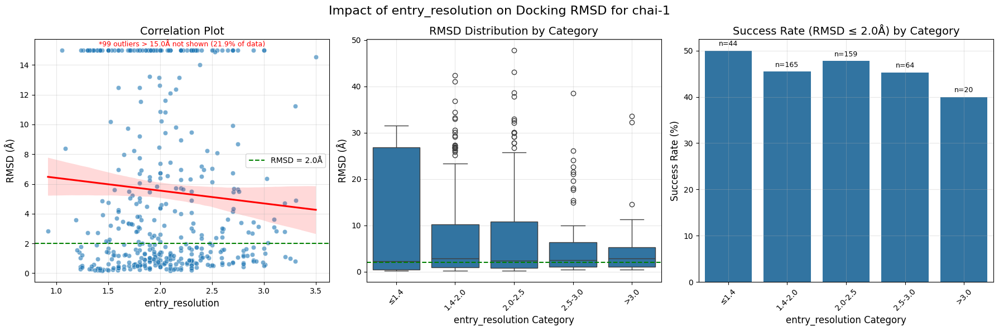


Success rates by category:
  entry_resolution_category  total_count  success_rate  mean_rmsd
0                      ≤1.4           44     50.000000  11.681377
1                   1.4-2.0          165     45.454545   7.962839
2                   2.0-2.5          159     47.798742   7.898843
3                   2.5-3.0           64     45.312500   5.958467
4                      >3.0           20     40.000000   6.482979

ANOVA test: F=2.091, p=0.081008

Impact of entry_validation_molprobity on Docking RMSD for chai-1
Pearson correlation: 0.0331, p-value: 0.482756
Spearman correlation: 0.0807, p-value: 0.086250


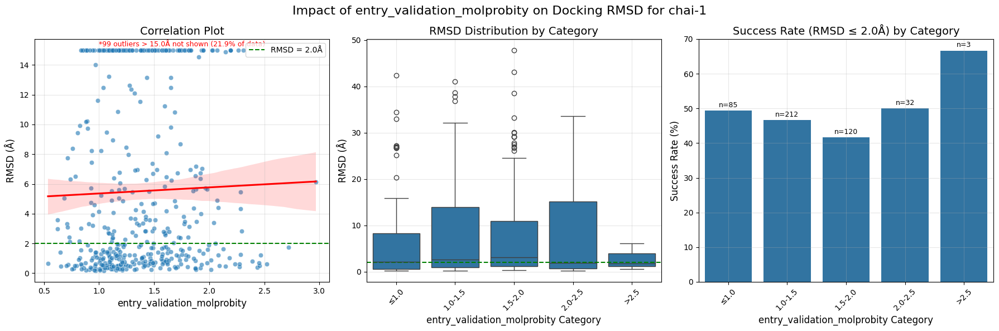


Success rates by category:
  entry_validation_molprobity_category  total_count  success_rate  mean_rmsd
0                                 ≤1.0           85     49.411765   6.504936
1                              1.0-1.5          212     46.698113   8.363993
2                              1.5-2.0          120     41.666667   8.248063
3                              2.0-2.5           32     50.000000   8.519614
4                                 >2.5            3     66.666667   2.819877

ANOVA test: F=0.713, p=0.583499

Impact of system_num_pocket_residues on Docking RMSD for chai-1
Pearson correlation: -0.0901, p-value: 0.055230
Spearman correlation: -0.1204, p-value: 0.010308


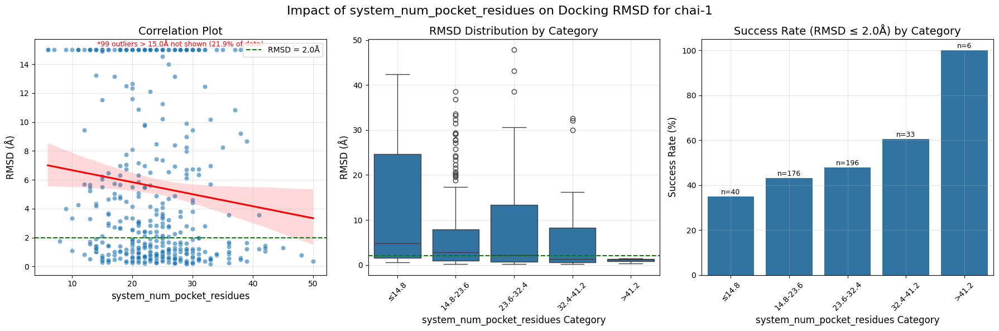


Success rates by category:
  system_num_pocket_residues_category  total_count  success_rate  mean_rmsd
0                               ≤14.8           40     35.000000  12.611368
1                           14.8-23.6          176     43.181818   7.005444
2                           23.6-32.4          196     47.959184   8.221156
3                           32.4-41.2           33     60.606061   5.900086
4                               >41.2            6    100.000000   1.040071

ANOVA test: F=3.428, p=0.008933
Significant differences in RMSD across system_num_pocket_residues categories

Impact of system_num_interactions on Docking RMSD for chai-1
Pearson correlation: -0.0262, p-value: 0.578271
Spearman correlation: -0.1207, p-value: 0.010143


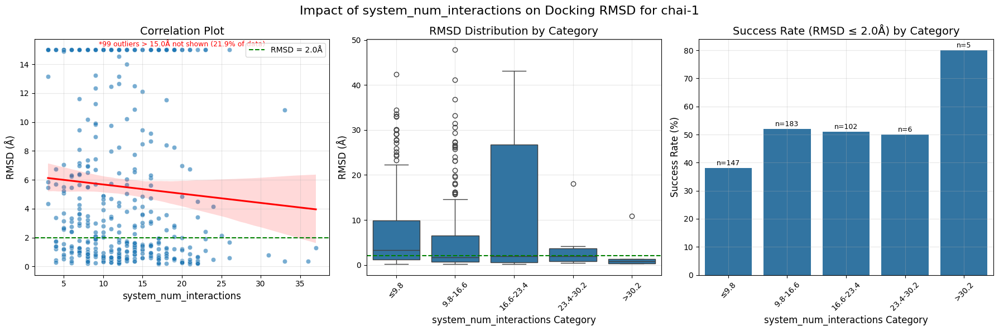


Success rates by category:
  system_num_interactions_category  total_count  success_rate  mean_rmsd
0                             ≤9.8          147     38.095238   7.934087
1                         9.8-16.6          183     51.912568   6.123750
2                        16.6-23.4          102     50.980392  10.558122
3                        23.4-30.2            6     50.000000   4.508830
4                            >30.2            5     80.000000   2.736223

ANOVA test: F=3.559, p=0.007166
Significant differences in RMSD across system_num_interactions categories

Impact of ligand_molecular_weight on Docking RMSD for chai-1
Pearson correlation: -0.0522, p-value: 0.267889
Spearman correlation: 0.0565, p-value: 0.230164


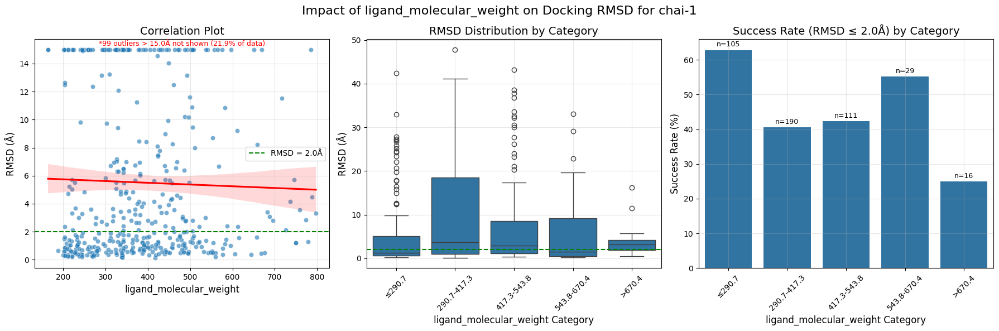


Success rates by category:
  ligand_molecular_weight_category  total_count  success_rate  mean_rmsd
0                           ≤290.7          105     62.857143   5.838383
1                      290.7-417.3          190     40.526316   9.575224
2                      417.3-543.8          111     42.342342   7.527090
3                      543.8-670.4           29     55.172414   6.965190
4                           >670.4           16     25.000000   4.223233

ANOVA test: F=2.909, p=0.021375
Significant differences in RMSD across ligand_molecular_weight categories

Impact of ligand_crippen_clogp on Docking RMSD for chai-1
Pearson correlation: -0.1546, p-value: 0.000964
Spearman correlation: -0.0141, p-value: 0.764146


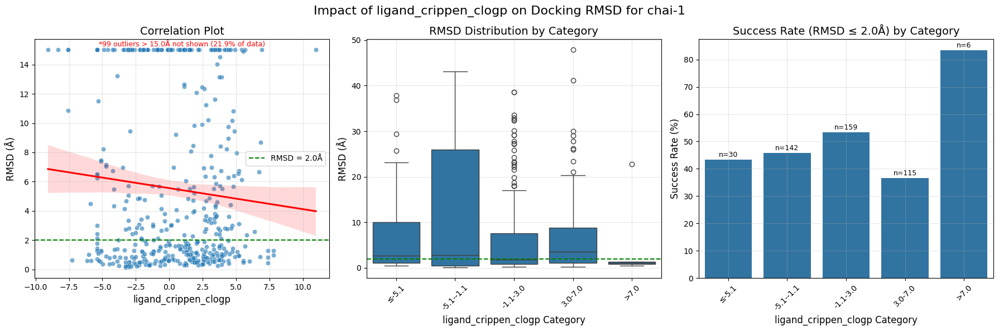


Success rates by category:
  ligand_crippen_clogp_category  total_count  success_rate  mean_rmsd
0                         ≤-5.1           30     43.333333   8.545933
1                     -5.1--1.1          142     45.774648   9.941360
2                      -1.1-3.0          159     53.459119   6.670375
3                       3.0-7.0          115     36.521739   7.028586
4                          >7.0            6     83.333333   4.603069

ANOVA test: F=2.324, p=0.055759

Impact of ligand_num_interacting_residues on Docking RMSD for chai-1
Pearson correlation: -0.0124, p-value: 0.791879
Spearman correlation: -0.1248, p-value: 0.007838


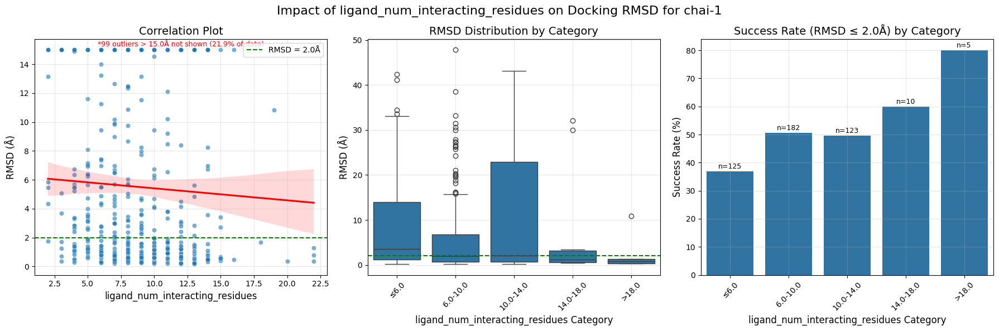


Success rates by category:
  ligand_num_interacting_residues_category  total_count  success_rate  \
0                                     ≤6.0          125     36.800000   
1                                 6.0-10.0          182     50.549451   
2                                10.0-14.0          123     49.593496   
3                                14.0-18.0           10     60.000000   
4                                    >18.0            5     80.000000   

   mean_rmsd  
0   8.898098  
1   6.031389  
2   9.550837  
3   7.268234  
4   2.736223  

ANOVA test: F=2.909, p=0.021375
Significant differences in RMSD across ligand_num_interacting_residues categories

Impact of ligand_num_neighboring_residues on Docking RMSD for chai-1
Pearson correlation: -0.0892, p-value: 0.057765
Spearman correlation: -0.1199, p-value: 0.010618


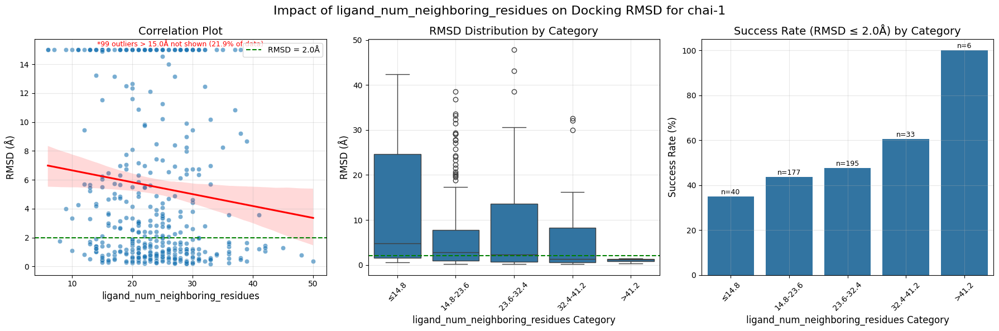


Success rates by category:
  ligand_num_neighboring_residues_category  total_count  success_rate  \
0                                    ≤14.8           40     35.000000   
1                                14.8-23.6          177     43.502825   
2                                23.6-32.4          195     47.692308   
3                                32.4-41.2           33     60.606061   
4                                    >41.2            6    100.000000   

   mean_rmsd  
0  12.611368  
1   6.970445  
2   8.259159  
3   5.900086  
4   1.040071  

ANOVA test: F=3.469, p=0.008331
Significant differences in RMSD across ligand_num_neighboring_residues categories

Impact of ligand_num_interactions on Docking RMSD for chai-1
Pearson correlation: -0.0262, p-value: 0.578271
Spearman correlation: -0.1207, p-value: 0.010143


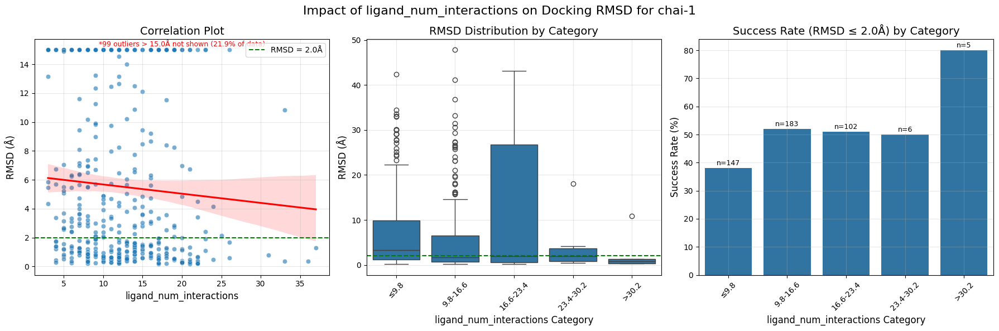


Success rates by category:
  ligand_num_interactions_category  total_count  success_rate  mean_rmsd
0                             ≤9.8          147     38.095238   7.934087
1                         9.8-16.6          183     51.912568   6.123750
2                        16.6-23.4          102     50.980392  10.558122
3                        23.4-30.2            6     50.000000   4.508830
4                            >30.2            5     80.000000   2.736223

ANOVA test: F=3.559, p=0.007166
Significant differences in RMSD across ligand_num_interactions categories


In [31]:
for prop in PLINDER_TEST_COLUMNS[2:]: 
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_single_method(
        "chai-1", prop, prop_type,
    )

## Universal Analysis

Analyzing system_num_protein_chains for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of discrete property 'system_num_protein_chains':
Categories: [1.0, 2.0]
Counts (success vs failure):
  system_num_protein_chains  success_count  failure_count
0                       1.0            315             45
1                       2.0             70              5
Chi-square test: statistic=1.542, p-value=0.214273


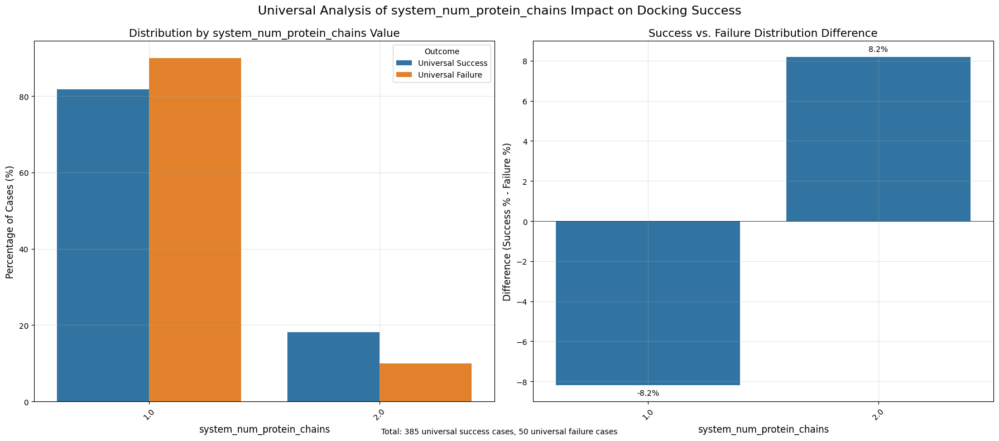

Analyzing ligand_num_rot_bonds for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'ligand_num_rot_bonds':
Success cases: n=385, mean=5.195, std=2.781
Failure cases: n=50, mean=12.600, std=4.870
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 2.397
Chi-square test for distribution: p=0.000000


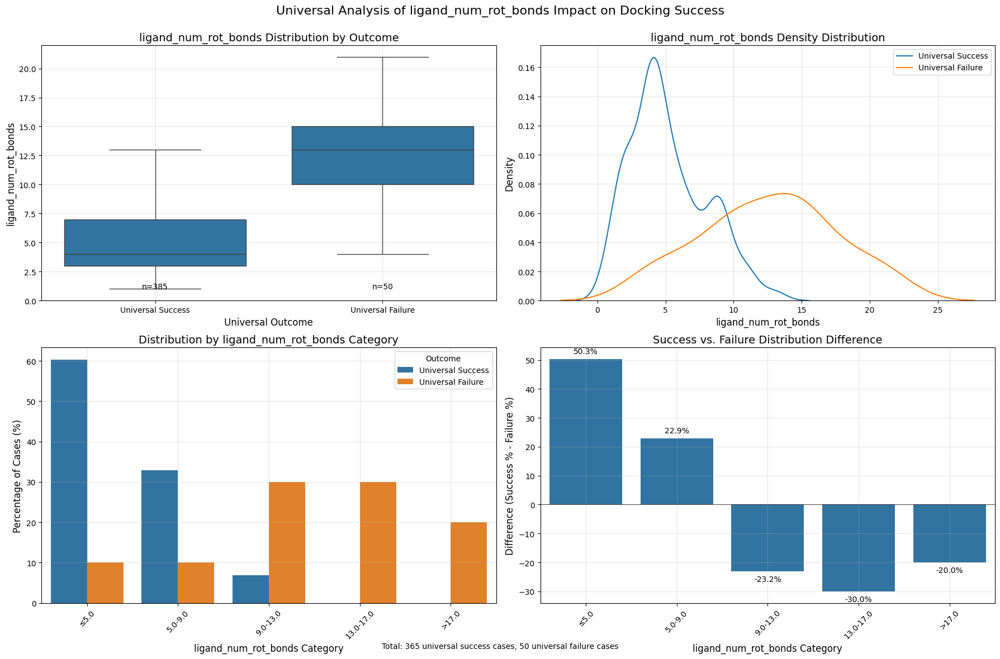

Analyzing ligand_num_hbd for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'ligand_num_hbd':
Success cases: n=385, mean=4.039, std=2.481
Failure cases: n=50, mean=6.100, std=3.012
Mann-Whitney U test: p=0.000001
Effect size (Cohen's d): 0.809
Chi-square test for distribution: p=0.000000


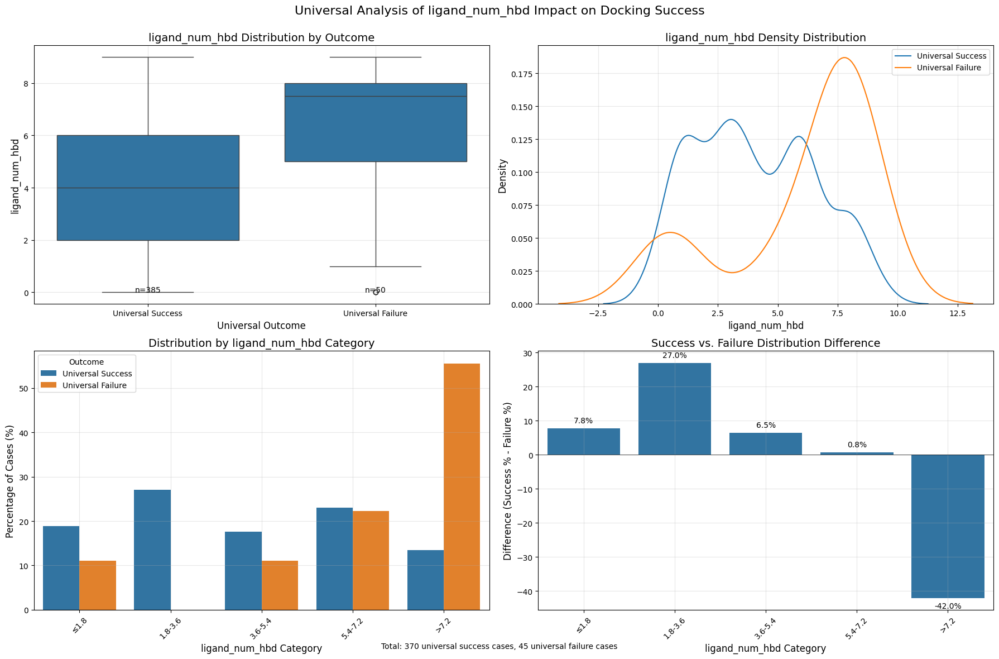

Analyzing ligand_num_hba for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'ligand_num_hba':
Success cases: n=385, mean=7.286, std=3.468
Failure cases: n=50, mean=8.600, std=3.591
Mann-Whitney U test: p=0.007115
Effect size (Cohen's d): 0.377
Chi-square test for distribution: p=0.045190


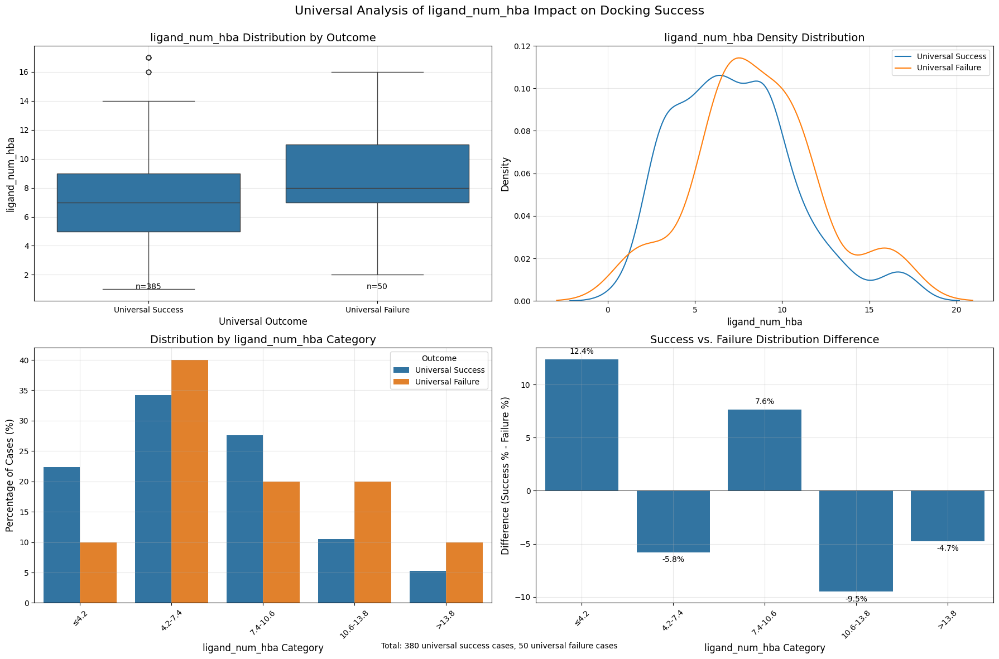

Analyzing ligand_num_rings for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of discrete property 'ligand_num_rings':
Categories: [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0]
Counts (success vs failure):
  ligand_num_rings  success_count  failure_count
0              0.0             20             15
1              1.0             30             10
2              2.0            125             20
3              3.0            100              0
4              4.0             60              0
5              5.0             40              0
6              6.0             10              5
Chi-square test: statistic=74.773, p-value=0.000000
Significant distribution difference between success and failure groups.


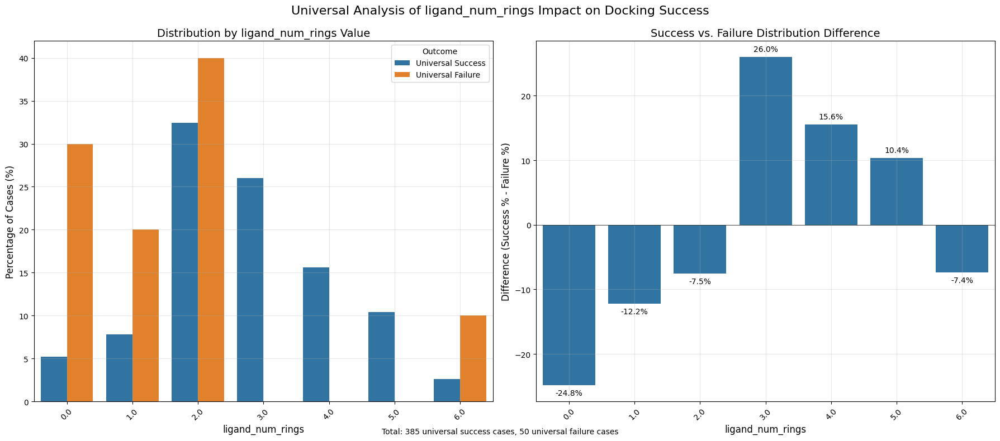

Analyzing entry_resolution for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'entry_resolution':
Success cases: n=385, mean=2.111, std=0.461
Failure cases: n=50, mean=2.204, std=0.489
Mann-Whitney U test: p=0.386198
Effect size (Cohen's d): 0.200
Chi-square test for distribution: p=0.224151


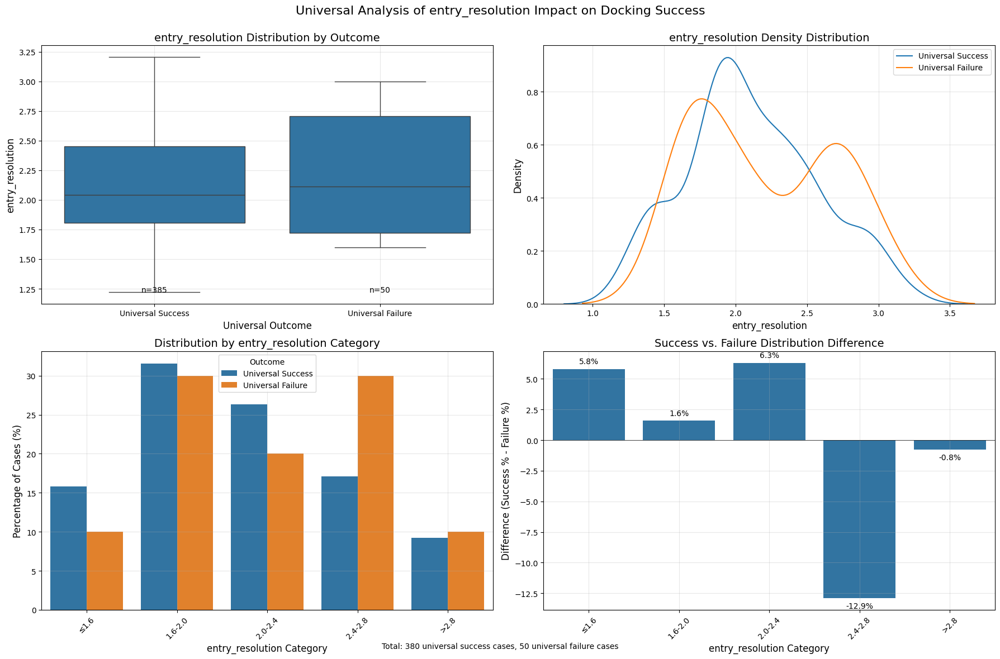

Analyzing entry_validation_molprobity for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'entry_validation_molprobity':
Success cases: n=385, mean=1.327, std=0.441
Failure cases: n=50, mean=1.408, std=0.612
Mann-Whitney U test: p=0.654274
Effect size (Cohen's d): 0.175
Chi-square test for distribution: p=0.000000


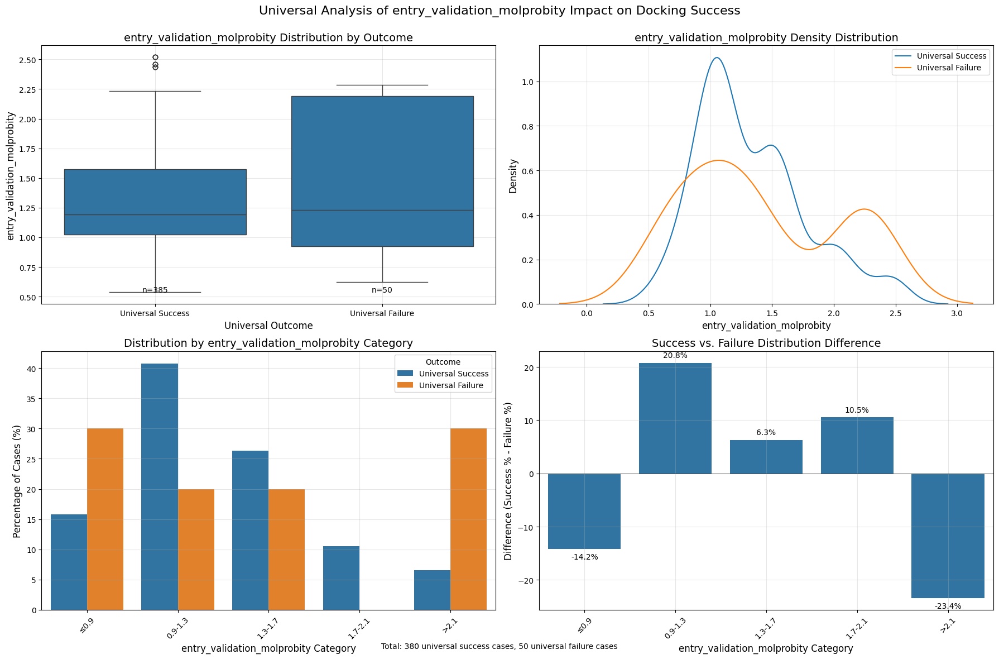

Analyzing system_num_pocket_residues for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'system_num_pocket_residues':
Success cases: n=385, mean=27.195, std=5.667
Failure cases: n=50, mean=15.500, std=4.339
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 2.114
Chi-square test for distribution: p=0.000000


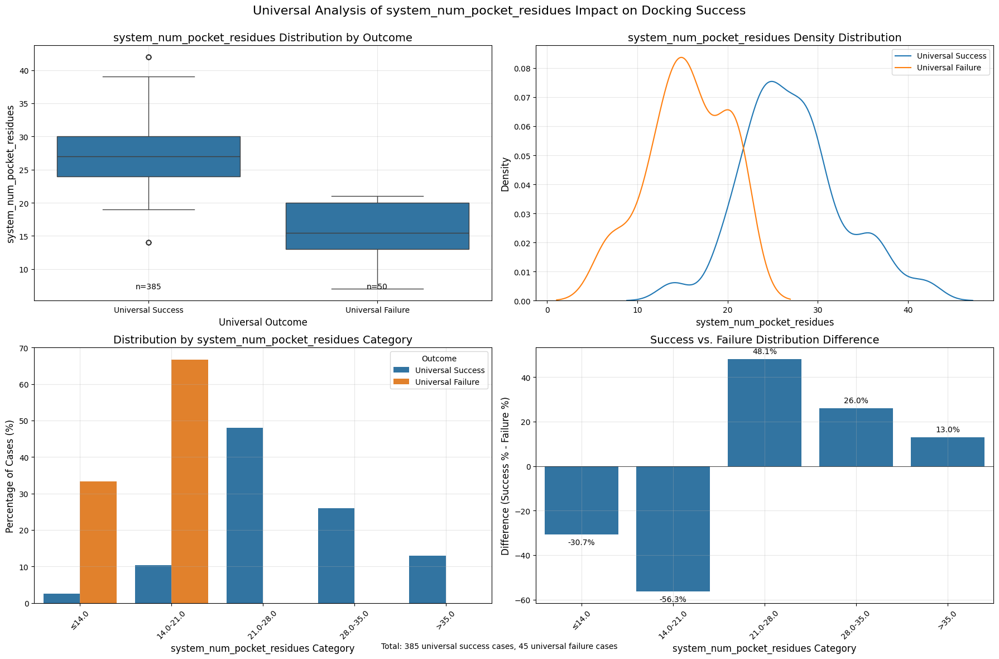

Analyzing system_num_interactions for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'system_num_interactions':
Success cases: n=385, mean=14.623, std=4.871
Failure cases: n=50, mean=7.900, std=4.225
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 1.400
Chi-square test for distribution: p=0.000000


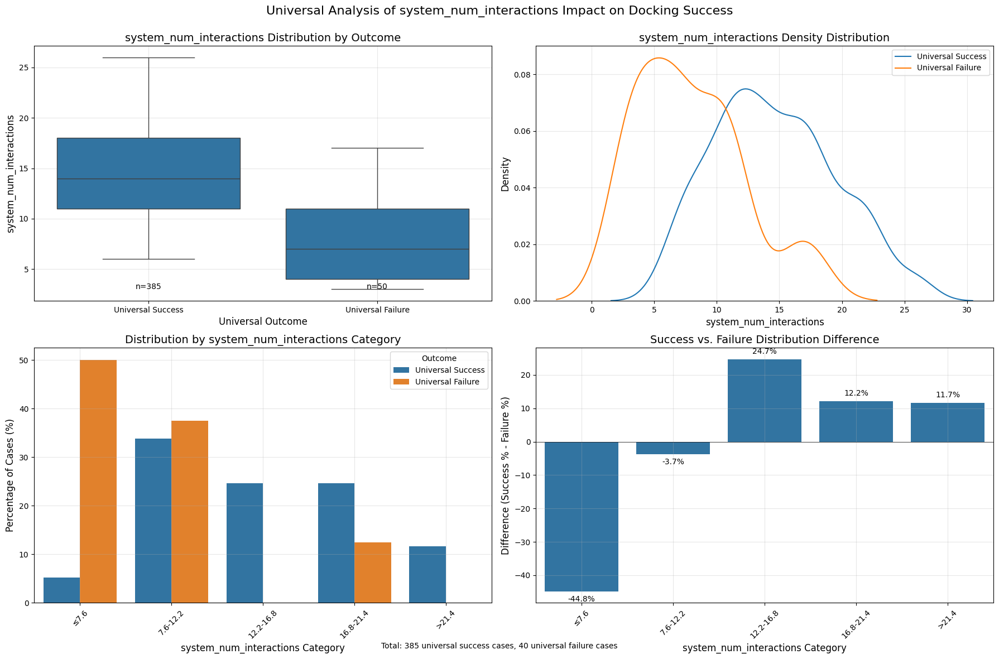

Analyzing ligand_molecular_weight for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'ligand_molecular_weight':
Success cases: n=385, mean=373.008, std=105.020
Failure cases: n=50, mean=516.628, std=139.116
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 1.313
Chi-square test for distribution: p=0.000000


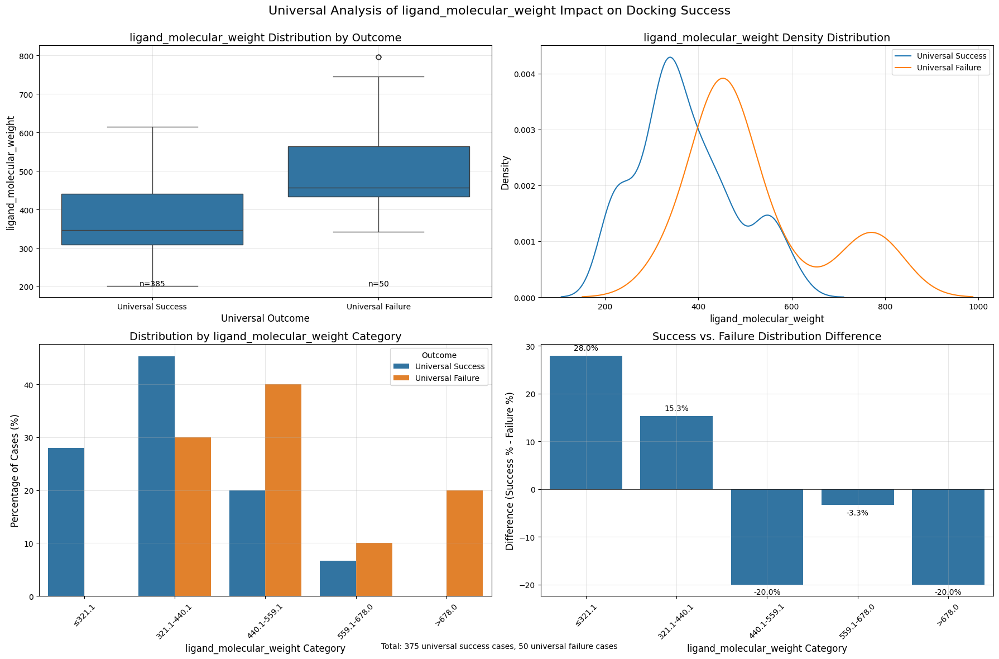

Analyzing ligand_crippen_clogp for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'ligand_crippen_clogp':
Success cases: n=385, mean=-0.014, std=3.549
Failure cases: n=50, mean=-0.510, std=4.592
Mann-Whitney U test: p=0.042067
Effect size (Cohen's d): 0.135
Chi-square test for distribution: p=0.000000


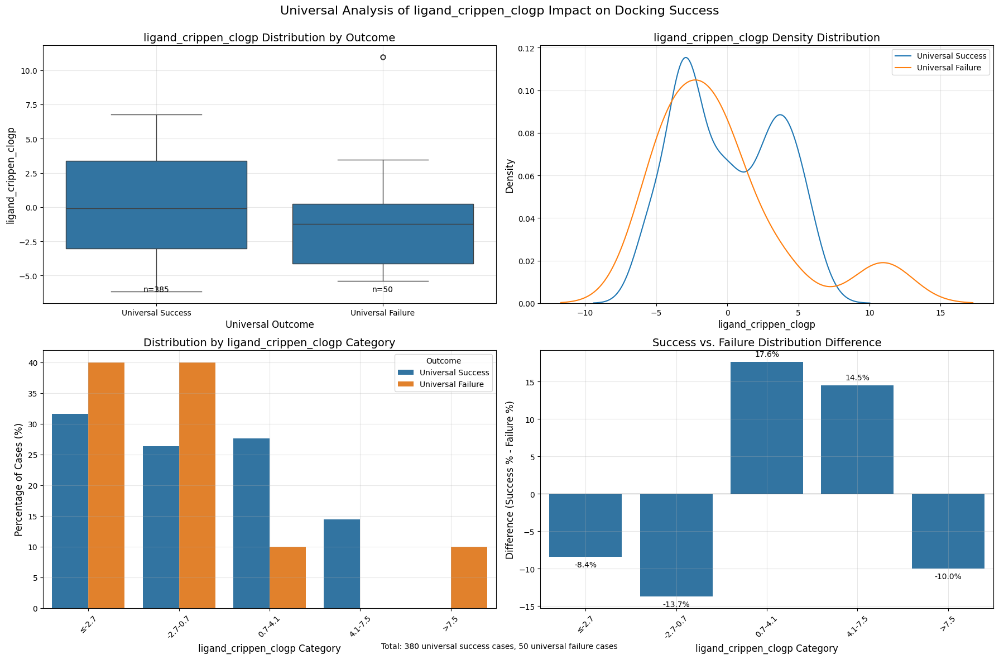

Analyzing ligand_num_interacting_residues for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'ligand_num_interacting_residues':
Success cases: n=385, mean=10.260, std=2.920
Failure cases: n=50, mean=6.000, std=2.821
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 1.464
Chi-square test for distribution: p=0.000000


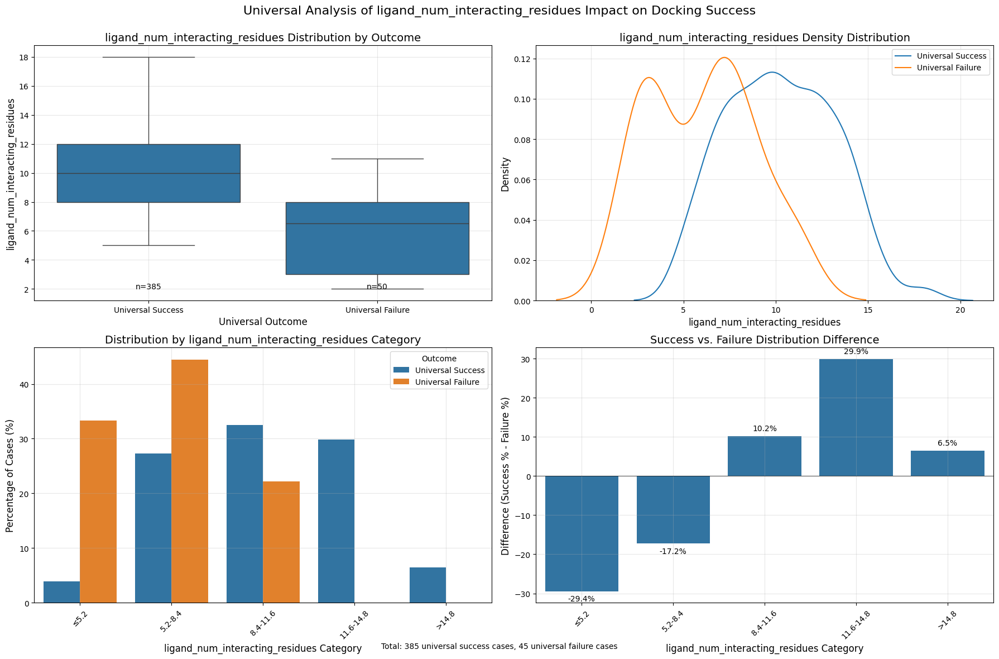

Analyzing ligand_num_neighboring_residues for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'ligand_num_neighboring_residues':
Success cases: n=385, mean=27.195, std=5.667
Failure cases: n=50, mean=15.500, std=4.339
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 2.114
Chi-square test for distribution: p=0.000000


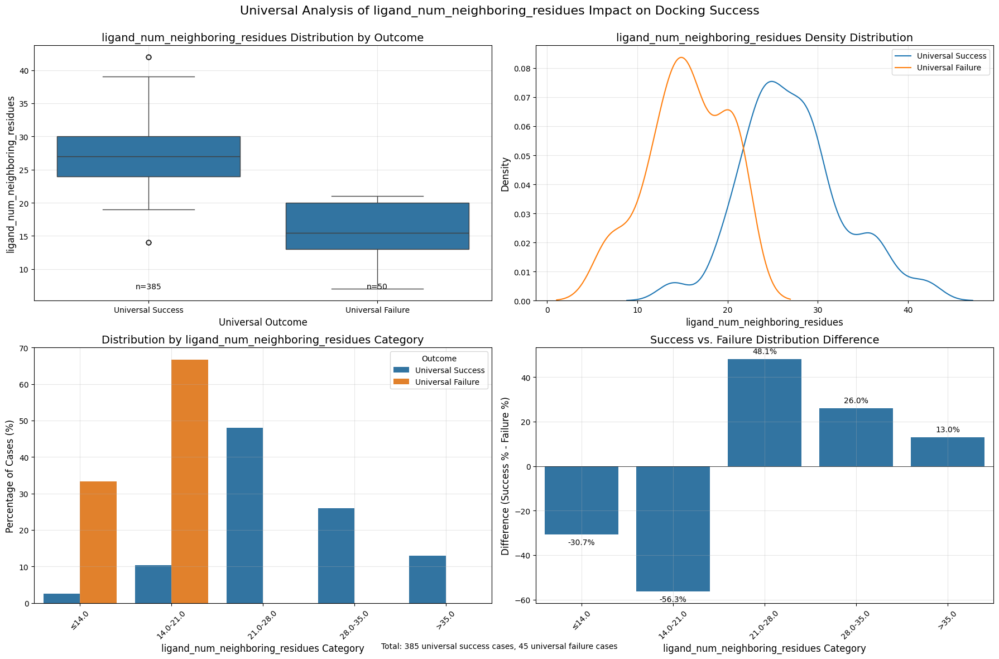

Analyzing ligand_num_interactions for 77 cases where all methods succeed
and 10 cases where all methods fail

Universal analysis of continuous property 'ligand_num_interactions':
Success cases: n=385, mean=14.623, std=4.871
Failure cases: n=50, mean=7.900, std=4.225
Mann-Whitney U test: p=0.000000
Effect size (Cohen's d): 1.400
Chi-square test for distribution: p=0.000000


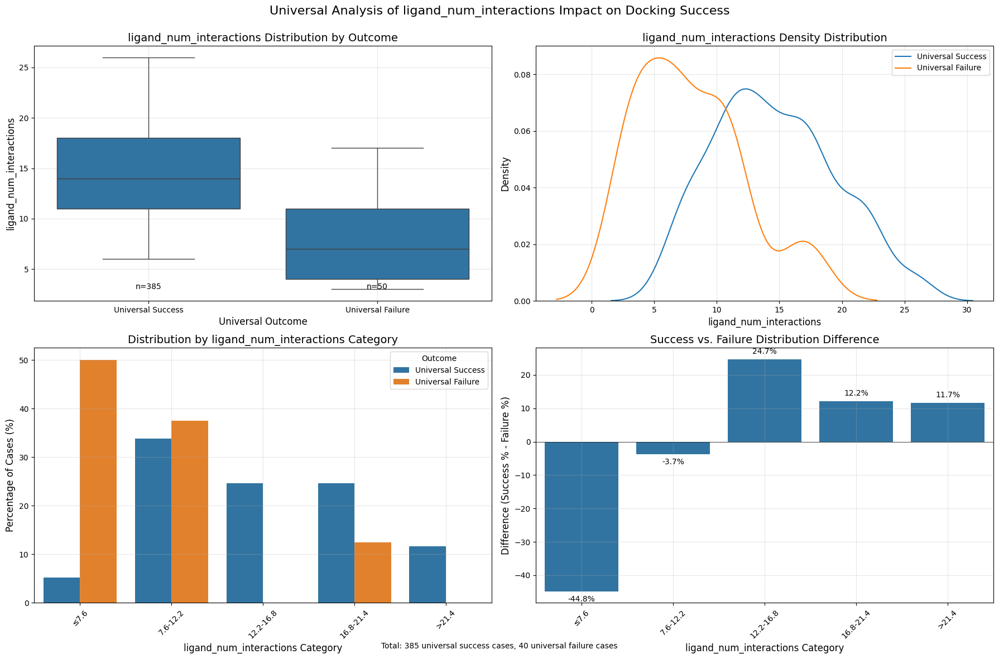

In [7]:
# First analyze multiple properties
property_analysis = PropertyAnalysis(df_combined)
methods = ["surfdock", "gnina", "chai-1", "diffdock_pocket_only", "icm"]

all_results = []

for prop in PLINDER_TEST_COLUMNS[2:]:
    # 2. Explore impact of properties on a single method
    prop_type = CATEGORY_MAPPING[prop]
    prop_analysis = property_analysis.analyze_property_universal(
        methods, prop, prop_type,
    )
    all_results.append(prop_analysis)



### Plotting universal

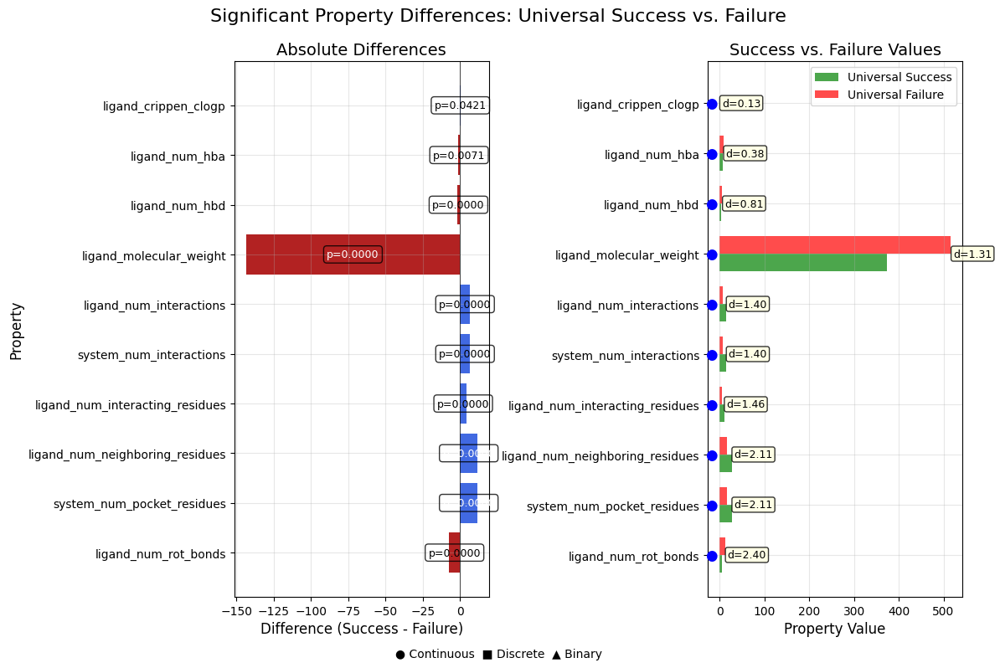

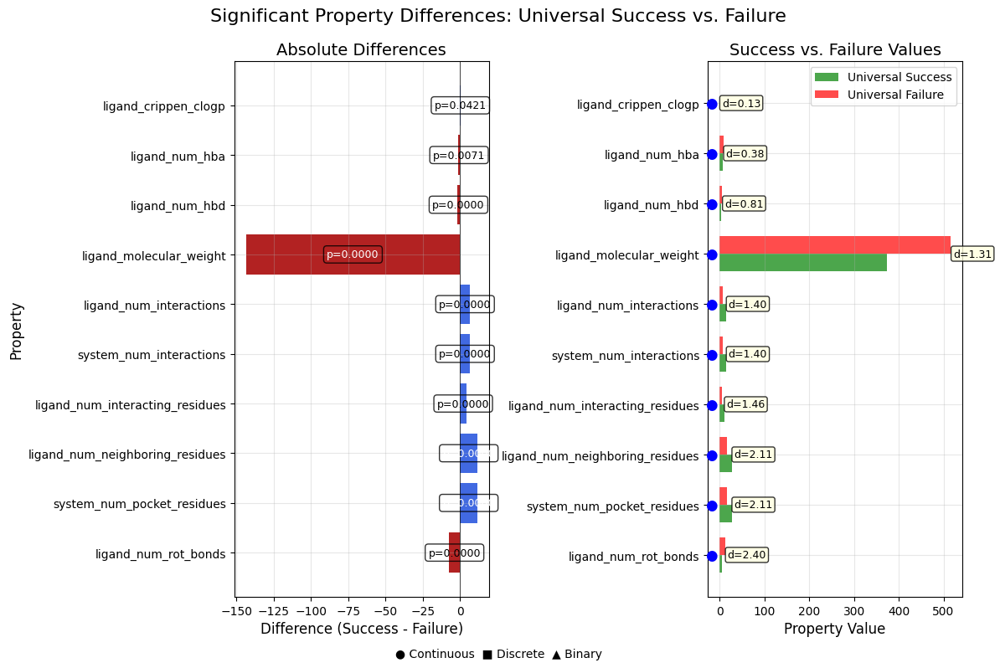

In [8]:
# Plot significant differences 
property_analysis.plot_significant_property_differences(
    all_results, 
    p_threshold=0.05,
    sort_by='effect_size'
)